<a href="https://colab.research.google.com/github/anto11preve/LL2Project/blob/master/LL2_Prevedello_Antonio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Breve riassunto dei vari df_CP:
* senza numero è l'originale
* 2: ho eliminato entry che avevano il file con le serie temporali corrispondente al giorno dlla prova ma tale file era vuoto (1 entry)
* 3: ho eliminato entry che NON avevano il corrispetivo file  con le serie temporali
* 4: ho eliminato le entry che nel corrispettivo file NON avevano le ore di nostro interesse
* 5 ho eliminato le entry con file nelle ore di interesse ma con tutti i valori non validi

#Import e Subfunctions

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/LL2
%ls

/content/drive/MyDrive/LL2
all_files.pkl                  extracted_series.pkl       Processed/
best_lstm_model.pth            extracted_series_raw.pkl   Refernce.gdoc
copied_files.pkl               full_inference_series.pkl  rescaled_series.pkl
df_CP_2.xlsx                   lstm_results.png           Working_Area/
df_CP.xlsx                     missing_df.xlsx
extracted_series_mid_gaps.pkl  not_found_files.pkl


In [ ]:
import pandas as pd
import shutil
import os
import numpy as np
import re
import pickle #serialization of objects for disk saving
from datetime import datetime, timedelta
import random
import matplotlib.pyplot as plt
from tqdm import tqdm
from statsmodels.tsa.stattools import adfuller, kpss #statistical test for stationarity
from scipy.stats import boxcox  #transformation for getting variance costant thorugh time
from scipy.special import inv_boxcox
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf  #(partial) autocorrelation function
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.stattools import acf, pacf
import plotly.graph_objects as go
from scipy import signal
import ast  #useful to convert stings rappresenting lists saved in an excel to actual lists
import time

#pytorch
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

In [ ]:
if(not torch.cuda.is_available()):
  print("WARNING: CUDA NOT AVAILABLE")
else:
  print("CUDA AVAILABLE")

CUDA AVAILABLE


In [ ]:
base_path = '/content/drive/MyDrive/LL2/Processed/' #path of folder containing all timeseries files
ground_path = '/content/drive/MyDrive/LL2/df_CP.xlsx'
time_series_folder = '/content/drive/MyDrive/LL2/Working_Area/Time_Series/'

columns_name=['heart_rate_data', 'respiration_data', 'stress_data']


ground_df=pd.read_excel(ground_path)  #contains the file with all original ground truths
df_CP_3=pd.read_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_3.xlsx')  #contains ground truths that have a non empy corrispondig time-series file
df_CP_4=pd.read_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_4.xlsx')  #contains ground truths that have a corrispondig time-series file, with all timestamps in previous 8h
df_CP_5=pd.read_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_5_listlike.xlsx')  #contains ground truths that have a corrispondig time-series file, with most timestamps not NaN in previous 8h
missing_df=pd.read_excel('/content/drive/MyDrive/LL2/missing_df.xlsx')  #contains files with missing timeseries

#load files name actually
with open('/content/drive/MyDrive/LL2/copied_files.pkl', 'rb') as f:
  working_files = pickle.load(f)

#load files name that rappresents the day of a test for a user but were not present
with open('/content/drive/MyDrive/LL2/not_found_files.pkl', 'rb') as f:
  not_found_files = pickle.load(f)

#load all files name
with open('/content/drive/MyDrive/LL2/all_files.pkl', 'rb') as f:
  all_files = pickle.load(f)

#raw series extracted (have some missing timeseries values)
with open('/content/drive/MyDrive/LL2/extracted_series_raw.pkl', 'rb') as f:
  extracted_series_raw = pickle.load(f)

with open('/content/drive/MyDrive/LL2/extracted_series.pkl', 'rb') as f:
  extracted_series = pickle.load(f)

with open('/content/drive/MyDrive/LL2/extracted_series_mid_gaps.pkl', 'rb') as f:
  extracted_series_mid_gaps = pickle.load(f)


with open('/content/drive/MyDrive/LL2/full_inference_series.pkl', 'rb') as f:
  full_inference_series = pickle.load(f)

with open('/content/drive/MyDrive/LL2/rescaled_series.pkl', 'rb') as f:
  rescaled_series = pickle.load(f)

##Subfunctions

###Visualization

In [ ]:
def plot_single_time_series(df, data_column="placeholder", title=None):
    """
    Plots a time series with negative values highlighted.

    This function takes a pandas DataFrame containing timestamp and data values,
    and plots the time series. Negative values are highlighted in red.

    Args:
        df (pd.DataFrame): DataFrame containing 'timestamp' and data_column columns.
        data_column (str): Name of the column containing the data to plot.
        title (str, optional): Title for the plot. Defaults to 'Time Series - data_column'.

    Returns:
        None: Displays the plot using matplotlib.pyplot.show().
    """

    if data_column == "placeholder":
        data_column=df.columns[1]

    # Extract timestamps and data values from the DataFrame.
    timestamps = df['timestamp']
    values = df[data_column]

    # Create a new figure for the plot with a specific size (12x5).
    plt.figure(figsize=(12, 5))

    # Plot the main time series data with a blue line and label.
    plt.plot(timestamps, values, label='Values', color='blue')

    # Set labels for the x and y axes.
    plt.xlabel('Timestamp')
    plt.ylabel(data_column)

    # Set the title of the plot, using the provided title or a default.
    plt.title(title if title else f'Time Series - {data_column}')

    # Display a legend to explain the plot elements (lines and scatter points).
    plt.legend()

    # Add a grid to the plot for better readability.
    plt.grid(True)

    # Adjust the plot layout to prevent overlapping elements.
    plt.tight_layout()

    # Display the plot using matplotlib.pyplot.show().
    plt.show()

In [ ]:
def plot_time_series_with_negatives(df, data_column="placeholder", title=None):
    """
    Plots a time series with negative values highlighted.

    This function takes a pandas DataFrame containing timestamp and data values,
    and plots the time series. Negative values are highlighted in red.

    Args:
        df (pd.DataFrame): DataFrame containing 'timestamp' and data_column columns.
        data_column (str): Name of the column containing the data to plot.
        title (str, optional): Title for the plot. Defaults to 'Time Series - data_column'.

    Returns:
        None: Displays the plot using matplotlib.pyplot.show().
    """

    if data_column == "placeholder":
        data_column=df.columns[1]

    # Extract timestamps and data values from the DataFrame.
    timestamps = df['timestamp']
    values = df[data_column]

    # Create a mask to identify negative values in the data.
    negative_mask = values < 0
    isolated_points=mask_isolated_points(df[data_column], 2)

    # Create a new figure for the plot with a specific size (12x5).
    plt.figure(figsize=(12, 5))

    # Plot the main time series data with a blue line and label.
    plt.plot(timestamps, values, label='Values', color='blue')

    # Highlight negative values using red scatter points and a label.
    plt.scatter(timestamps[negative_mask], values[negative_mask], color='red', label='Values < 0')

    #plt.scatter(timestamps[isolated_points], values[isolated_points], color='green', label='Isolated Points')
    plt.scatter(timestamps[isolated_points], values[isolated_points],
            color='green', label='Isolated Points', s=50, marker='x', zorder=3)

    # Set labels for the x and y axes.
    plt.xlabel('Timestamp')
    plt.ylabel(data_column)

    # Set the title of the plot, using the provided title or a default.
    plt.title(title if title else f'Time Series - {data_column}')

    # Display a legend to explain the plot elements (lines and scatter points).
    plt.legend()

    # Add a grid to the plot for better readability.
    plt.grid(True)

    # Adjust the plot layout to prevent overlapping elements.
    plt.tight_layout()

    # Display the plot using matplotlib.pyplot.show().
    plt.show()

In [ ]:
def three_series_plotter(series, index, num=7):
  """
  Plots time series data for heart rate, respiration, and stress.

  This function takes a list of time series data, an index to select a specific series,
  and a number to control which plots to display.

  Args:
    series (list): A list of tuples, where each tuple contains heart rate, respiration,
                    and stress data series as pandas DataFrames.
    index (int): The index of the series to plot.
    num (int, optional): A number used to control which plots are displayed.
                        The number is interpreted as a bitmask:
                        - 1: Plot stress data.
                        - 2: Plot respiration data.
                        - 4: Plot heart rate data.
                        Defaults to 7, which plots all three types of data.

  Returns:
    None: The function displays the plots but does not return any value.

  """
  if num>7:
    return

  if num>=4:
    plot_time_series_with_negatives(series[index][0], 'heart_rate_data')
    num-=4
  if num>=2:
    plot_time_series_with_negatives(series[index][1], 'respiration_data')
    num-=2
  if num>=1:
    plot_time_series_with_negatives(series[index][2], 'stress_data')


In [ ]:
def display_negative_values_percentage(series, h=8, display_threshold=0):
  '''
  This function calculates and displays the percentage of missing values (represented by
  negative values) in the last h hours of each heart rate, respiration, and stress data
  series within a list of series. It also calculates and prints the average percentage
  of missing values for each data type across all series. A warning is printed if
  the percentage of missing values for any data type in a series exceeds 75%.

  Args:
      series (list): A list of tuples, where each tuple contains heart rate, respiration,
                      and stress data series as pandas DataFrames.
      h (int, optional): The number of hours to consider for calculating the percentage
                          of missing values. Defaults to 8.

  Returns:
      None: The function prints the results but does not return any value.
  '''
  percentuali_negativi = []
  dispidx=[]
  idx=0
  for hr, resp, stress in series:
      perc_hr = ((hr.iloc[int(-30*h):])['heart_rate_data'] < 0).mean() * 100
      perc_resp = ((resp.iloc[int(-30*h) :])['respiration_data'] < 0).mean() * 100
      perc_stress = ((stress.iloc[int(-20*h):])['stress_data'] < 0).mean() * 100
      if(perc_hr>75 or perc_resp>75 or perc_stress>75):
        print("*Warning*:")
      if(perc_hr>=display_threshold or perc_resp>=display_threshold or perc_stress>=display_threshold):
        print(f"{idx:>3}: {perc_hr:>6.2f}| {perc_resp:>6.2f}| {perc_stress:>6.2f}")
        dispidx.append(idx)
      idx+=1
      percentuali_negativi.append((perc_hr, perc_resp, perc_stress))
  print('_'*26)
  percentuali_negativi=np.array(percentuali_negativi)
  means=percentuali_negativi.mean(axis=0)
  print(f'avg: {means[0]:>6.2f}| {means[1]:>6.2f}| {means[2]:>6.2f}')
  return dispidx

In [ ]:
def display_longest_gaps(series, display_threshold=0, warn=3):
  '''
  This function calculates and displays the longest consecutive NaN gaps (in hours) for each
  heart rate, respiration, and stress data series within a list of series.
  It also prints a warning if any gap exceeds a specified threshold.

  Args:
    series (list): A list of tuples containing heart rate, respiration, and stress data series.
    display (float): The minimum gap length (in hours) to display.
    warn (float): The gap length (in hours) to trigger a warning.

  Returns:
    indexes of the displayed vaues

  '''
  dispidx=[]

  series=NaN_filler(series)
  idx=0
  for hr, resp, stress in series:
      gap_hr, start_hr, garbage = longest_nan_gap(hr['heart_rate_data'])
      gap_resp, start_resp, garbage = longest_nan_gap(resp['respiration_data'])
      gap_stress, start_stress, garbage = longest_nan_gap(stress['stress_data'])
      gap_hr*=2/60
      gap_resp*=2/60
      gap_stress*=3/60
      if(gap_hr>warn or gap_resp>warn or gap_stress>warn):
        print("*Warning*:")
      if(gap_hr>=display_threshold or gap_resp>=display_threshold or gap_stress>=display_threshold):
        print(f"{idx:>3}: {gap_hr:>6.2f}| {gap_resp:>6.2f}| {gap_stress:>6.2f}")
        dispidx.append(idx)
      idx+=1
  print('_'*26)

  return dispidx

In [ ]:
def longest_nan_gap(series):
    is_nan = series.isna()
    group = (is_nan != is_nan.shift()).cumsum()

    # Calcola la lunghezza di ogni gruppo
    gap_lengths = is_nan.groupby(group).sum()

    # Trova il gruppo con il massimo gap
    max_gap_length = gap_lengths.max()

    if max_gap_length == 0:
        return 0, None, None  # Nessun NaN

    # Trova il gruppo che corrisponde al gap più lungo
    max_gap_group = gap_lengths.idxmax()

    # Ottieni gli indici della serie dove quel gruppo è presente
    mask = group == max_gap_group
    nan_indices = series.index[mask & is_nan]

    start = nan_indices[0]
    end = nan_indices[-1]

    return max_gap_length, start, end

###Pre_processing

####Interpolation

In [ ]:
def mask_long_gaps(serie, max_gap=1):
    '''
    create a mask for gaps longer than max_gap
    '''

    is_nan = serie.isna()
    group = (is_nan != is_nan.shift()).cumsum()
    gap_sizes = is_nan.groupby(group).transform('sum')
    mask = (is_nan) & (gap_sizes > max_gap)
    return mask

In [ ]:
def mask_isolated_points(serie, max_gap=1):
    '''
    Create a mask for valid points in short valid segments (i.e., not surrounded by enough valid data).
    '''

    positives = serie > 0  # Identify invalid data points
    group = (positives != positives.shift()).cumsum()  # Group consecutive valid/invalid segments

    gap_sizes = positives.groupby(group).transform('sum')  # Count the size of each group
    mask = (positives) & (gap_sizes <= max_gap)  # Mask valid points in small valid segments
    return mask

In [ ]:
def mask_external_gaps(serie):
    '''
    create a mask first and last group of NaN
    '''
    is_nan = serie.isna()
    group = (is_nan != is_nan.shift()).cumsum()

    first_group = group.iloc[0]
    last_group = group.iloc[-1]

    mask = (group == first_group) | (group == last_group)

    return mask & is_nan

In [ ]:
def find_first_last_valid_index(df, value_column):
    """
    Finds the index of the first and last non-NaN values in a time series DataFrame.

    Args:
        df: pandas DataFrame with 'timestamp' and a value column.
        value_column: The name of the column containing the values.

    Returns:
        A tuple containing the index of the first and last non-NaN values.
        Returns (None, None) if all values are NaN or the DataFrame is empty.
    """
    if df.empty:
        return None, None

    valid_indices = df.index[~df[value_column].isna()]
    if not valid_indices.empty:
      first_valid_index = valid_indices[0]
      last_valid_index = valid_indices[-1]
      return first_valid_index, last_valid_index
    else:
      return None, None


In [ ]:
def align_to_timestamps(df, new_timestamps):

    """
    Aligns a DataFrame to a new set of timestamps using time-based interpolation.

    This function takes a DataFrame with a 'timestamp' column and a new set of timestamps.
    It aligns the DataFrame to the new timestamps by reindexing and interpolating the data using the 'time' method.
    The resulting DataFrame contains the original data aligned to the new timestamps.

    Args:
        df (pd.DataFrame): The input DataFrame with a 'timestamp' column.
        new_timestamps (pd.DatetimeIndex): The new set of timestamps to align to.

    Returns:
        pd.DataFrame: The aligned DataFrame with the original data interpolated to the new timestamps.
    """


    # Imposta timestamp come indice

    new_df=df.copy()

    new_df = new_df.set_index('timestamp')

    # Reindicizza e interpola
    full_index = new_df.index.union(new_timestamps).sort_values()
    new_df = new_df.reindex(full_index)

    new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)

    # Rimette timestamp come colonna
    new_df_interpolated = new_df_interpolated.loc[new_timestamps]
    new_df_interpolated = new_df_interpolated.reset_index()#.rename(columns={'index': 'timestamp'})

    return new_df_interpolated



In [ ]:
def spiline_filler(series, n=3):
  spiline_inference = [None] * len(series)
  i=0
  for hr, resp, stress in tqdm(series):
      new_hr = hr.copy()
      hr_mask=mask_long_gaps(new_hr['heart_rate_data'], n)
      new_hr['heart_rate_data'] = new_hr['heart_rate_data'].interpolate(method='spline', order=3).mask(hr_mask)

      new_resp = resp.copy()
      resp_mask=mask_long_gaps(new_resp['respiration_data'], n)
      new_resp['respiration_data'] = new_resp['respiration_data'].interpolate(method='spline', order=3).mask(resp_mask)

      new_stress = stress.copy()
      stress_mask=mask_long_gaps(new_stress['stress_data'], n)
      new_stress['stress_data'] = new_stress['stress_data'].interpolate(method='spline', order=3).mask(stress_mask)

      spiline_inference[i] = (new_hr, new_resp, new_stress)
      i+=1
  return spiline_inference

In [ ]:
def negative_filler(series):
  negative_filled = [None] * len(series)
  i=0
  for hr, resp, stress in tqdm(series):
      new_hr = hr.copy()
      new_hr['heart_rate_data'] = new_hr['heart_rate_data'].fillna(-3.0)

      new_resp = resp.copy()
      new_resp['respiration_data'] = new_resp['respiration_data'].fillna(-3.0)

      new_stress = stress.copy()
      new_stress['stress_data'] = new_stress['stress_data'].fillna(-3.0)

      negative_filled[i] = (new_hr, new_resp, new_stress)
      i+=1
  return negative_filled

In [ ]:
def linear_interpolator_filler(series, n=1):
  external_fill_limit=2
  point_inference = [None] * len(series)
  i=0
  for hr, resp, stress in tqdm(series):


      new_hr = hr.copy()
      new_hr['heart_rate_data'] = new_hr['heart_rate_data'].interpolate(method='linear', limit_direction='both', limit_area='inside')
      if(n>0):
        new_hr['heart_rate_data']=new_hr['heart_rate_data'].mask(mask_long_gaps(hr['heart_rate_data'], n))
      else:
        hr_mask=mask_long_gaps(new_hr['heart_rate_data'], external_fill_limit)
        new_hr['heart_rate_data'] = new_hr['heart_rate_data'].interpolate(method='linear', limit_direction='both', limit_area='outside').mask(hr_mask)

      new_resp = resp.copy()
      new_resp['respiration_data'] = new_resp['respiration_data'].interpolate(method='linear', limit_direction='both', limit_area='inside')
      if(n>0):
        new_resp['respiration_data']=new_resp['respiration_data'].mask(mask_long_gaps(resp['respiration_data'], n))
      else:
        resp_mask=mask_long_gaps(new_resp['respiration_data'], external_fill_limit)
        new_resp['respiration_data'] = new_resp['respiration_data'].interpolate(method='linear', limit_direction='both', limit_area='outside').mask(resp_mask)

      new_stress = stress.copy()
      new_stress['stress_data'] = new_stress['stress_data'].interpolate(method='linear', limit_direction='both', limit_area='inside')
      if(n>0):
        new_stress['stress_data']=new_stress['stress_data'].mask(mask_long_gaps(stress['stress_data'], n))
      else:
        stress_mask=mask_long_gaps(new_stress['stress_data'], external_fill_limit)
        new_stress['stress_data'] = new_stress['stress_data'].interpolate(method='linear', limit_direction='both', limit_area='outside').mask(stress_mask)

      point_inference[i] = (new_hr, new_resp, new_stress)
      i+=1
  return point_inference

In [ ]:
def NaN_filler(series):
  NaN_filled = [None] * len(series)
  i=0
  for hr, resp, stress in tqdm(series):
      new_hr = hr.copy()
      new_hr['heart_rate_data'] = new_hr['heart_rate_data'].mask(new_hr['heart_rate_data'] < 0)
      new_resp = resp.copy()
      new_resp['respiration_data'] = new_resp['respiration_data'].mask(new_resp['respiration_data'] < 0)
      new_stress = stress.copy()
      new_stress['stress_data'] = new_stress['stress_data'].mask(new_stress['stress_data'] < 0)
      NaN_filled[i] = (new_hr, new_resp, new_stress)
      i+=1
  return NaN_filled

In [ ]:
def tester_fill(df, step_minutes):
    expected = df.iloc[0]['timestamp']
    l = len(df)
    index = l  # Inizializza index con la lunghezza del DataFrame originale

    for i in range(l):
        actual = df.iloc[i]['timestamp']
        while actual > expected:
            print(f"Missing minute: {expected}")

            fake_row = {'timestamp': expected}
            for col in df.columns:
                if col != 'timestamp':
                    fake_row[col] = -3.0

            # Crea DataFrame con indice incrementale
            df = pd.concat([df, pd.DataFrame(fake_row, index=[index])], ignore_index=True)
            index += 1  # Incrementa index per la prossima aggiunta

            expected += timedelta(minutes=step_minutes)
        expected += timedelta(minutes=step_minutes)

    #df = df.sort_values('timestamp')
    df = df.sort_values('timestamp').reset_index(drop=True)
    return df

###Other

In [ ]:
def delete_files_in_folder(target_folder):
  """Deletes all files within a specified folder.

  Args:
    target_folder: The path to the folder whose files should be deleted.
  """
  if not os.path.exists(target_folder):
    print(f"Error: Folder '{target_folder}' does not exist.")
    return

  for filename in os.listdir(target_folder):
    file_path = os.path.join(target_folder, filename)
    try:
      if os.path.isfile(file_path):
        os.remove(file_path)
        print(f"Deleted file: {file_path}")
    except Exception as e:
      print(f"Error deleting file {file_path}: {e}")

In [ ]:
# crea una matrice con le dimensioni dei vari dataframe in extracted series mantenendo le stesse dimensioni

def df_list_sizes_extractor(list):

  """
  Extracts the dimensions (number of rows) of heart rate, respiration, and stress DataFrames
  from a list of time series data.

  Args:
      list_of_series (list): A list of tuples, where each tuple contains heart rate,
                             respiration, and stress data series as pandas DataFrames.

  Returns:
      numpy.ndarray: A NumPy array where each row represents a time series and contains
                     the dimensions of the heart rate, respiration, and stress DataFrames,
                     respectively. If a DataFrame is missing or empty, its dimension is set to 0.
  """
# Create a matrix to store the dimensions of the extracted time series.
  dimensions_matrix = []

  for hr, resp, stress in list:
    # Check if the dataframes are not empty and contain the expected columns
    if hr is not None and not hr.empty and 'heart_rate_data' in hr.columns:
      hr_dim = len(hr)
    else:
      hr_dim = 0

    if resp is not None and not resp.empty and 'respiration_data' in resp.columns:
      resp_dim = len(resp)
    else:
      resp_dim = 0

    if stress is not None and not stress.empty and 'stress_data' in stress.columns:
      stress_dim = len(stress)
    else:
      stress_dim = 0

    dimensions_matrix.append([hr_dim, resp_dim, stress_dim])

  # Convert the list of lists to a NumPy array for easier manipulation.
  dimensions_matrix = np.array(dimensions_matrix)
  return dimensions_matrix

In [ ]:
def extract_time_series(df_row, h, gap):


    """
    Extracts heart rate, respiration, and stress time series data for a specific test
    from a time series file.

    This function takes a row from a DataFrame containing test information (like ID,
    date, and test start time), the number of hours (h) of data to extract before
    the test, and a gap (in minutes) to exclude data immediately before the test.
    It returns three DataFrames: one each for heart rate, respiration, and stress.

    Args:
        df_row (pd.Series): A row from a DataFrame containing information about a specific test.
        h (int): The number of hours of data to extract before the test.
        gap (int): The number of minutes to exclude immediately before the test.

    Returns:
        tuple: A tuple containing three pandas DataFrames: df_hr (heart rate),
               df_resp (respiration), and df_stress (stress). If an error occurs,
               it returns (None, None, None).
    """

    # Construct file path
    file_name = f"{df_row['ID']}_{df_row['Data'].strftime('%Y-%m-%d')}.xlsx"
    file_path = os.path.join(time_series_folder, file_name)

    try:
        df_ts = pd.read_excel(file_path)
        # Convert 'Inizio' to datetime object
        inizio_test = datetime.strptime(df_row['Inizio'], '%H:%M:%S')
        inizio_test = datetime.combine(df_row['Data'], inizio_test.time())

        # Calculate time boundaries
        end_time = inizio_test - timedelta(minutes=gap)
        start_time = inizio_test - timedelta(hours=h, minutes=gap)

        # Filter time series data
        df_hr = df_ts[(df_ts['timestamp'] >= start_time) & (df_ts['timestamp'] < end_time) & (df_ts['timestamp'].dt.minute % 2 == 0)].drop(['respiration_data', 'stress_data'], axis=1).reset_index(drop=True)
        df_resp = df_ts[(df_ts['timestamp'] >= start_time) & (df_ts['timestamp'] < end_time) & (df_ts['timestamp'].dt.minute % 2 == 0)].drop(['heart_rate_data', 'stress_data'], axis=1).reset_index(drop=True)
        df_stress = df_ts[(df_ts['timestamp'] >= start_time) & (df_ts['timestamp'] < end_time) & (df_ts['timestamp'].dt.minute % 3 == 0)].drop(['heart_rate_data', 'respiration_data'], axis=1).reset_index(drop=True)
        '''
        print(f"\n\nFile name: {file_name}:")
        print(df_hr.dtypes)
        print(df_resp.dtypes)
        print(df_stress.dtypes)
        #'''
        return df_hr, df_resp, df_stress

    except FileNotFoundError:
        print(f"File not found: {file_path}")
        return None, None, None
    except KeyError as e:
        print(f"KeyError in file {file_name}: {e}")
        return None, None, None

#Gathering files with missing columns

In this section:
* Building file_list
* Creating a df containing files with missing columns and checking if they refer to a day were that ID did a test
* Understanding if there is correlation between NaN in HR and BPM
* Visualization of some files with time series

In [ ]:
'''
Let's create a list containing al files in Processed the folder (containg all time series), called all_files[], and save it to a pickle file, so we don't have to run every time this code
'''
all_files=[]
with os.scandir(base_path) as entries:
    for entry in entries:
        if entry.is_file():
            all_files.append(entry.name)  # Prints only file names

print(num_files:=len(all_files))
'''
for files in all_files:
  print(files.name)
'''

# Save all_files to a pickle file
with open('/content/drive/MyDrive/LL2/all_files.pkl', 'wb') as f:
  pickle.dump(all_files, f)


378


In [ ]:
'''
check of the columns of a known file in order to understand which are all the columns we expect to present
in order to check if all the files have the same columns
'''
base_path = '/content/drive/MyDrive/LL2/Processed/'
df = pd.read_excel(base_path+'ID1_2024-07-15.xlsx')
print(df.columns)

Index(['timestamp', 'heart_rate_data', 'respiration_data', 'stress_data'], dtype='object')


In [ ]:
'''
Let's understand the correlation between a NaN in HR and BMP:
so we check if an entry has heart_rate_data=NaN then respiration_data is NaN or the opposite (or none of these two).
Furthermore since it's not sure that a file have all 3 columns we gather all files that don't have all columns
execution time: 2 min
'''

missing_columns_files=[]  #will contain all files that don't have all columns
true_list=[] #for later check on correlation between a NaN in HR and BPM
entries_in_missing_files=[] #will contain the number of entry of each missing file, indexing will be the same of missing_files

for files in all_files:
  df = pd.read_excel(base_path+files)

  # Check if the required columns exist in the DataFrame
  df_columns = df.columns.tolist()

  if 'heart_rate_data' in df_columns and 'respiration_data' in df_columns and 'stress_data' in df_columns:
    # Check if when heart_rate_data is NaN, respiration_data is also NaN
    df_heart_rate_nan = df[df['heart_rate_data'].isnull()] #filters the columns where HR is NaN
    all_respiration_nan_when_heart_rate_nan = df_heart_rate_nan['respiration_data'].isnull().all() #checks if All BMP are NaN, when HR is NaN (True if So, False if any value is non NaN)

    # Check if when respiration_data is NaN, heart_rate_data is also NaN
    df_respiration_nan = df[df['respiration_data'].isnull()]
    all_heart_rate_nan_when_respiration_nan = df_respiration_nan['heart_rate_data'].isnull().all()

    true_list.append([all_respiration_nan_when_heart_rate_nan,all_heart_rate_nan_when_respiration_nan])

  else:
    missing_columns_files.append(files)
    missing_columns = []
    if 'heart_rate_data' not in df_columns:
      missing_columns.append('heart_rate_data')
    if 'respiration_data' not in df_columns:
      missing_columns.append('respiration_data')
    if 'stress_data' not in df_columns:
      missing_columns.append('stress_data')
    print(f"File {files} is missing columns: {', '.join(missing_columns)}")
    print(f"Total columns in the DataFrame: {len(df_columns)}")
    print(df_columns)
    l=len(df)
    print(f"Total entries in the DataFrame: {l}")
    entries_in_missing_files.append(l)
    print()

File ID3_2024-07-05.xlsx is missing columns: heart_rate_data
Total columns in the DataFrame: 3
['timestamp', 'respiration_data', 'stress_data']
Total entries in the DataFrame: 960

File ID3_2024-07-16.xlsx is missing columns: heart_rate_data
Total columns in the DataFrame: 3
['timestamp', 'respiration_data', 'stress_data']
Total entries in the DataFrame: 960

File ID3_2024-07-12.xlsx is missing columns: heart_rate_data
Total columns in the DataFrame: 3
['timestamp', 'respiration_data', 'stress_data']
Total entries in the DataFrame: 960

File ID3_2024-07-20.xlsx is missing columns: heart_rate_data
Total columns in the DataFrame: 3
['timestamp', 'respiration_data', 'stress_data']
Total entries in the DataFrame: 960

File ID4_2024-07-20.xlsx is missing columns: heart_rate_data, stress_data
Total columns in the DataFrame: 2
['timestamp', 'respiration_data']
Total entries in the DataFrame: 1

File ID9_2024-06-06.xlsx is missing columns: heart_rate_data, stress_data
Total columns in the Data

There are many files with missing columns, some of them have only one entry, so they are basically useless

In [ ]:
print(entries_in_missing_files)

[960, 960, 960, 1, 1, 1, 1, 1, 1, 960, 717, 960, 960, 677, 1, 1, 1, 1, 1, 1, 353, 1, 960]


In [ ]:
print('Files with missing columns:')
for files in missing_columns_files:
  print(files)

Files with missing columns:
ID3_2024-07-05.xlsx
ID3_2024-07-16.xlsx
ID3_2024-07-12.xlsx
ID3_2024-07-20.xlsx
ID4_2024-07-20.xlsx
ID9_2024-06-06.xlsx
ID10_2024-05-16.xlsx
ID14_2024-05-16.xlsx
ID13_2024-05-11.xlsx
ID13_2024-05-14.xlsx
ID14_2024-06-16.xlsx
ID14_2024-06-15.xlsx
ID14_2024-07-06.xlsx
ID14_2024-07-05.xlsx
ID14_2024-07-16.xlsx
ID15_2024-05-16.xlsx
ID14_2024-07-28.xlsx
ID15_2024-05-26.xlsx
ID16_2024-05-11.xlsx
ID16_2024-05-25.xlsx
ID16_2024-05-18.xlsx
ID16_2024-06-05.xlsx
ID18_2024-05-25.xlsx


In [ ]:
'''
Create a df containing all information about files with missing timeseries,
2 boolean values, set at default as False, indicates if the missing information are the day of the test, or the previous one,
'''
dati = []
for stringa in missing_columns_files:
    match = re.search(r"(ID\d+)_(\d{4}-\d{2}-\d{2}).xlsx", stringa)
    if match:
        ID = match.group(1)
        Data = pd.to_datetime(match.group(2))
        dati.append([ID, Data, False, False])

missing_df = pd.DataFrame(dati, columns=['ID', 'Data', 'PrevDay', 'SameDay'])
if(len(missing_df)==len(entries_in_missing_files)):
  missing_df['#Items'] = entries_in_missing_files
else:
  print('Error')
# Stampa del dataframe
print(missing_df)

      ID       Data  PrevDay  SameDay  #Items
0    ID3 2024-07-05    False    False     960
1    ID3 2024-07-16    False    False     960
2    ID3 2024-07-12    False    False     960
3    ID3 2024-07-20    False    False     960
4    ID4 2024-07-20    False    False       1
5    ID9 2024-06-06    False    False       1
6   ID10 2024-05-16    False    False       1
7   ID14 2024-05-16    False    False       1
8   ID13 2024-05-11    False    False       1
9   ID13 2024-05-14    False    False       1
10  ID14 2024-06-16    False    False     717
11  ID14 2024-06-15    False    False     960
12  ID14 2024-07-06    False    False     677
13  ID14 2024-07-05    False    False     960
14  ID14 2024-07-16    False    False     960
15  ID15 2024-05-16    False    False       1
16  ID14 2024-07-28    False    False       1
17  ID15 2024-05-26    False    False       1
18  ID16 2024-05-11    False    False       1
19  ID16 2024-05-25    False    False       1
20  ID16 2024-05-18    False    Fa

"Now, let's populate the columns of missing_df with booleans, according to the following logic: for the same ID, if there is a date in ground_df, and one of the entries (with the same ID) in missing_df has the same date, set SameDay to True. If instead, it contains the date following the date in ground_df, set PrevDay to True."

In [ ]:
# Iterate through ground_df rows
for index, row in ground_df.iterrows():
  ground_id = row['ID']
  ground_data = row['Data']

  # Find corresponding rows in missing_df with the same ID
  matching_rows = missing_df[missing_df['ID'] == ground_id]

  for m_index, m_row in matching_rows.iterrows():
    missing_data = m_row['Data']

    if missing_data == ground_data:
      missing_df.loc[m_index, 'SameDay'] = True
    if missing_data == ground_data - pd.Timedelta(days=1):
      missing_df.loc[m_index, 'PrevDay'] = True

# Print the updated missing_df

missing_df.to_excel('missing_df.xlsx', index=False)
missing_df

,ID,Data,PrevDay,SameDay,#Items
0,ID3,2024-07-05,False,False,960
1,ID3,2024-07-16,False,False,960
2,ID3,2024-07-12,False,False,960
3,ID3,2024-07-20,False,False,960
4,ID4,2024-07-20,False,False,1
5,ID9,2024-06-06,False,False,1
6,ID10,2024-05-16,False,False,1
7,ID14,2024-05-16,False,False,1
8,ID13,2024-05-11,False,False,1
9,ID13,2024-05-14,False,False,1


In [ ]:
#now let's check the implications in files containing both HR and BPM
print(true_list)
print(f'#All files: {len(all_files)}')
print(f'Files with all columns: {len(true_list)}')
print(f'#Files with missing values: {len(missing_df)}')

[[np.True_, np.True_], [np.True_, np.True_], [np.True_, np.True_], [np.True_, np.False_], [np.True_, np.True_], [np.True_, np.True_], [np.True_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.True_, np.True_], [np.False_, np.True_], [np.False_, np.False_], [np.True_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.False_], [np.True_, np.True_], [np.False_, np.True_], [np.True_, np.True_], [np.False_, np.True_], [np.False_, np.False_], [np.False_, np.True_], [np.False_, np.True_], [np.True_, np.True_], [np.True_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.True_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.True_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_], [np.False_, np.True_]

In [ ]:
# Converti la lista in un array NumPy
true_array = np.array(true_list)

# Conta i False in ogni colonna
false_counts = np.sum(true_array == False, axis=0)  # axis=0 specifica di contare lungo le colonne

# Stampa i risultati
print(false_counts)
print(false_counts*100/len(all_files))

[295  41]
[78.04232804 10.84656085]


So in 78% percent of files a NaN in HR implies a NaN in BPM while the opposite is true only in 10% of the cases.
This is strange since all time series should be calculated form PPG, anyway we can't assume anything

###Quick view of random timeseries header

In [ ]:
#apriamo alcuni file (10) a caso tra quelli contenenti le time-series in base_path, e mostriamo gli head, controlla anche se sono presenti nella lista di missing_columns_files



num_files_to_open = 10
random_files = random.sample(all_files, min(num_files_to_open, len(all_files)))

for file in random_files:
  df = pd.read_excel(base_path + file)
  print(f"File: {file}")
  print(df.head())
  if file in missing_columns_files:
    print(f"\n!!!File {file} is in missing_columns_files list!!!")
  print("\n")


File: ID16_2024-05-25.xlsx
   timestamp  respiration_data
0 2024-05-25                -2

!!!File ID16_2024-05-25.xlsx is in missing_columns_files list!!!


File: ID18_2024-05-29.xlsx
            timestamp  heart_rate_data  respiration_data  stress_data
0 2024-05-29 00:00:00             72.0              13.0         67.0
1 2024-05-29 00:02:00             83.0              13.0          NaN
2 2024-05-29 00:03:00              NaN               NaN         76.0
3 2024-05-29 00:04:00             87.0              14.0          NaN
4 2024-05-29 00:06:00             84.0              14.0         64.0


File: ID14_2024-07-22.xlsx
            timestamp  heart_rate_data  respiration_data  stress_data
0 2024-07-22 00:00:00              NaN              -2.0         -1.0
1 2024-07-22 00:02:00              NaN              -2.0          NaN
2 2024-07-22 00:03:00              NaN               NaN         -1.0
3 2024-07-22 00:04:00              NaN              -2.0          NaN
4 2024-07-22 00:0

In [ ]:
for file in missing_columns_files:
  df = pd.read_excel(base_path + file)
  print(f"File: {file}")
  print(df.head())
  print("\n")

File: ID3_2024-07-05.xlsx
            timestamp  respiration_data  stress_data
0 2024-07-05 00:00:00              -1.0         -1.0
1 2024-07-05 00:02:00              -1.0          NaN
2 2024-07-05 00:03:00               NaN         -1.0
3 2024-07-05 00:04:00              -1.0          NaN
4 2024-07-05 00:06:00              -1.0         -1.0


File: ID3_2024-07-16.xlsx
            timestamp  respiration_data  stress_data
0 2024-07-16 00:00:00              -2.0         -1.0
1 2024-07-16 00:02:00              -2.0          NaN
2 2024-07-16 00:03:00               NaN         -1.0
3 2024-07-16 00:04:00              -2.0          NaN
4 2024-07-16 00:06:00              -2.0         -1.0


File: ID3_2024-07-12.xlsx
            timestamp  respiration_data  stress_data
0 2024-07-12 00:00:00              -2.0         -1.0
1 2024-07-12 00:02:00              -2.0          NaN
2 2024-07-12 00:03:00               NaN         -1.0
3 2024-07-12 00:04:00              -2.0          NaN
4 2024-07-12 00:0

ID16_2024-05-11.xlsx is an example of file with missing columns, basically is not usable since there is only one entry

In [ ]:
'''
It seems like Heart and breath are sampled every 2' in even minutes while stress every 3' in minutes multiple of 3.
I'll check that because it would be very helpful for the analysis. Since we can extract the timestamps of the each series were the specific series was supposed to be sampled.
'''
def check_time_series_data(df):
    """
    Checks if non-NaN values in 'heart_rate_data', 'respiration_data', and 'stress_data'
    are aligned with the specified timestamp intervals.
    """
    counter=[0,0,0]

    for index, row in df.iterrows():



        timestamp = row['timestamp']
        minute = timestamp.minute

        if not pd.isna(row['heart_rate_data']):
            if minute % 2 != 0:
                print(f"Error: 'heart_rate_data' at timestamp {timestamp} is not at a 2-minute interval.")
                return False
            else:

              '''
              if counter[0]==1:
                  print(f"OK: 'heart_rate_data' at timestamp {timestamp} is {row['heart_rate_data']}")
              #'''
            counter[0]+=1

        if not pd.isna(row['respiration_data']):
            if minute % 2 != 0:
                print(f"Error: 'respiration_data' at timestamp {timestamp} is not at a 2-minute interval.")
                return False

            else:
              '''
              if counter[1]==1:
                print(f"OK: 'respiration_data' at timestamp {timestamp} is {row['respiration_data']}")
              #'''
            counter[1]+=1
        if not pd.isna(row['stress_data']):
            if minute % 3 != 0:
                print(f"Error: 'stress_data' at timestamp {timestamp} is not at a 3-minute interval.")
                return False

            else:
              '''
              if counter[2]==1:
                print(f"OK: 'stress_data' at timestamp {timestamp} is {row['stress_data']}")
              #'''
            counter[2]+=1

    return True

# Example usage (assuming 'final_df' and 'time_series_folder' are defined)
for file_name in tqdm(all_files):
    if file_name not in missing_columns_files:
      file_path = os.path.join(base_path, file_name)
      if file_name in missing_columns_files:
          print('Missing column File')
      try:
          df_ts = pd.read_excel(file_path)
          #df_ts['timestamp'] = pd.to_datetime(df_ts['timestamp']) # Ensure timestamp column is datetime objects


          #print(f'\nchech for {file_name}:\n')
          if not check_time_series_data(df_ts):
              print(f"Errors found in file: {file_name}")
              # Optionally handle the error (e.g., remove the file, skip the file)


      except FileNotFoundError:
          print(f"File not found: {file_path}")
      except KeyError as e:
          print(f"KeyError in file {file_name}: {e}")


100%|██████████| 378/378 [00:52<00:00,  7.22it/s]


My guess was right

#Information about exploration

List of IDs:

['ID01', 'ID02', 'ID03', 'ID04', 'ID05', 'ID06', 'ID07', 'ID08', 'ID09', 'ID10', 'ID11', 'ID12', 'ID13', 'ID14', 'ID15', 'ID16', 'ID18', 'ID19', 'ID24']


No test have been executed before 8:55

For timeseries not sampled in a certan minute the value is NaN (so if sampled once every 2', values will be number-NaN-number-NaN-number-NaN...)

Heart and breath are sampled every 2' in even minutes while stress every 3' in minutes multiple of 3.

Despite this there are still some missing values (NaN) where I'm not expecting it, for istance there is heartrate but not brearth rate. There are really a lot of cases like this. So not all missing values in the real time-serie were deleted, and a NaN doesn't always means that it wasn't supposed to be sampled in that minute but can be a real missing value.
Furthermore there is no correlation in a NaN in HR and in BPM they can indipendently be NaN.

Another issue is missing columns. I created a df called "missing_df" that contains useful information about those files, like the number of entries(some of them contains no entries), and if they were the day of a perfomance or the day previous to it.

In general either HeartRate is missing or all 3 timeseries are missing (in this case there is only 1 entry for Breath Rate)

#Files extraction-Ground truth filtering

In this section:

* Deleting from ground truth entries with corresponding time series file empty, creating a new df df_CP_2
* Copying only the files required for ground truth in a new directory
* Doing this I discovered that there are some entries without a corresponding file, so I created a third df called df_CP_3 deleting those entries

At the end of this section we have only entries that have a corresponding time series file for that day and ID, with all columns and enough entries.

Still we are not sure that those columns have meaningful values during the hours before the test took place

In [ ]:
ground_df #contains the file with all original ground truths

,ID,Data,Inizio,Fine,Target_Unbiased
0,ID1,2024-07-26,09:25:00,09:31:00,0.235300
1,ID1,2024-07-19,08:55:00,09:02:00,-0.235300
2,ID11,2024-07-26,10:30:00,10:40:00,0.341508
3,ID11,2024-07-09,09:30:00,09:50:00,-0.200060
4,ID11,2024-07-09,09:50:00,10:10:00,0.199941
...,...,...,...,...,...
56,ID14,2024-05-13,19:10:00,19:50:00,0.060018
57,ID14,2024-06-04,10:30:00,10:45:00,-0.032930
58,ID14,2024-05-26,15:53:00,16:09:00,0.478256
59,ID13,2024-05-28,16:00:00,17:00:00,0.033034


In [ ]:
missing_df #contains files with missing timeseries, two boolan attributes indicates if a test has been executed by that ID that day

,ID,Data,PrevDay,SameDay,#Items
0,ID3,2024-07-05,False,False,960
1,ID3,2024-07-16,False,False,960
2,ID3,2024-07-12,False,False,960
3,ID3,2024-07-20,False,False,960
4,ID4,2024-07-20,False,False,1
5,ID9,2024-06-06,False,False,1
6,ID10,2024-05-16,False,False,1
7,ID14,2024-05-16,False,False,1
8,ID13,2024-05-11,False,False,1
9,ID13,2024-05-14,False,False,1


In [ ]:
# elimino le colonne di ground df che abbiano lo stesso id e data di una colonna di missing df, così da eliminare, file senza entry

# Merge the two dataframes based on 'ID' and 'Data' columns.
merged_df = pd.merge(ground_df, missing_df, on=['ID', 'Data'], how='left', indicator=True)

# Identify rows in ground_df that have a match in missing_df.
ground_df_to_remove = merged_df[merged_df['_merge'] == 'both']

In [ ]:
ground_df_to_remove

,ID,Data,Inizio,Fine,Target_Unbiased,PrevDay,SameDay,#Items,_merge
12,ID16,2024-05-25,15:30:00,15:53:00,0.035612,False,True,1.0,both
45,ID15,2024-05-26,16:10:00,16:30:00,0.066239,True,True,1.0,both


In [ ]:
# Get the index of these rows in the original ground_df.
index_to_remove = ground_df_to_remove.index

# Remove rows from ground_df.
df_CP_2 = ground_df.drop(index_to_remove)

In [ ]:
df_CP_2

,ID,Data,Inizio,Fine,Target_Unbiased
0,ID1,2024-07-26,09:25:00,09:31:00,0.235300
1,ID1,2024-07-19,08:55:00,09:02:00,-0.235300
2,ID11,2024-07-26,10:30:00,10:40:00,0.341508
3,ID11,2024-07-09,09:30:00,09:50:00,-0.200060
4,ID11,2024-07-09,09:50:00,10:10:00,0.199941
5,ID11,2024-05-13,18:30:00,19:05:00,-0.341390
6,ID19,2024-05-07,11:36:00,12:00:00,0.262401
7,ID19,2024-05-29,10:52:00,11:00:00,-0.262400
8,ID16,2024-05-27,10:55:00,11:20:00,0.096799
9,ID16,2024-05-31,15:50:00,16:12:00,0.198720


Correctly the only 2 missing entries are the ones in ground_df_to_remove

In [ ]:
df_CP_2.to_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_2.xlsx', index=False)

"For each row in new_ground, copy the files named like ID_Date from the processed folder to Working_Area/Time_Series, saving the names of the copied and not found files in two separate lists, and extract from these the number of moved and not found elements."


In [ ]:
# Define source and destination paths
source_path = '/content/drive/MyDrive/LL2/Processed/'
destination_path = '/content/drive/MyDrive/LL2/Working_Area/Time_Series/'

copied_files = []
not_found_files = []

# Iterate through each row in df_CP_2
for index, row in df_CP_2.iterrows():
    file_name = f"{row['ID']}_{row['Data'].strftime('%Y-%m-%d')}.xlsx"  # Construct the filename
    source_file = os.path.join(source_path, file_name)
    destination_file = os.path.join(destination_path, file_name)

    if os.path.exists(source_file):
        shutil.copy2(source_file, destination_file)  # Copy the file
        copied_files.append(file_name)
    else:
        not_found_files.append(file_name)

num_moved = len(copied_files)
num_not_found = len(not_found_files)

print(f"Number of files moved: {num_moved}")
print(f"Number of files not found: {num_not_found}")
print(f"List of copied files: {copied_files}")
print(f"List of not found files: {not_found_files}")



Number of files moved: 40
Number of files not found: 19
List of copied files: ['ID1_2024-07-26.xlsx', 'ID1_2024-07-19.xlsx', 'ID11_2024-05-13.xlsx', 'ID19_2024-05-07.xlsx', 'ID16_2024-05-27.xlsx', 'ID16_2024-05-31.xlsx', 'ID16_2024-05-10.xlsx', 'ID16_2024-05-21.xlsx', 'ID5_2024-07-19.xlsx', 'ID24_2024-05-28.xlsx', 'ID24_2024-05-30.xlsx', 'ID24_2024-05-31.xlsx', 'ID12_2024-05-29.xlsx', 'ID12_2024-05-14.xlsx', 'ID12_2024-05-14.xlsx', 'ID12_2024-05-22.xlsx', 'ID2_2024-07-26.xlsx', 'ID2_2024-07-22.xlsx', 'ID10_2024-05-13.xlsx', 'ID10_2024-05-14.xlsx', 'ID9_2024-05-21.xlsx', 'ID9_2024-05-29.xlsx', 'ID18_2024-05-07.xlsx', 'ID18_2024-05-29.xlsx', 'ID7_2024-07-26.xlsx', 'ID7_2024-07-19.xlsx', 'ID15_2024-05-28.xlsx', 'ID15_2024-05-30.xlsx', 'ID15_2024-05-31.xlsx', 'ID8_2024-07-19.xlsx', 'ID3_2024-07-26.xlsx', 'ID3_2024-07-03.xlsx', 'ID4_2024-07-19.xlsx', 'ID14_2024-05-28.xlsx', 'ID14_2024-05-27.xlsx', 'ID14_2024-06-04.xlsx', 'ID14_2024-05-13.xlsx', 'ID14_2024-06-04.xlsx', 'ID14_2024-05-26.xlsx'

In [ ]:
# Specificare i nomi dei file
copied_files_filename = 'copied_files.pkl'
not_found_files_filename = 'not_found_files.pkl'



# Salvare copied_files
with open(copied_files_filename, 'wb') as f:
  pickle.dump(copied_files, f)

# Salvare not_found_files
with open(not_found_files_filename, 'wb') as f:
  pickle.dump(not_found_files, f)

In [ ]:
# Create a set of copied file names for efficient lookup
copied_files_set = set(working_files)

# Filter new_df to keep only rows where the corresponding file exists
df_CP_3 = new_ground_df[new_ground_df.apply(lambda row: f"{row['ID']}_{row['Data'].strftime('%Y-%m-%d')}.xlsx" in working_files, axis=1)]


In [ ]:
print(len(df_CP_3))
print(len(working_files))

40
40


In [ ]:
#'''

df_CP_3.to_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_3.xlsx', index=False)
df_CP_3=pd.read_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_3.xlsx')

#'''

One last look at the files we are worlking with

In [ ]:
print(df_CP_3['Inizio'][0])
inizio_dt = datetime.strptime(df_CP_3['Inizio'][0], '%H:%M:%S')
inizio_dt = datetime.combine(df_CP_3['Data'][0], inizio_dt.time())
print(inizio_dt)

09:25:00
2024-07-26 09:25:00


#N hours time series extraction

In this section:

* deleting entries that have a corresponding file for the day and ID but have no information during the n hours before the test took place
* Checking that all files have all timestamps corresponding to the n hours before and adding those timestamps if not so with tester_fill

In [ ]:
n_hours=8   #change this parameter to modify the length of timeseries extracted
gap_minutes=20 #change this parameter in order to modify how many minutes before the test are ignored

In [ ]:
'''
For each entry in df_CP_3, retrieve the corresponding file in Time_Series,
then check that the first timestamp in the time series file is at least n hours and gap_minutes minutes before the start_time,
 and that the last timestamp is at least gap_minutes minutes before the start_time as well.
'''


time_series_folder = '/content/drive/MyDrive/LL2/Working_Area/Time_Series/'

def check_timestamps(row):
    file_name = f"{row['ID']}_{row['Data'].strftime('%Y-%m-%d')}.xlsx"
    file_path = os.path.join(time_series_folder, file_name)

    try:
        df_ts = pd.read_excel(file_path)

        # Convert 'Inizio' to datetime object, handling potential errors
        try:
            inizio_test = datetime.strptime(row['Inizio'], '%H:%M:%S')
            inizio_test = datetime.combine(row['Data'], inizio_test.time()) # Combine date and time
        except ValueError:
            print(f"Error converting 'Inizio' to datetime for row: {row}")
            return False

        # Extract first and last timestamps from the time series data. Handle potential errors.

        first_ts = pd.to_datetime(df_ts['timestamp'].min())
        last_ts = pd.to_datetime(df_ts['timestamp'].max())


        test_inizio=first_ts <= inizio_test - timedelta(hours=n_hours, minutes=gap_minutes+1)
        test_fine=last_ts >= inizio_test - timedelta(minutes=gap_minutes-1)

        if(test_inizio==0):
          print(file_name + f" time series recording starts less than {n_hours}:{gap_minutes} hours before the test: " + str(first_ts) + ' While test started at: '+str(inizio_test))
        if(test_fine==0):
          print(file_name + f" time series recording ends more than {gap_minutes} minutes before the test: " + str(last_ts)+ ' While test started at: '+str(inizio_test))

        return test_inizio and test_fine

    except FileNotFoundError:
        print(f"File not found: {file_path}")
        return False

# Apply the function to each row of final_df and create a new column 'timestamp_check'
df_CP_3['timestamp_check'] = df_CP_3.apply(check_timestamps, axis=1)

# Print the updated DataFrame
df_CP_3


ID3_2024-07-26.xlsx time series recording ends more than 20 minutes before the test: 2024-07-26 10:00:00 While test started at: 2024-07-26 12:53:00
ID14_2024-05-28.xlsx time series recording ends more than 20 minutes before the test: 2024-05-28 09:00:00 While test started at: 2024-05-28 16:00:00


,ID,Data,Inizio,Fine,Target_Unbiased,timestamp_check
0,ID1,2024-07-26,09:25:00,09:31:00,0.235300,True
1,ID1,2024-07-19,08:55:00,09:02:00,-0.235300,True
2,ID11,2024-05-13,18:30:00,19:05:00,-0.341390,True
3,ID19,2024-05-07,11:36:00,12:00:00,0.262401,True
4,ID16,2024-05-27,10:55:00,11:20:00,0.096799,True
5,ID16,2024-05-31,15:50:00,16:12:00,0.198720,True
6,ID16,2024-05-10,13:30:00,14:00:00,0.215841,True
7,ID16,2024-05-21,10:40:00,11:10:00,-0.546970,True
8,ID5,2024-07-19,12:31:00,12:37:00,-0.097210,True
9,ID24,2024-05-28,16:00:00,17:00:00,-0.119940,True


ID3_2024-07-26.xlsx time series recording ends more than 30 minutes before the test: 2024-07-26 10:00:00 While test started at: 2024-07-26 12:53:00


ID14_2024-05-28.xlsx time series recording ends more than 30 minutes before the test: 2024-05-28 09:00:00 While test started at: 2024-05-28 16:00:00



In [ ]:
# Remove rows where 'timestamp_check' is False
df_CP_4 = df_CP_3[df_CP_3['timestamp_check'] == True]

# Remove the 'timestamp_check' column
df_CP_4 = df_CP_4.drop('timestamp_check', axis=1)


In [ ]:
df_CP_4

,ID,Data,Inizio,Fine,Target_Unbiased
0,ID1,2024-07-26,09:25:00,09:31:00,0.235300
1,ID1,2024-07-19,08:55:00,09:02:00,-0.235300
2,ID11,2024-05-13,18:30:00,19:05:00,-0.341390
3,ID19,2024-05-07,11:36:00,12:00:00,0.262401
4,ID16,2024-05-27,10:55:00,11:20:00,0.096799
5,ID16,2024-05-31,15:50:00,16:12:00,0.198720
6,ID16,2024-05-10,13:30:00,14:00:00,0.215841
7,ID16,2024-05-21,10:40:00,11:10:00,-0.546970
8,ID5,2024-07-19,12:31:00,12:37:00,-0.097210
9,ID24,2024-05-28,16:00:00,17:00:00,-0.119940


In [ ]:
#'''

df_CP_4.to_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_4.xlsx', index=False)
df_CP_4=pd.read_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_4.xlsx')

#'''

In [ ]:
# Extracting time series
extracted_series_raw = []
for index, row in df_CP_4.iterrows():
  hr, resp, stress = extract_time_series(row, n_hours, gap_minutes)
  extracted_series_raw.append((hr, resp, stress))

with open('/content/drive/MyDrive/LL2/extracted_series_raw.pkl', 'wb') as f:
  pickle.dump(extracted_series_raw, f)

In [ ]:
dimensions_matrix=df_list_sizes_extractor(extracted_series_raw)

for i in range(len(dimensions_matrix)):
  if (dimensions_matrix[i]!=[30*n_hours, 30*n_hours, 20*n_hours]).any():
    print(f'Missing timestamps in row: {i}: {dimensions_matrix[i]}')


Missing timestamps in row: 12: [240 240 158]
Missing timestamps in row: 13: [237 237 158]


Some rows seems not to have all necessay, entries maybe there are some missing timestamps

In [ ]:
# Check dimensions for index 12
hr_12, resp_12, stress_12 = extracted_series_raw[12]
hr_13, resp_13, stress_13 = extracted_series_raw[13]


def tester(df, step_minutes):
    expected = df.iloc[0]['timestamp']
    for actual in df['timestamp']:
        while actual > expected:
            print(f"Missing minute: {expected}")
            expected += timedelta(minutes=step_minutes)
        expected += timedelta(minutes=step_minutes)

print("hr_12:")
tester(hr_12, 2)
print("\n\nresp_12:")
tester(resp_12, 2)
print("\n\nstress_12:")
tester(stress_12,3)
print("\n\nhr_13:")
tester(hr_13, 2)
print("\n\nresp_13:")
tester(resp_13, 2)
print("\n\nstress_13:")
tester(stress_13,3)

hr_12:


resp_12:


stress_12:
Missing minute: 2024-05-29 07:39:00
Missing minute: 2024-05-29 07:45:00


hr_13:
Missing minute: 2024-05-14 00:46:00
Missing minute: 2024-05-14 00:48:00
Missing minute: 2024-05-14 00:50:00


resp_13:
Missing minute: 2024-05-14 00:46:00
Missing minute: 2024-05-14 00:48:00
Missing minute: 2024-05-14 00:50:00


stress_13:
Missing minute: 2024-05-14 00:45:00
Missing minute: 2024-05-14 00:48:00


There are some missing timestamps as predicted before

In [ ]:
'''extracted_series_raw = []
for index, row in df_CP_3.iterrows():
  hr, resp, stress = extract_time_series(row, 8)
  extracted_series_raw.append((hr, resp, stress))
'''
extracted_series_all_timestamps = []

for hr, resp, stress in extracted_series_raw:
  new_hr = tester_fill(hr, 2)
  new_resp = tester_fill(resp, 2)
  new_stress = tester_fill(stress,3)
  extracted_series_all_timestamps.append((new_hr, new_resp, new_stress))
  print(f'{hr.equals(new_hr)} {resp.equals(new_resp)} {stress.equals(new_stress)}')


True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
Missing minute: 2024-05-29 07:39:00
Missing minute: 2024-05-29 07:45:00
True True False
Missing minute: 2024-05-14 00:46:00
Missing minute: 2024-05-14 00:48:00
Missing minute: 2024-05-14 00:50:00
Missing minute: 2024-05-14 00:46:00
Missing minute: 2024-05-14 00:48:00
Missing minute: 2024-05-14 00:50:00
Missing minute: 2024-05-14 00:45:00
Missing minute: 2024-05-14 00:48:00
False False False
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True


Just an other small check if nothing

In [ ]:
dimensions_matrix=df_list_sizes_extractor(extracted_series_all_timestamps)  #returns a matrix with the length of each df

for i in range(len(dimensions_matrix)):
  if (dimensions_matrix[i]!=[30*n_hours, 30*n_hours, 20*n_hours]).any():
    print(f'Missing timestamps in row: {i}: {dimensions_matrix[i]}')

In [ ]:
#let's check now that there are no other missing timeseries values
for hr, resp, stress in extracted_series_all_timestamps:
  new_hr = tester_fill(hr, 2)
  new_resp = tester_fill(resp, 2)
  new_stress = tester_fill(stress,3)
  #extracted_series_w_NaN.append((new_hr, new_resp, new_stress))
  print(f'{hr.equals(new_hr)} {resp.equals(new_resp)} {stress.equals(new_stress)}')

True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True
True True True


In [ ]:
#fills NaN with negative numbers
extracted_series = []
extracted_series = negative_filler(extracted_series_all_timestamps)

100%|██████████| 38/38 [00:00<00:00, 1870.68it/s]


In [ ]:
#'''
with open('/content/drive/MyDrive/LL2/extracted_series.pkl', 'wb') as f:
  pickle.dump(extracted_series, f)
#'''

#Processing

##Dropping series where most of values are NaN

In [ ]:
extracted_series_NaN_filled=NaN_filler(extracted_series)
extracted_series_point_inference = negative_filler(linear_interpolator_filler(extracted_series_NaN_filled, 20))
extracted_series_spiline_inference_3 = negative_filler(spiline_filler(extracted_series_NaN_filled, 3))
extracted_series_spiline_inference_5 = negative_filler(spiline_filler(extracted_series_NaN_filled, 5))

100%|██████████| 38/38 [00:00<00:00, 468.33it/s]


In [ ]:
display_negative_values_percentage(extracted_series, 8)
print('\n\n')
display_negative_values_percentage(extracted_series, 2)
print('\n\n')
indexes=display_longest_gaps(extracted_series, 6, 6)

  0:   0.00|  17.92|  21.25
  1:   0.00|  10.00|  15.00
  2:   5.42|  25.83|  33.75
  3:   3.75|  13.75|  39.38
  4:  41.25|  57.50|  63.12
*Warning*:
  5:  90.42|  90.42|  91.25
  6:  40.00|  57.50|  64.38
*Warning*:
  7:  76.67|  82.50|  83.12
  8:   0.00|   7.92|  11.25
  9:   2.92|   4.58|  11.88
 10:   1.25|   9.17|  11.25
 11:   0.00|   3.33|   5.00
 12:   2.50|  16.67|  20.00
 13:   1.67|  12.92|  16.88
 14:   0.00|  17.50|  22.50
 15:  15.00|  25.42|  28.12
 16:   0.42|  15.00|  18.12
 17:   0.00|  25.00|  30.63
 18:  15.83|  38.33|  46.88
 19:   0.00|   9.58|  13.75
 20:   0.00|  10.83|  30.63
 21:   0.00|   7.08|  11.88
 22:   0.00|   9.17|  14.37
 23:   0.00|  14.17|  22.50
 24:   0.00|   8.33|  15.00
 25:   0.00|   6.67|  19.38
*Warning*:
 26: 100.00| 100.00| 100.00
 27:   7.50|   9.17|  10.62
 28:   0.00|   3.75|   5.00
 29:   4.58|  12.92|  19.38
 30:   0.00|  21.67|  34.38
 31:   0.00|   8.75|  16.25
 32:   2.50|  18.33|  30.00
 33:   4.58|  17.92|  26.25
 34:   0.00|  1

100%|██████████| 38/38 [00:00<00:00, 395.30it/s]


*Warning*:
  5:   7.23|   7.20|   7.25
*Warning*:
  7:   6.13|   6.33|   6.30
*Warning*:
 26:   8.00|   8.00|   8.00
*Warning*:
 36:   8.00|   8.00|   8.00
__________________________


Warnings(series with less than 25% of elements)

8h: 5,7,26,36

2h: 4,5,26,36



5:


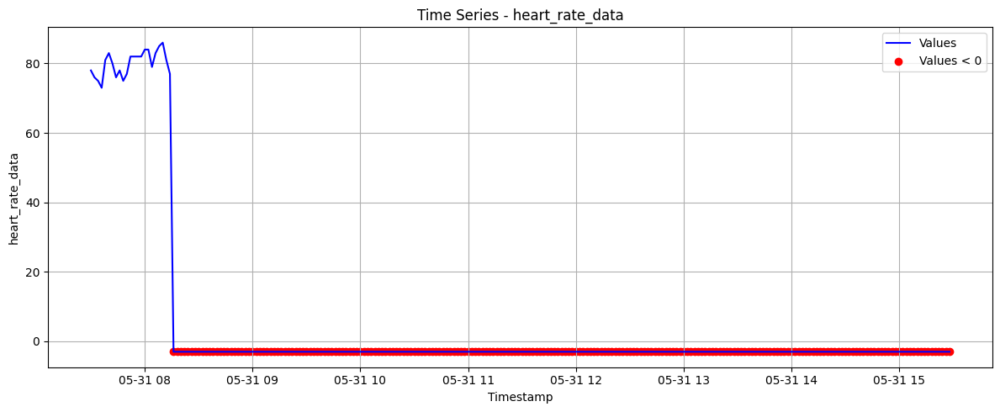

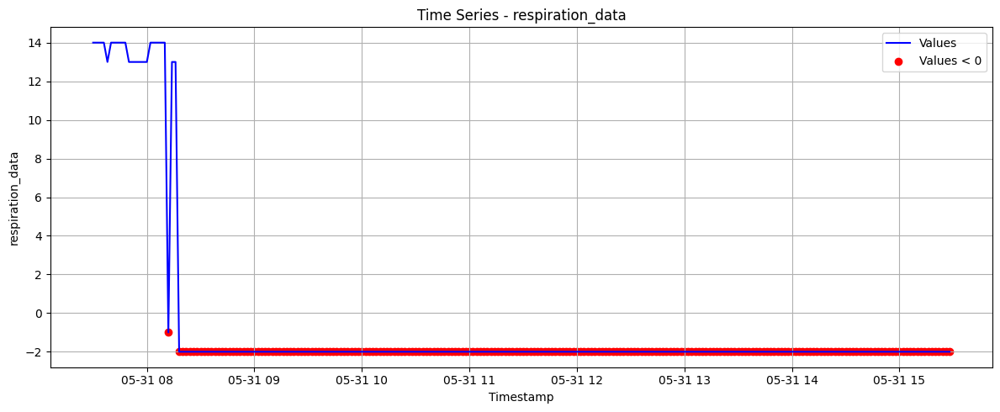

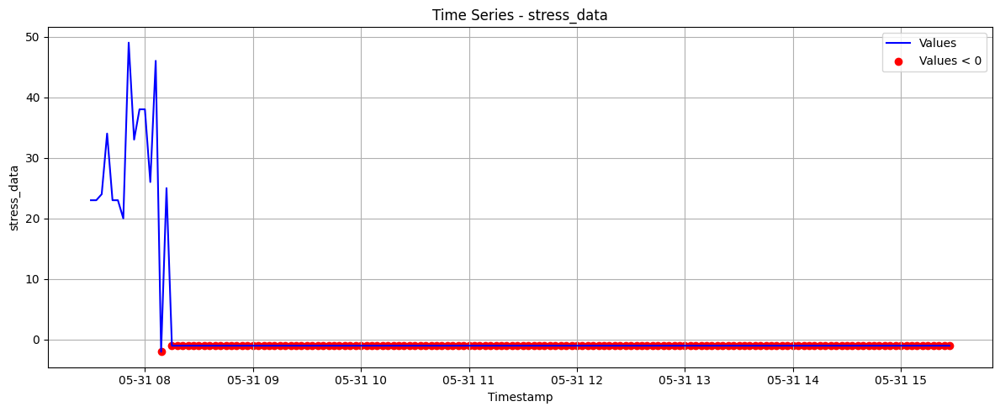

7:


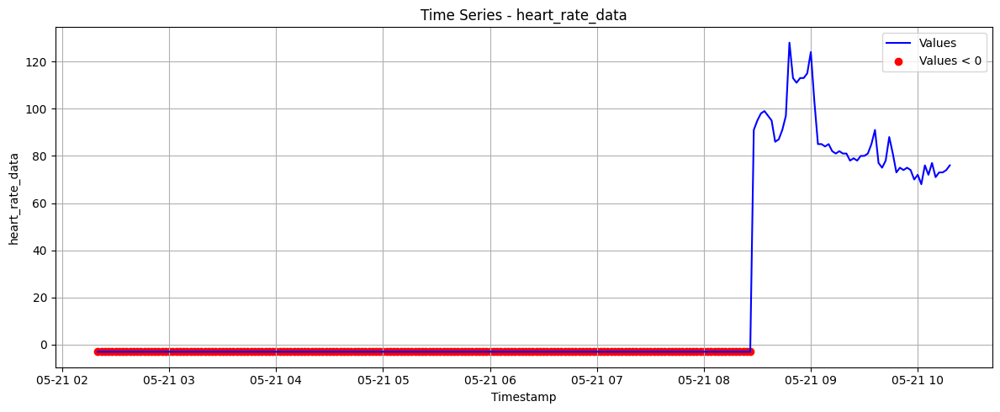

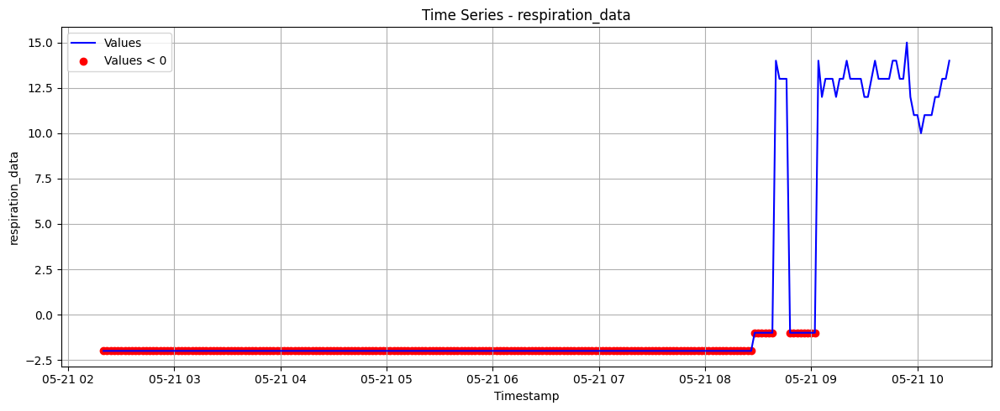

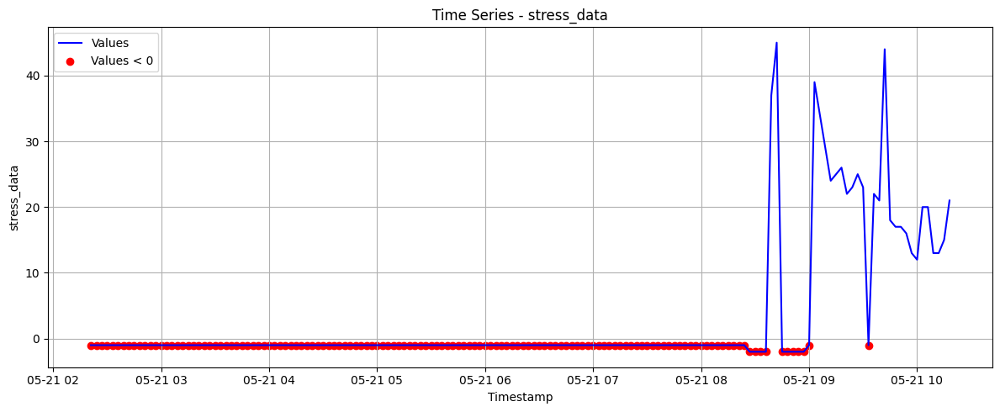

26:


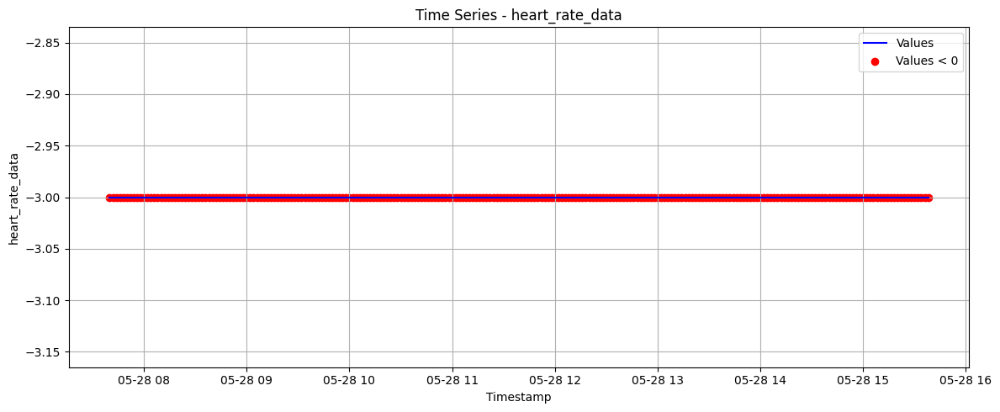

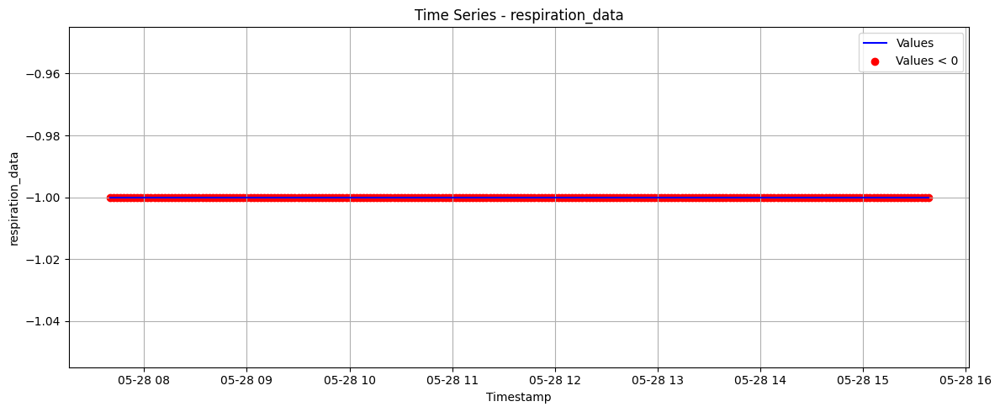

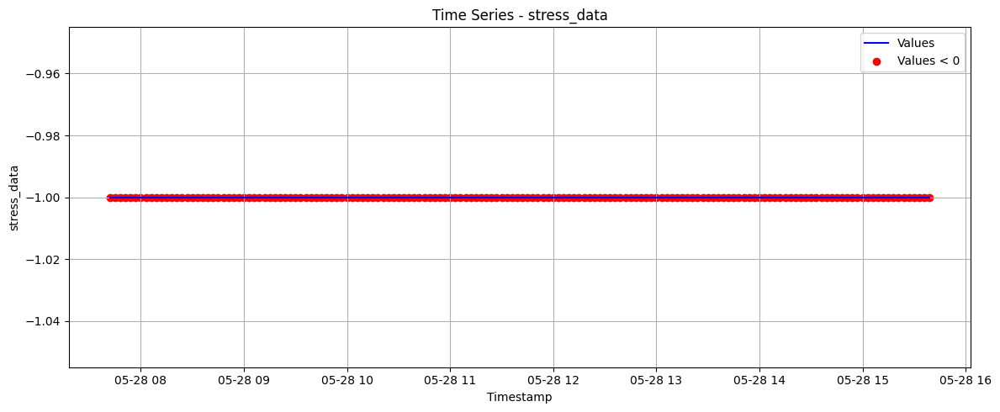

36:


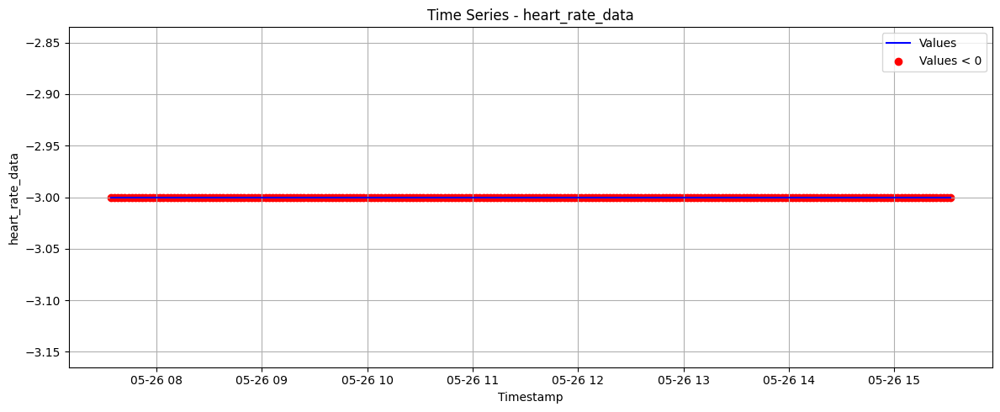

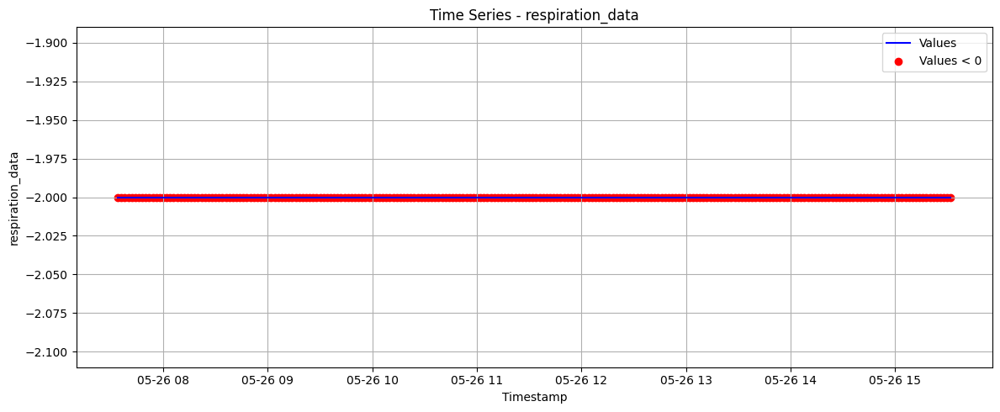

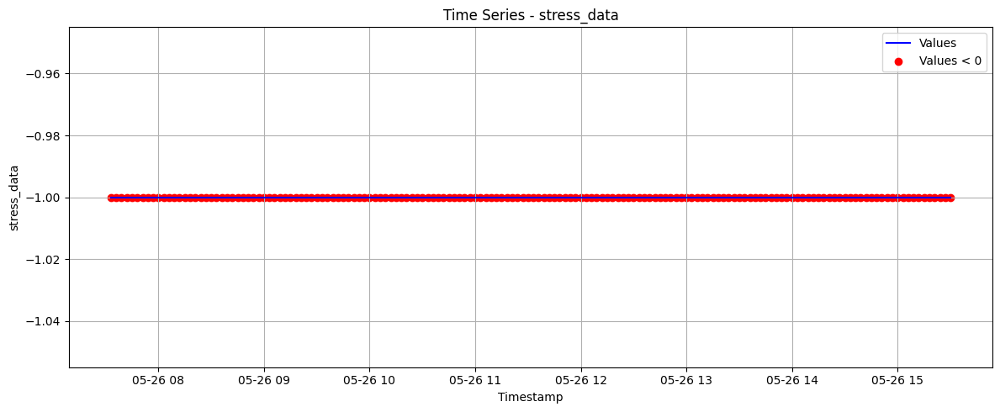

In [ ]:
#prints time-series with more than 6 hours gaps
for idx in indexes:
  plots=7
  print(f'{idx}:')
  three_series_plotter(extracted_series, idx, plots)
  #three_series_plotter(extracted_series_point_inference, idx, plots)
  #three_series_plotter(extracted_series_spiline_inference_5, idx, plots)

Removing from matrix of series tuples with indexes corresponding to series with more than 6 hours without data.
Then the same for the df, displayed for a quick check

In [ ]:
extracted_series_mid_gaps=[item for i, item in enumerate(extracted_series) if i not in indexes]
display_negative_values_percentage(extracted_series, 8)
print('\n\n')
display_negative_values_percentage(extracted_series_mid_gaps, 8)

  0:   0.00|  17.92|  21.25
  1:   0.00|  10.00|  15.00
  2:   5.42|  25.83|  33.75
  3:   3.75|  13.75|  39.38
  4:  41.25|  57.50|  63.12
*Warning*:
  5:  90.42|  90.42|  91.25
  6:  40.00|  57.50|  64.38
*Warning*:
  7:  76.67|  82.50|  83.12
  8:   0.00|   7.92|  11.25
  9:   2.92|   4.58|  11.88
 10:   1.25|   9.17|  11.25
 11:   0.00|   3.33|   5.00
 12:   2.50|  16.67|  20.00
 13:   1.67|  12.92|  16.88
 14:   0.00|  17.50|  22.50
 15:  15.00|  25.42|  28.12
 16:   0.42|  15.00|  18.12
 17:   0.00|  25.00|  30.63
 18:  15.83|  38.33|  46.88
 19:   0.00|   9.58|  13.75
 20:   0.00|  10.83|  30.63
 21:   0.00|   7.08|  11.88
 22:   0.00|   9.17|  14.37
 23:   0.00|  14.17|  22.50
 24:   0.00|   8.33|  15.00
 25:   0.00|   6.67|  19.38
*Warning*:
 26: 100.00| 100.00| 100.00
 27:   7.50|   9.17|  10.62
 28:   0.00|   3.75|   5.00
 29:   4.58|  12.92|  19.38
 30:   0.00|  21.67|  34.38
 31:   0.00|   8.75|  16.25
 32:   2.50|  18.33|  30.00
 33:   4.58|  17.92|  26.25
 34:   0.00|  1

In [ ]:
df_CP_4

,ID,Data,Inizio,Fine,Target_Unbiased
0,ID1,2024-07-26,09:25:00,09:31:00,0.235300
1,ID1,2024-07-19,08:55:00,09:02:00,-0.235300
2,ID11,2024-05-13,18:30:00,19:05:00,-0.341390
3,ID19,2024-05-07,11:36:00,12:00:00,0.262401
4,ID16,2024-05-27,10:55:00,11:20:00,0.096799
5,ID16,2024-05-31,15:50:00,16:12:00,0.198720
6,ID16,2024-05-10,13:30:00,14:00:00,0.215841
7,ID16,2024-05-21,10:40:00,11:10:00,-0.546970
8,ID5,2024-07-19,12:31:00,12:37:00,-0.097210
9,ID24,2024-05-28,16:00:00,17:00:00,-0.119940


In [ ]:
df_CP_5=df_CP_4.drop(index=indexes)
print(indexes)
df_CP_5

[5, 7, 26, 36]


,ID,Data,Inizio,Fine,Target_Unbiased
0,ID1,2024-07-26,09:25:00,09:31:00,0.235300
1,ID1,2024-07-19,08:55:00,09:02:00,-0.235300
2,ID11,2024-05-13,18:30:00,19:05:00,-0.341390
3,ID19,2024-05-07,11:36:00,12:00:00,0.262401
4,ID16,2024-05-27,10:55:00,11:20:00,0.096799
6,ID16,2024-05-10,13:30:00,14:00:00,0.215841
8,ID5,2024-07-19,12:31:00,12:37:00,-0.097210
9,ID24,2024-05-28,16:00:00,17:00:00,-0.119940
10,ID24,2024-05-30,15:30:00,16:30:00,-0.095180
11,ID24,2024-05-31,15:08:00,15:23:00,0.418679


In [ ]:
#Saving extracted_series_mid_gaps in pickle format and df_CP_5 as xlsx


# Save extracted_series_mid_gaps
with open('/content/drive/MyDrive/LL2/extracted_series_mid_gaps.pkl', 'wb') as f:
  pickle.dump(extracted_series_mid_gaps, f)

# Save df_CP_5
df_CP_5.to_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_5.xlsx', index=False)


##Linear Interpolation

In [ ]:
extracted_series_NaN_filled=NaN_filler(extracted_series_mid_gaps)
extracted_series_linear_inference = negative_filler(linear_interpolator_filler(extracted_series_NaN_filled, 30))
extracted_series_full_linear_inference = negative_filler(linear_interpolator_filler(extracted_series_NaN_filled, 0))
#extracted_series_spiline_inference_3 = negative_filler(spiline_filler(extracted_series_NaN_filled, 3))
#extracted_series_spiline_inference_5 = negative_filler(spiline_filler(extracted_series_NaN_filled, 5))

100%|██████████| 34/34 [00:00<00:00, 1788.19it/s]


In [ ]:
display_threshold=0.01
warning_threshold=2
display_longest_gaps(extracted_series_mid_gaps, display_threshold, warning_threshold)
print('\n\n')
#display_longest_gaps(extracted_series_linear_inference, display_threshold, warning_threshold)
print('\n\n')
display_longest_gaps(extracted_series_full_linear_inference, display_threshold, warning_threshold)

100%|██████████| 34/34 [00:00<00:00, 723.03it/s]


  0:   0.00|   0.73|   0.80
  1:   0.00|   0.30|   0.45
  2:   0.43|   0.50|   0.60
  3:   0.30|   0.30|   1.25
*Warning*:
  4:   3.30|   3.30|   3.35
*Warning*:
  5:   3.20|   3.33|   3.25
  6:   0.00|   0.23|   0.55
  7:   0.23|   0.27|   0.35
  8:   0.10|   0.27|   0.55
  9:   0.00|   0.07|   0.25
 10:   0.20|   0.47|   0.45
 11:   0.13|   0.17|   0.20
 12:   0.00|   0.37|   0.50
 13:   1.20|   1.20|   1.20
 14:   0.03|   0.53|   0.55
 15:   0.00|   0.57|   0.60
 16:   1.27|   1.77|   1.90
 17:   0.00|   0.27|   0.35
 18:   0.00|   0.17|   1.35
 19:   0.00|   0.17|   0.25
 20:   0.00|   0.20|   0.25
 21:   0.00|   0.17|   0.50
 22:   0.00|   0.23|   0.55
 23:   0.00|   0.23|   0.70
 24:   0.37|   0.37|   0.40
 25:   0.00|   0.17|   0.15
 26:   0.37|   0.47|   0.55
 27:   0.00|   0.27|   0.50
 28:   0.00|   0.20|   0.45
 29:   0.20|   0.33|   0.90
 30:   0.37|   0.47|   0.60
 31:   0.00|   0.40|   0.40
 32:   0.37|   0.47|   0.60
*Warning*:
 33:   2.77|   3.20|   3.30
_______________

100%|██████████| 34/34 [00:00<00:00, 679.78it/s]


  0:   0.00|   0.00|   0.20
  1:   0.00|   0.00|   0.45
  2:   0.43|   0.50|   0.60
*Warning*:
  4:   3.30|   3.30|   3.35
*Warning*:
  5:   3.20|   3.33|   3.25
  7:   0.23|   0.27|   0.35
 12:   0.00|   0.00|   0.50
 13:   0.00|   0.60|   0.70
 28:   0.00|   0.00|   0.45
*Warning*:
 33:   2.77|   3.20|   3.30
__________________________


[0, 1, 2, 4, 5, 7, 12, 13, 28, 33]

In [ ]:
display_negative_values_percentage(extracted_series_mid_gaps, 8, 30)
print('\n\n')
display_negative_values_percentage(extracted_series_linear_inference, 8, 0.01)
print('\n\n')
indexess=display_negative_values_percentage(extracted_series_full_linear_inference, 8, 0.01)
print(len(indexess))

  2:   5.42|  25.83|  33.75
  3:   3.75|  13.75|  39.38
  4:  41.25|  57.50|  63.12
  5:  40.00|  57.50|  64.38
 15:   0.00|  25.00|  30.63
 16:  15.83|  38.33|  46.88
 18:   0.00|  10.83|  30.63
 27:   0.00|  21.67|  34.38
 29:   2.50|  18.33|  30.00
 33:  34.58|  59.17|  65.62
__________________________
avg:   5.54|  17.98|  24.69



  0:   0.00|   0.00|   2.50
  1:   0.00|   0.00|   5.62
  2:   5.42|   6.25|   7.50
  3:   0.00|   0.00|   1.25
  4:  41.25|  41.25|  41.88
  5:  40.00|  42.08|  40.62
  7:   2.92|   3.33|   6.25
  9:   0.00|   0.00|   0.62
 11:   0.00|   0.00|   0.62
 12:   0.00|   0.83|   6.25
 13:  15.00|  22.50|   8.75
 15:   0.00|   0.00|   1.25
 16:  15.83|  22.08|  23.75
 27:   0.00|   0.42|   0.62
 28:   0.00|   0.00|   5.62
 29:   0.00|   0.83|   0.62
 33:  34.58|  40.00|  41.25
__________________________
avg:   4.56|   5.28|   5.74



  0:   0.00|   0.00|   2.50
  1:   0.00|   0.00|   5.62
  2:   5.42|   6.25|   7.50
  4:  41.25|  41.25|  41.88
  5:  40.00|  41

In [ ]:
'''i=0
for values in extracted_series_mid_gaps[4][2]['stress_data']:
  print(f'{i:>3}: {values:>3}')
  i+=1'''

"i=0\nfor values in extracted_series_mid_gaps[4][2]['stress_data']:\n  print(f'{i:>3}: {values:>3}')\n  i+=1"

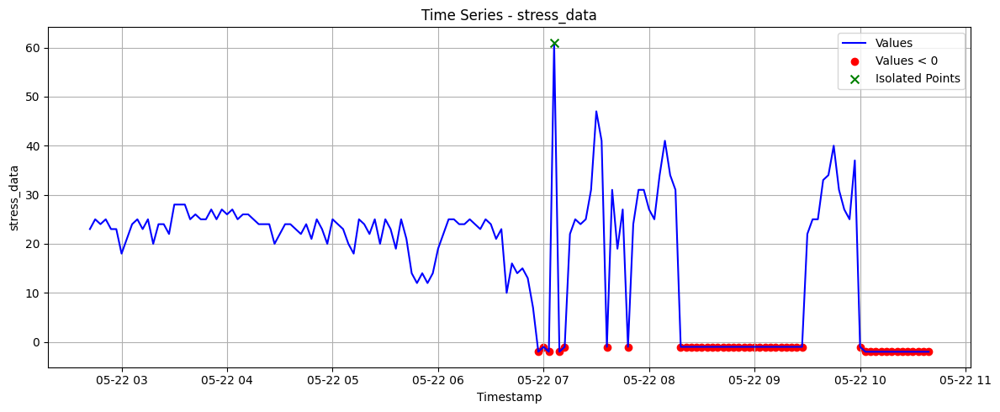

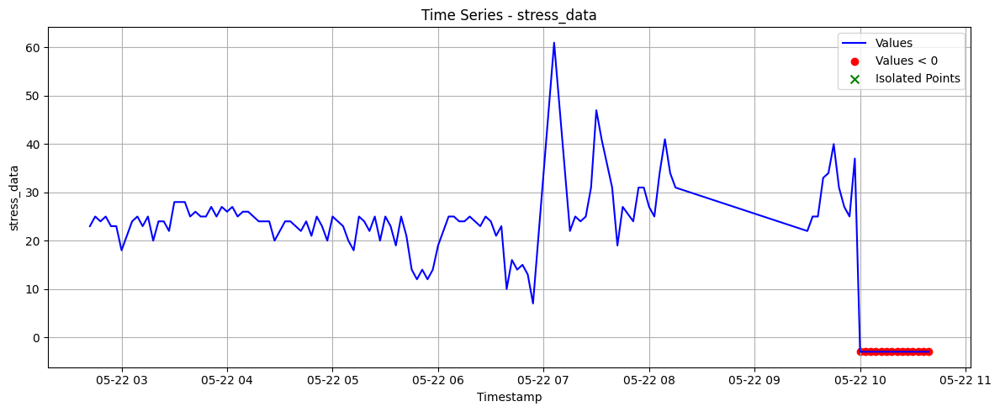

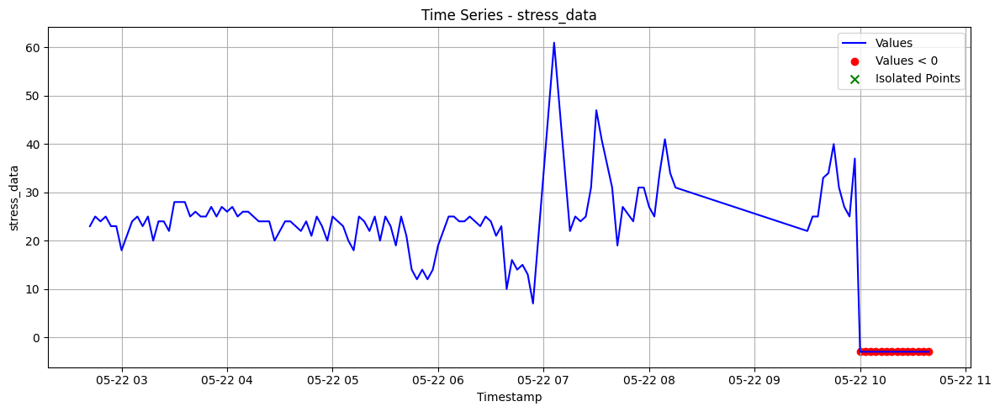

In [ ]:
#plot_time_series_with_negatives(hr_df, 'heart_rate_data')

patient=13
plots=1

column_df=2

if column_df==0:
  plots=4
elif column_df==1:
  plots=2
elif column_df==2:
  plots=1


'''
df_test=extracted_series[patient][2]
df_test=df_test[(df_test['timestamp'].dt.hour >= 8) & (df_test['timestamp'].dt.hour < 10)]
print(df_test)
df_test=extracted_series_spiline_inference[patient][2]
df_test=df_test[(df_test['timestamp'].dt.hour >= 8) & (df_test['timestamp'].dt.hour < 10)]
print(df_test)
#'''
three_series_plotter(extracted_series_mid_gaps, patient, plots)
three_series_plotter(extracted_series_linear_inference, patient, plots)
three_series_plotter(extracted_series_full_linear_inference, patient, plots)


##ARIMA


###Subfunctions

In [ ]:
def adf_test(series):
    """Using an ADF test to determine if a series is stationary"""
    test_results = adfuller(series)
    print('ADF Statistic: ', test_results[0])
    print('P-Value: ', test_results[1])
    print('Critical Values:')
    for thres, adf_stat in test_results[4].items():
        print('\t%s: %.2f' % (thres, adf_stat))
    return test_results[1]

In [ ]:
def kpss_test(timeseries):
    print("Results of KPSS Test:")
    kpsstest = kpss(timeseries, regression="c", nlags="auto")
    kpss_output = pd.Series(
        kpsstest[0:3], index=["Test Statistic", "p-value", "Lags Used"]
    )
    for key, value in kpsstest[3].items():
        kpss_output["Critical Value (%s)" % key] = value
    print(kpss_output)

In [ ]:
def differential_stationarity(series):
  d=0
  while adfuller(series)[1] > 0.05:
    series = series.diff().dropna()
    d+=1
  return series, d

In [ ]:
def should_apply_boxcox(y, rolling_window=20, threshold_ratio=1.5, adf_improvement=0.01, verbose=False):
    """
    Decide whether to apply Box-Cox transformation based on variance stability and ADF improvement.

    Args:
        y (pd.Series): Input time series (no NaNs).
        rolling_window (int): Window for rolling std calculation.
        threshold_ratio (float): Threshold for max/min rolling std to detect heteroscedasticity.
        adf_improvement (float): Minimum ADF p-value improvement to consider Box-Cox beneficial.
        verbose (bool): Whether to print debug info.

    Returns:
        bool: True if Box-Cox is beneficial.
    """
    # Rolling standard deviation
    rolling_std = y.rolling(rolling_window).std().dropna()

    # Variability of stds
    max_std = rolling_std.max()
    min_std = rolling_std.min()
    std_ratio = max_std / min_std if min_std > 0 else np.inf

    # ADF p-values before and after Box-Cox
    adf_before = adfuller(y)[1]

    try:
        y_transformed, _ = boxcox(y)
        adf_after = adfuller(y_transformed)[1]
    except ValueError:
        # Box-Cox non applicabile (es: valori <= 0)
        return False

    if verbose:
        print(f"Rolling std max/min ratio: {std_ratio:.2f}")
        print(f"ADF p-value before: {adf_before:.4f}, after: {adf_after:.4f}")

    # Apply Box-Cox if var unstable or ADF improves significantly
    return std_ratio > threshold_ratio or (adf_before - adf_after) > adf_improvement


In [ ]:
def max_significant_lag_acf_pacf(series, nlags=20, alpha=0.05):
    acf_vals, confint_acf = acf(series, nlags=nlags, alpha=0.05)
    pacf_vals, confint_pacf = pacf(series, nlags=nlags, alpha=0.05)

    sig_acf = [i for i in range(1, len(acf_vals)) if not (confint_acf[i][0] < 0 < confint_acf[i][1])]
    sig_pacf = [i for i in range(1, len(pacf_vals)) if not (confint_pacf[i][0] < 0 < confint_pacf[i][1])]

    p_max = max(sig_pacf) if sig_pacf else 0
    q_max = max(sig_acf) if sig_acf else 0

    return p_max, q_max

In [ ]:
def find_best_arima_model(series, max_p=5, max_q=5, d=0, verbose=False):
    """
    Perform a grid search over ARIMA(p, d, q) models using AIC to find the best (p, q) pair.

    Parameters:
        series (pd.Series): Stationary time series (after differencing if needed).
        max_p (int): Maximum AR order to try.
        max_q (int): Maximum MA order to try.
        d (int): Differencing order already applied to the series.
        verbose (bool): If True, prints progress and results.

    Returns:
        tuple: (best_model, best_aic, best_p, best_q)
    """
    best_aic = np.inf
    best_order = None
    best_model = None

    for p in tqdm(range(max_p + 1)):
        for q in range(max_q + 1):
            try:
                model = ARIMA(series, order=(p, d, q))
                model_fit = model.fit()
                current_aic = model_fit.aic

                if verbose:
                    print(f"Trying ARIMA({p},{d},{q}) AIC={current_aic:.2f}")

                if current_aic < best_aic:
                    best_aic = current_aic
                    best_order = (p, d, q)
                    best_model = model_fit

            except Exception as e:
                if verbose:
                    print(f"ARIMA({p},{d},{q}) failed: {e}")
                continue

    if verbose and best_order:
        print(f"\nBest model: ARIMA{best_order} AIC={best_aic:.2f}")

    return best_model, best_aic, best_order[0], best_order[2]


###Applying

In [ ]:
def apply_arima(df, verbose=False):
  column_name=df.columns[1]

  if verbose:
    print(column_name)

  df[column_name]=df[column_name].mask(df[column_name]<0)
  df.loc[df[column_name] == 0, column_name]=1
  #df[column_name][df[column_name]==0]=1
  interval=find_first_last_valid_index(df, column_name)
  if verbose:
    print(f"{interval[0]}:{interval[1]}")

  requires_front_ARIMA=False
  requires_rear_ARIMA=False


  if(interval[1]!=len(df)-1):
    requires_front_ARIMA=True
    if verbose:
      print(df.iloc[interval[1]:])
  if(interval[0]!=0):
    requires_rear_ARIMA=True
    if verbose:
      print(df.iloc[:interval[0]+1])

  if verbose:
    plot_single_time_series(df)
  #print((df['respiration_data']==-3).idxmax())



  box_cox_df=df.iloc[interval[0]: interval[1]+1].copy()

  reverse_box_cox_required=False

  if(adf_test(box_cox_df[column_name])>0.05):
    box_cox_df[column_name], lam = boxcox(box_cox_df[column_name])
    box_cox_df.loc[box_cox_df[column_name] == 0, column_name]=0.001
    if verbose:
      plot_single_time_series(box_cox_df, column_name, 'Box-Cox')
    reverse_box_cox_required=True



  box_cox_diff_df=box_cox_df.copy()
  box_cox_diff_df[column_name], d = differential_stationarity(box_cox_diff_df[column_name])

  print(f'number of differentiation: {d}')

  if d>0 and verbose:
    plot_single_time_series(box_cox_diff_df, column_name, 'Box-Cox-Diff')


  rear_forecasts=None
  front_forecasts=None

  if requires_front_ARIMA:
    max_pacf, max_acf = max_significant_lag_acf_pacf(box_cox_diff_df[column_name][d:])

    if verbose:
      # Plot autocorrelation
      plt.rc("figure", figsize=(8,4))
      plot_acf(box_cox_diff_df[column_name][d:], lags=25)
      plt.ylim(0,1)
      plt.xlabel('Lags', fontsize=18)
      plt.ylabel('Correlation', fontsize=18)
      plt.xticks(fontsize=18)
      plt.yticks(fontsize=18)
      plt.title(f'Autocorrelation Plot: {max_acf}', fontsize=20)
      plt.tight_layout()
      plt.show()

      # Plot partial autocorrelation
      plt.rc("figure", figsize=(11,5))
      plot_pacf(box_cox_diff_df[column_name][d:], method='ywm')
      plt.xlabel('Lags', fontsize=18)
      plt.ylabel('Front Correlation', fontsize=18)
      plt.xticks(fontsize=18)
      plt.yticks(fontsize=18)
      plt.title(f'Front Partial Autocorrelation Plot: {max_pacf}', fontsize=20)
      plt.tight_layout()
      plt.show()

    model, aic, p, q = find_best_arima_model(box_cox_df[column_name], max_p=max_pacf, max_q=max_acf, d=d)
    #boxcox_forecasts = model.forecast(len(df)-len(box_cox_df))
    if verbose:
      print(f'Number of predictions with interval: {type(int(len(df)-1-interval[1]))}')
      print(f'Number of predictions with interval: {type(len(df)-len(box_cox_df))}')

    boxcox_forecasts = model.forecast(int(len(df)-1-interval[1]))

    if reverse_box_cox_required:
      front_forecasts = inv_boxcox(boxcox_forecasts, lam)
    else:
      front_forecasts = boxcox_forecasts

  if requires_rear_ARIMA:
    box_cox_diff_df=box_cox_diff_df[::-1]
    box_cox_df=box_cox_df[::-1]
    length=len(box_cox_df)-d
    max_pacf, max_acf = max_significant_lag_acf_pacf(box_cox_diff_df[column_name][:length])

    if verbose:
      # Plot autocorrelation
      plt.rc("figure", figsize=(8,4))
      plot_acf(box_cox_diff_df[column_name][:length], lags=25)
      plt.ylim(0,1)
      plt.xlabel('Lags', fontsize=18)
      plt.ylabel('Correlation', fontsize=18)
      plt.xticks(fontsize=18)
      plt.yticks(fontsize=18)
      plt.title(f'Rear Autocorrelation Plot: {max_acf}', fontsize=20)
      plt.tight_layout()
      plt.show()

      # Plot partial autocorrelation
      plt.rc("figure", figsize=(11,5))
      plot_pacf(box_cox_diff_df[column_name][:length], method='ywm')
      plt.xlabel('Lags', fontsize=18)
      plt.ylabel('Correlation', fontsize=18)
      plt.xticks(fontsize=18)
      plt.yticks(fontsize=18)
      plt.title(f'Rear Partial Autocorrelation Plot: {max_pacf}', fontsize=20)
      plt.tight_layout()
      plt.show()

    model, aic, p, q = find_best_arima_model(box_cox_df[column_name], max_p=max_pacf, max_q=max_acf, d=d)
    boxcox_forecasts = model.forecast(int(interval[0]))
    if reverse_box_cox_required:
      rear_forecasts = inv_boxcox(boxcox_forecasts, lam)[::-1]
    else:
      rear_forecasts = boxcox_forecasts[::-1]



  def plot_forecasts(front_forecasts: list[float],rear_forecasts: list[float], title: str) -> None:
    """Function to plot the forecasts."""
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df['timestamp'][interval[0]: interval[1]+1], y=df[column_name][interval[0]: interval[1]+1], name='Train'))

    if requires_front_ARIMA:
      fig.add_trace(go.Scatter(x=df['timestamp'][interval[1]+1:], y=front_forecasts, name='Front Forecast'))
    if requires_rear_ARIMA:
      fig.add_trace(go.Scatter(x=df['timestamp'][:interval[0]], y=rear_forecasts, name='Rear Forecast'))
    fig.update_layout(template="simple_white", font=dict(size=18), title_text=title,
                      width=650, title_x=0.5, height=400, xaxis_title='Date',
                      yaxis_title=column_name)

    return fig.show()


  # Plot the forecasts
  #if verbose:
  plot_forecasts(front_forecasts, rear_forecasts, 'ARIMA')

  #'''
  return_df=df.copy()
  if requires_rear_ARIMA:
    return_df.loc[:interval[0]-1, column_name] = rear_forecasts
    if verbose:
      print(f'Interval[0]:{interval[0]}')
      print(f'#Rear forecasts:{len(rear_forecasts)}')
      print(return_df.iloc[interval[0]-4:interval[0]+4])
  if requires_front_ARIMA:
    return_df.loc[interval[1]+1:, column_name] = front_forecasts
    if verbose:
      print(f'Interval[1]: {interval[1]}')
      print(f'#Front forecasts:{len(front_forecasts)}')
      print(return_df.iloc[interval[1]-1:interval[1]+5])

  return return_df
  #'''

ADF Statistic:  -3.2702535898096077
P-Value:  0.01626164219097751
Critical Values:
	1%: -3.50
	5%: -2.89
	10%: -2.58
number of differentiation: 0


100%|██████████| 2/2 [00:00<00:00,  3.52it/s]


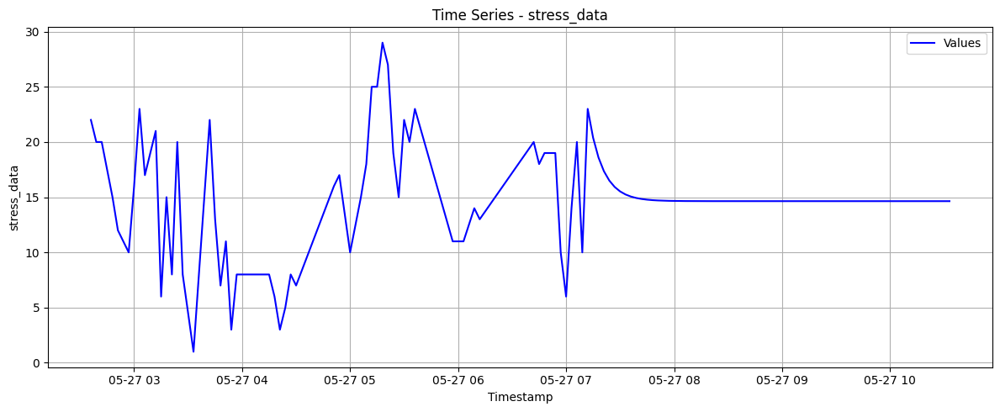

In [ ]:
disp_df=extracted_series_full_linear_inference[4][2].copy()

#returned_df=apply_arima(disp_df, True)
new_df=apply_arima(disp_df, False)
plot_single_time_series(new_df)

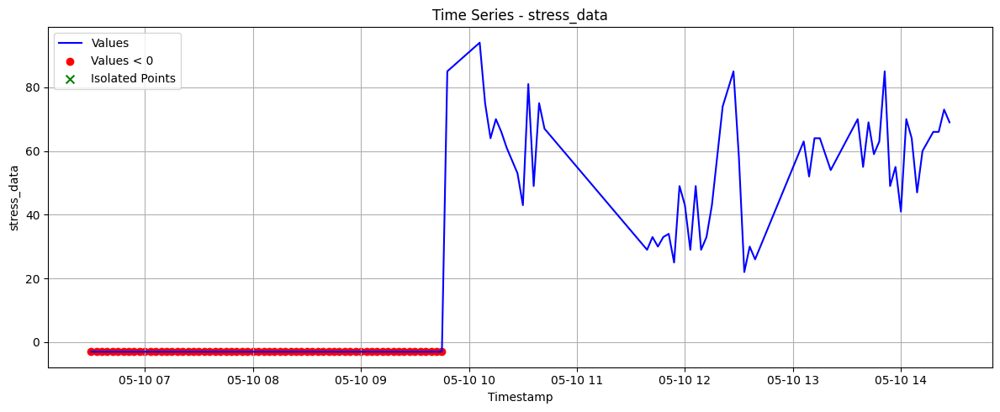

ADF Statistic:  -2.774056001416493
P-Value:  0.06207631189883694
Critical Values:
	1%: -3.50
	5%: -2.89
	10%: -2.58
number of differentiation: 1


  0%|          | 0/5 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

100%|██████████| 5/5 [00:00<00:00,  9.08it/s]


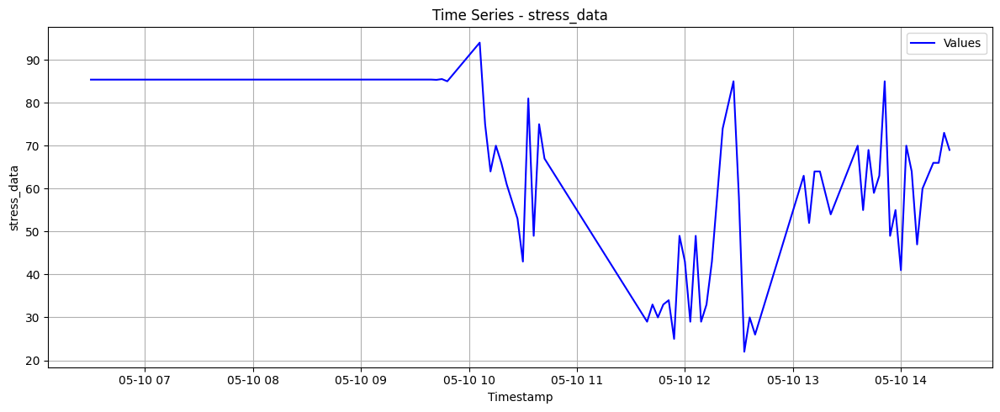

In [ ]:
disp_df=extracted_series_full_linear_inference[33][2].copy()
plot_time_series_with_negatives(disp_df)
new_df_2=apply_arima(disp_df, False)
plot_single_time_series(new_df_2)




patient 0 have null values





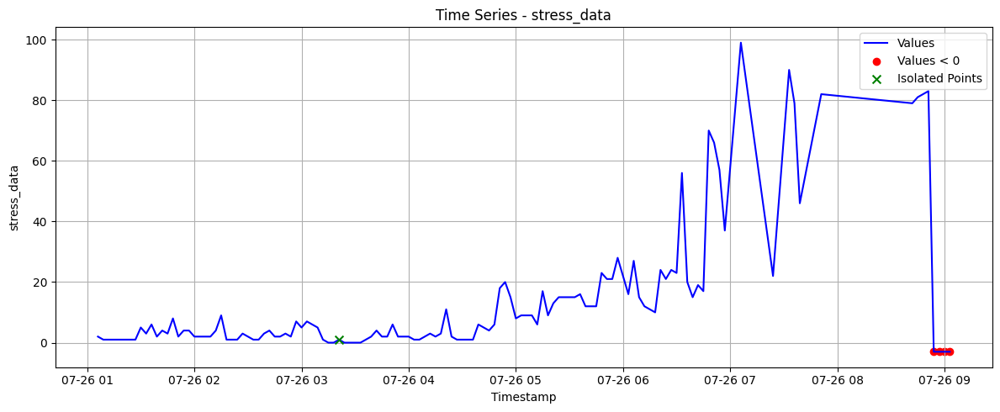

ADF Statistic:  0.9158440195825709
P-Value:  0.9932936503472338
Critical Values:
	1%: -3.48
	5%: -2.88
	10%: -2.58
number of differentiation: 1


 12%|█▏        | 2/17 [00:00<00:00, 16.70it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

100%|██████████| 17/17 [00:13<00:00,  1.25it/s]


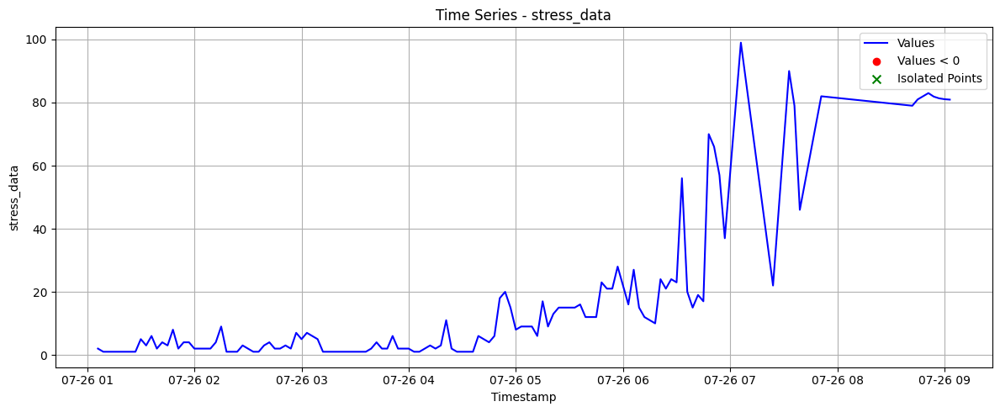




patient 1 have null values





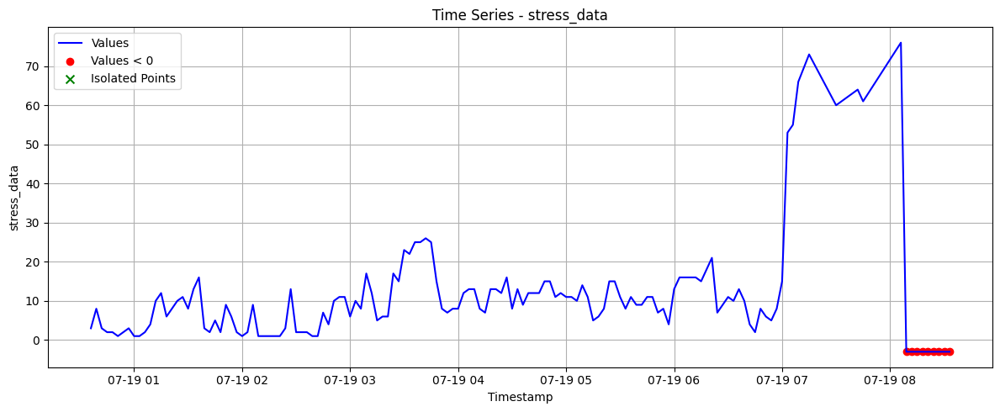

ADF Statistic:  -0.28261643716959123
P-Value:  0.9279305356606875
Critical Values:
	1%: -3.47
	5%: -2.88
	10%: -2.58
number of differentiation: 1


 12%|█▏        | 2/17 [00:02<00:18,  1.23s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 18%|█▊        | 3/17 [00:06<00:35,  2.50s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarnin

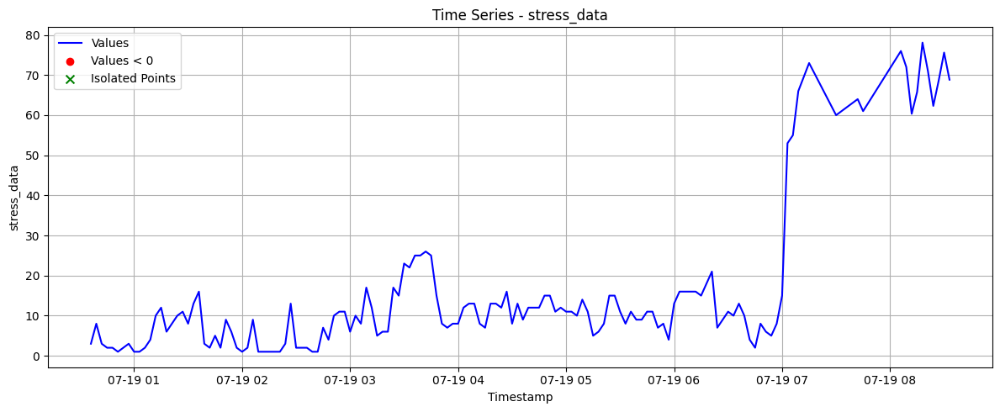




patient 2 have null values





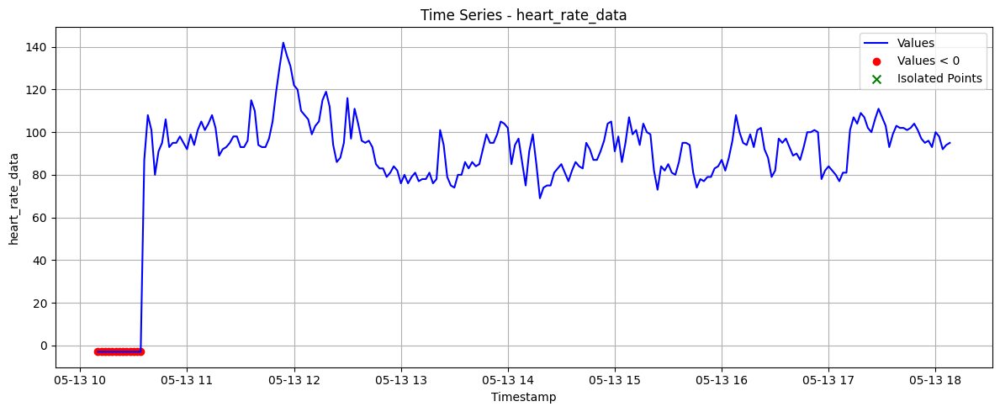

ADF Statistic:  -5.028214184301417
P-Value:  1.950979598355943e-05
Critical Values:
	1%: -3.46
	5%: -2.87
	10%: -2.57
number of differentiation: 0


100%|██████████| 2/2 [00:04<00:00,  2.37s/it]


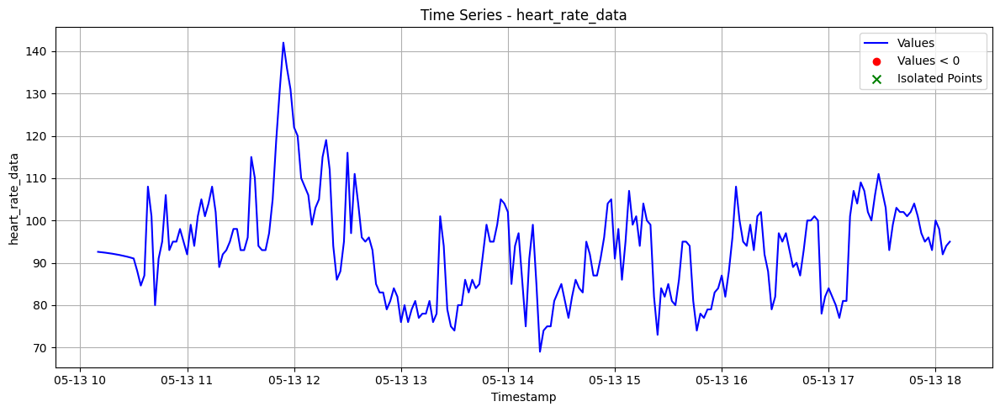

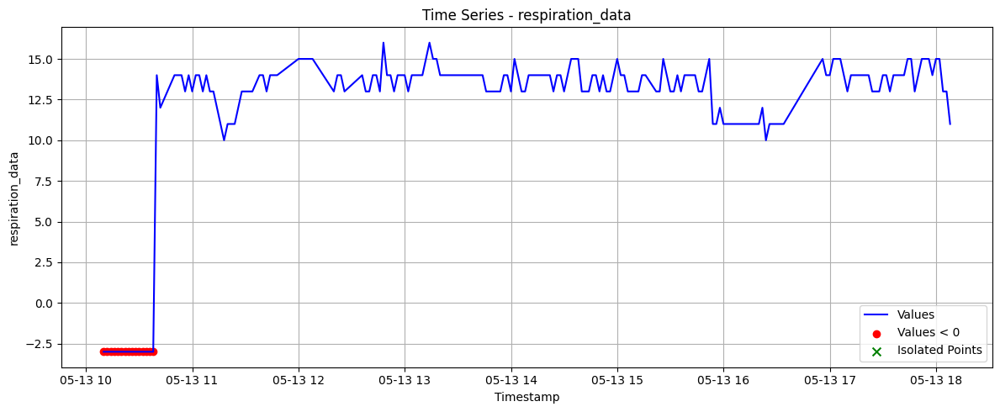

ADF Statistic:  -3.3517141444683958
P-Value:  0.012719282481312027
Critical Values:
	1%: -3.46
	5%: -2.87
	10%: -2.57
number of differentiation: 0


 13%|█▎        | 2/15 [00:08<00:57,  4.45s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 20%|██        | 3/15 [00:13<01:00,  5.05s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespac

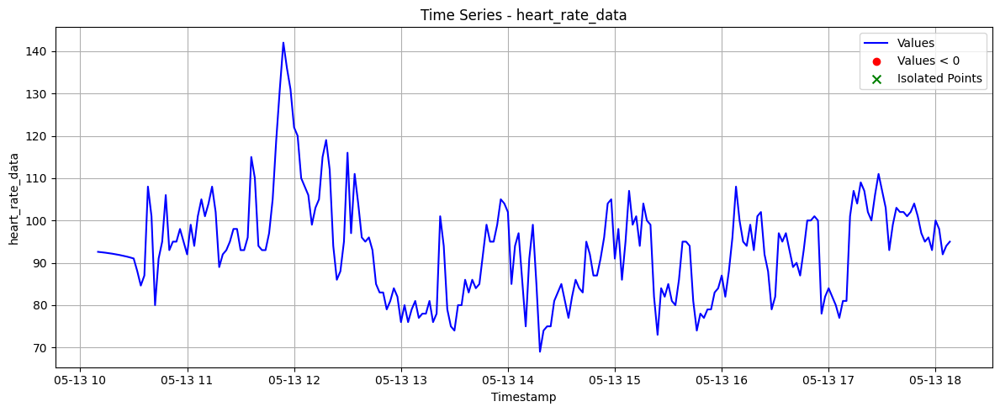

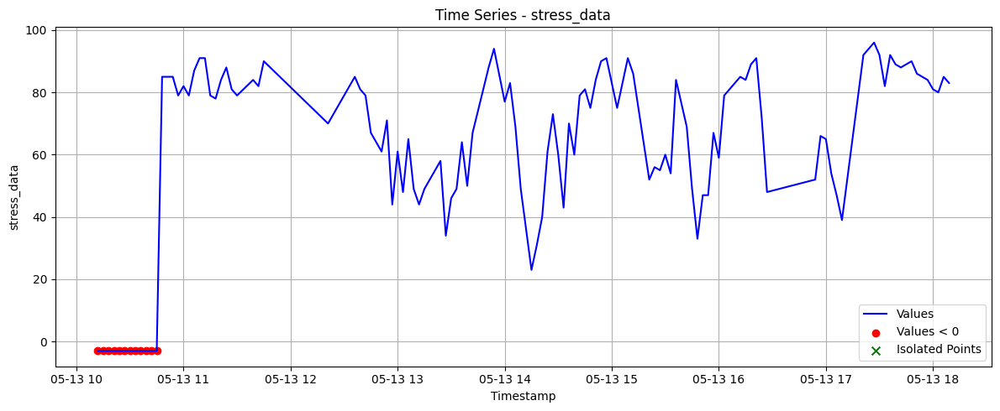

ADF Statistic:  -4.295437260155965
P-Value:  0.00045236381493857024
Critical Values:
	1%: -3.48
	5%: -2.88
	10%: -2.58
number of differentiation: 0


 10%|▉         | 2/21 [00:01<00:14,  1.30it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 14%|█▍        | 3/21 [00:02<00:18,  1.03s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 19%|█▉        | 4/21 [00:04<00:21,  1.27s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/us

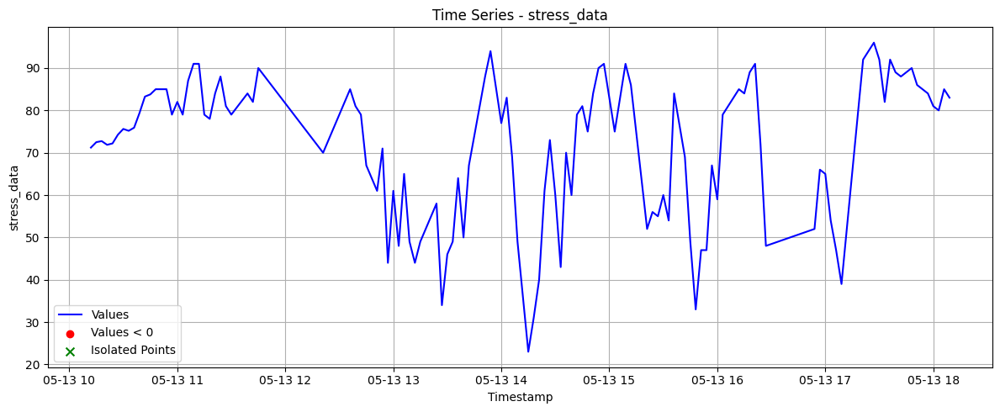




patient 4 have null values





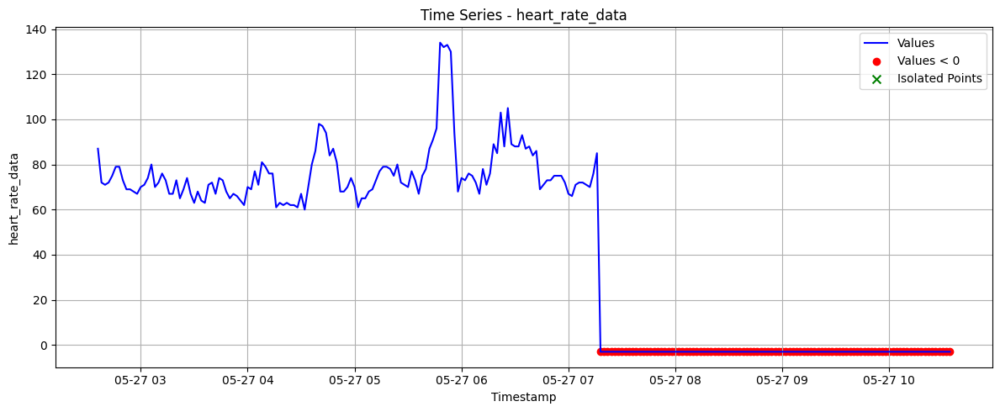

ADF Statistic:  -4.483254023883668
P-Value:  0.00021080383383877789
Critical Values:
	1%: -3.48
	5%: -2.88
	10%: -2.58
number of differentiation: 0


 50%|█████     | 2/4 [00:00<00:00,  2.17it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

100%|██████████| 4/4 [00:02<00:00,  1.43it/s]


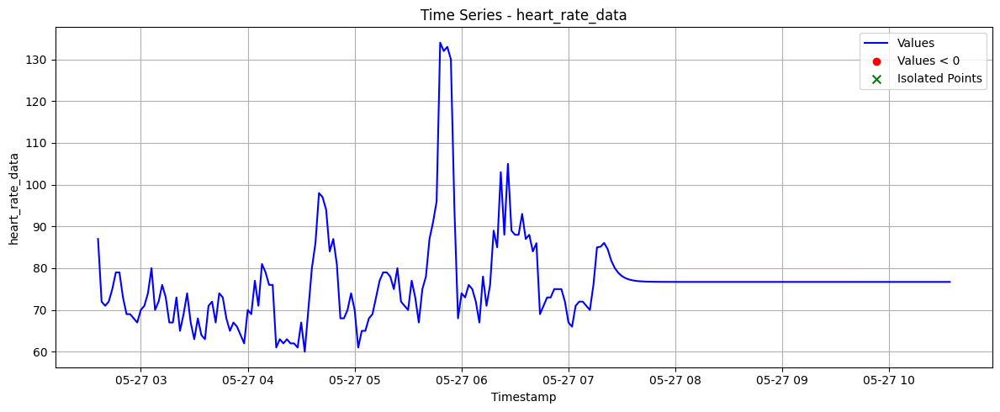

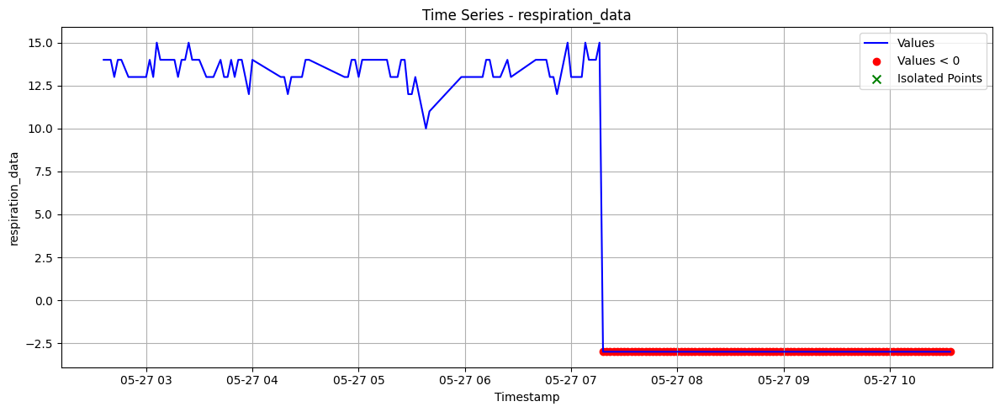

ADF Statistic:  -2.6164438135543313
P-Value:  0.08964606785408874
Critical Values:
	1%: -3.48
	5%: -2.88
	10%: -2.58
number of differentiation: 1


  0%|          | 0/9 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 11%|█         | 1/9 [00:04<00:32,  4.00s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 22%|██▏       | 2/9 [00:06<00:21,  3.10s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/st

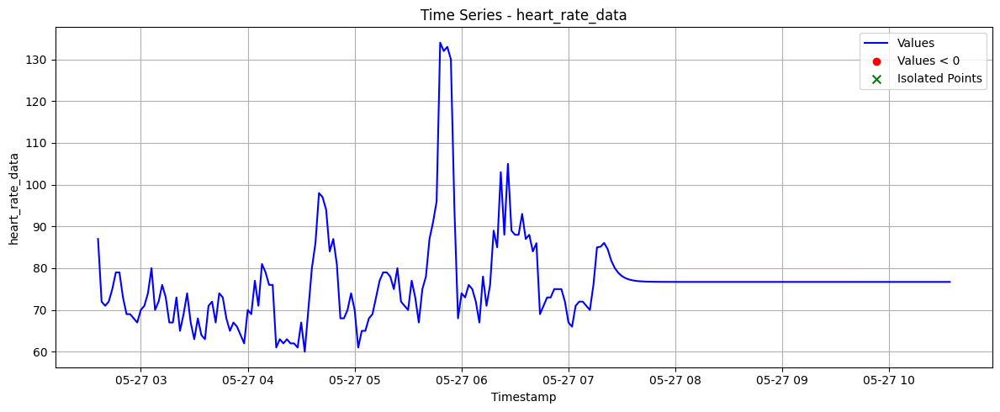

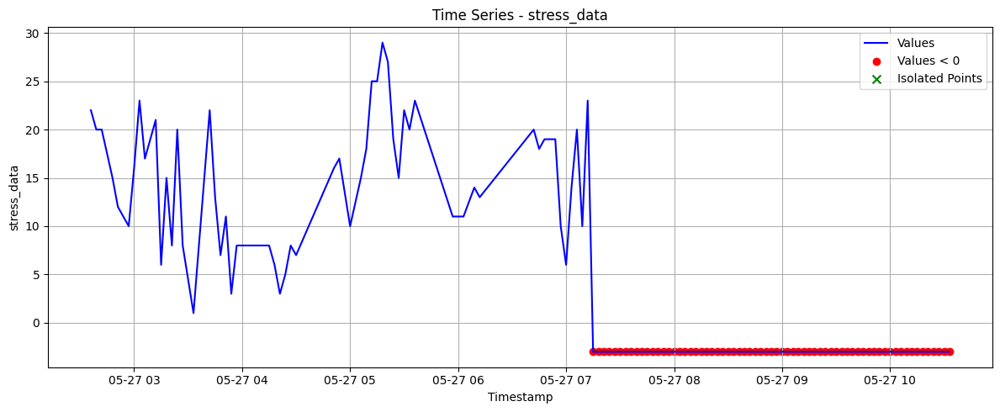

ADF Statistic:  -3.2702535898096077
P-Value:  0.01626164219097751
Critical Values:
	1%: -3.50
	5%: -2.89
	10%: -2.58
number of differentiation: 0


100%|██████████| 2/2 [00:00<00:00,  3.43it/s]


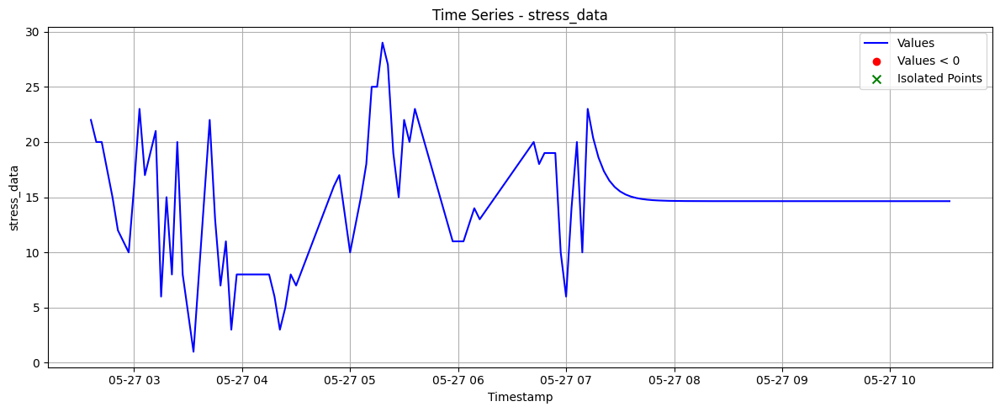




patient 5 have null values





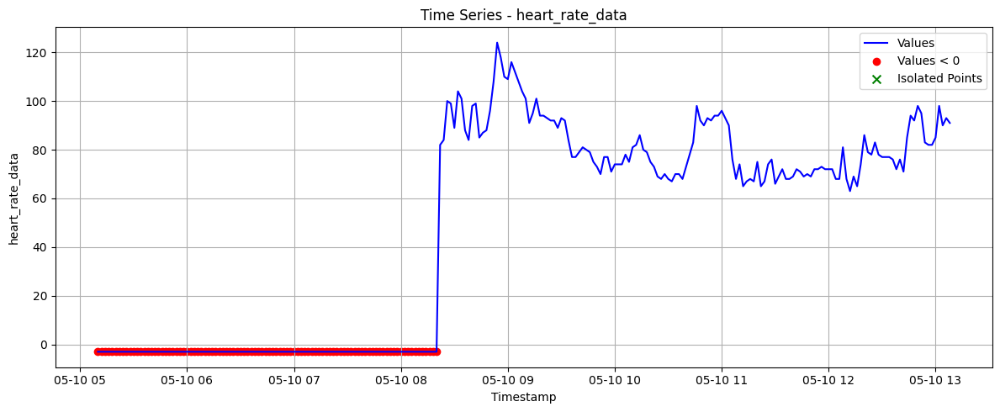

ADF Statistic:  -2.24441275251272
P-Value:  0.1905226728566427
Critical Values:
	1%: -3.48
	5%: -2.88
	10%: -2.58
number of differentiation: 1


  0%|          | 0/11 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

  9%|▉         | 1/11 [00:00<00:04,  2.16it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum L

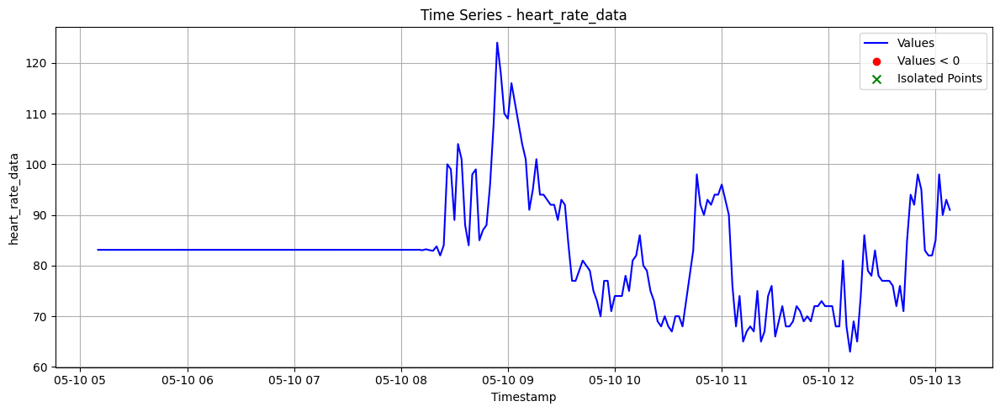

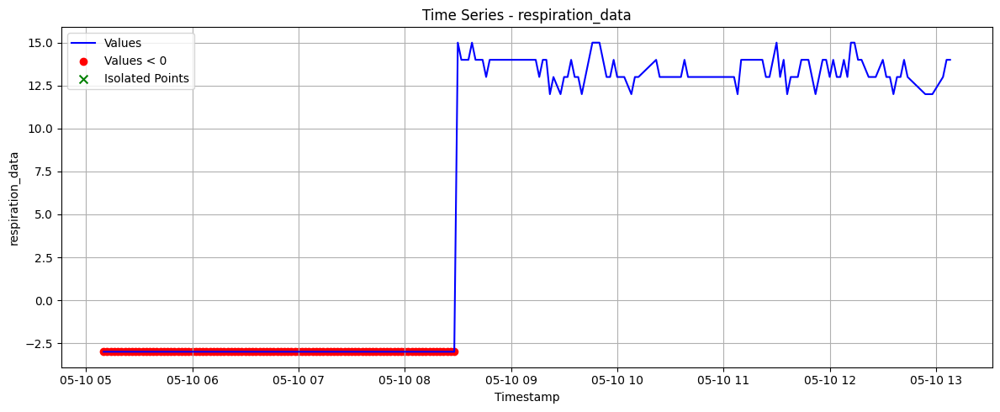

ADF Statistic:  -6.611485976893668
P-Value:  6.360576456865003e-09
Critical Values:
	1%: -3.48
	5%: -2.88
	10%: -2.58
number of differentiation: 0


 23%|██▎       | 3/13 [00:00<00:02,  3.61it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 31%|███       | 4/13 [00:01<00:04,  2.22it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/

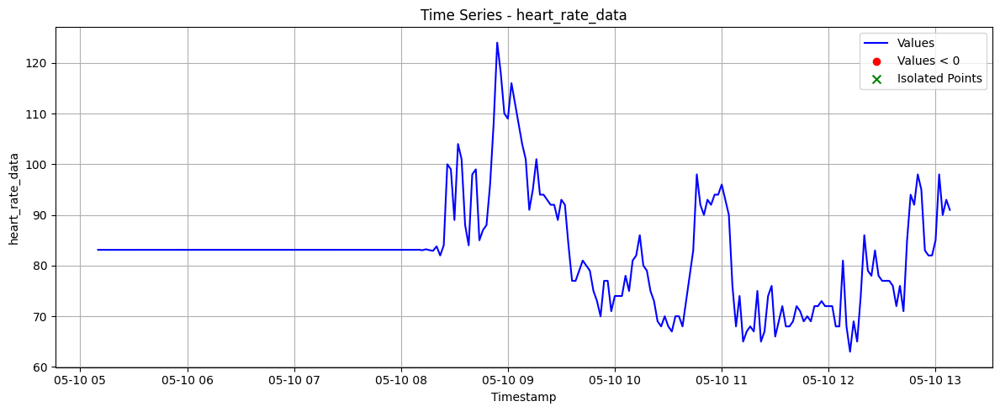

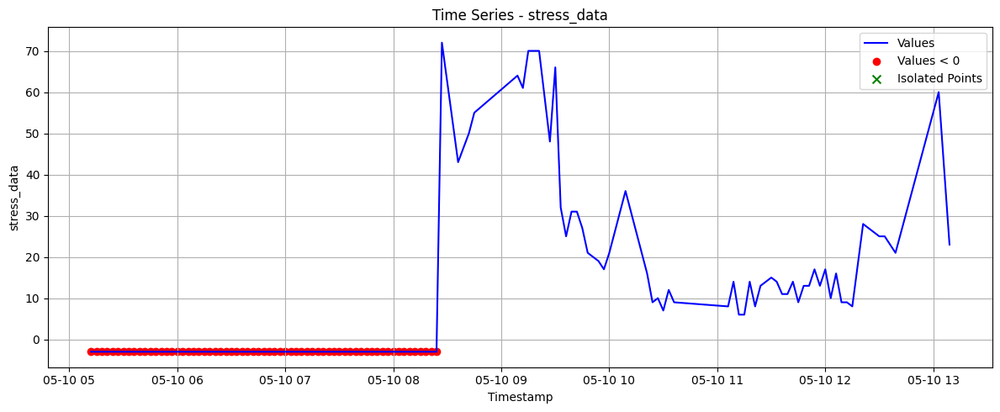

ADF Statistic:  -2.336665560268832
P-Value:  0.1604150629670678
Critical Values:
	1%: -3.50
	5%: -2.89
	10%: -2.58
number of differentiation: 1


100%|██████████| 2/2 [00:00<00:00, 13.39it/s]


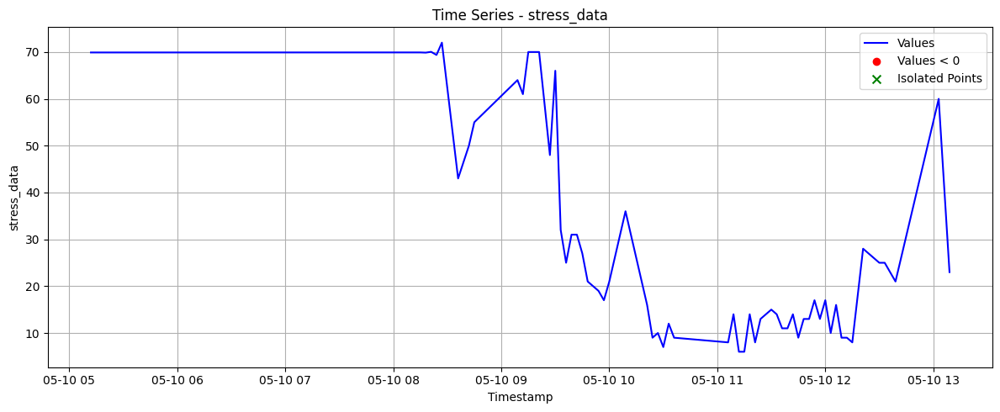




patient 7 have null values





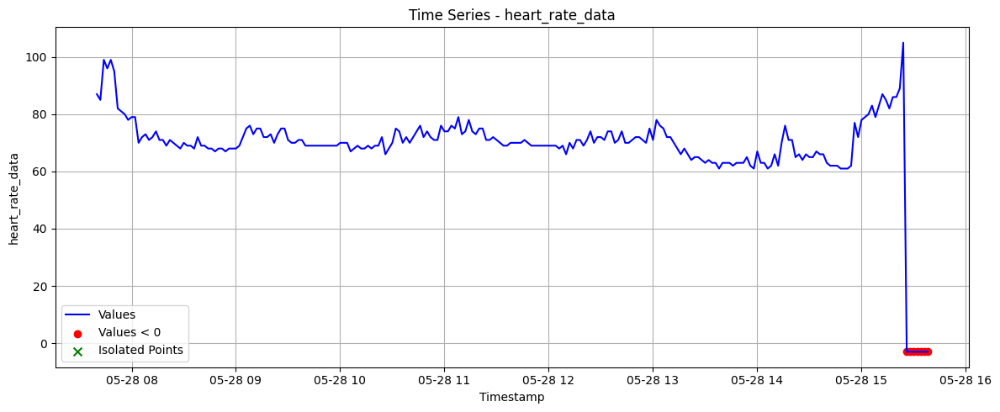

ADF Statistic:  -1.3407499972190478
P-Value:  0.6103291900920886
Critical Values:
	1%: -3.46
	5%: -2.87
	10%: -2.57
number of differentiation: 1


  0%|          | 0/17 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

  6%|▌         | 1/17 [00:00<00:02,  5.80it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 12%|█▏        | 2/17 [00:00<00:03,  4.59it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/bas

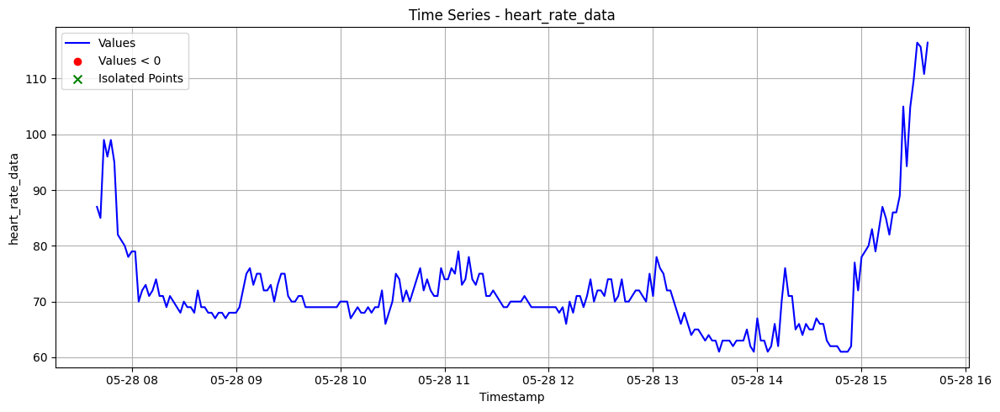

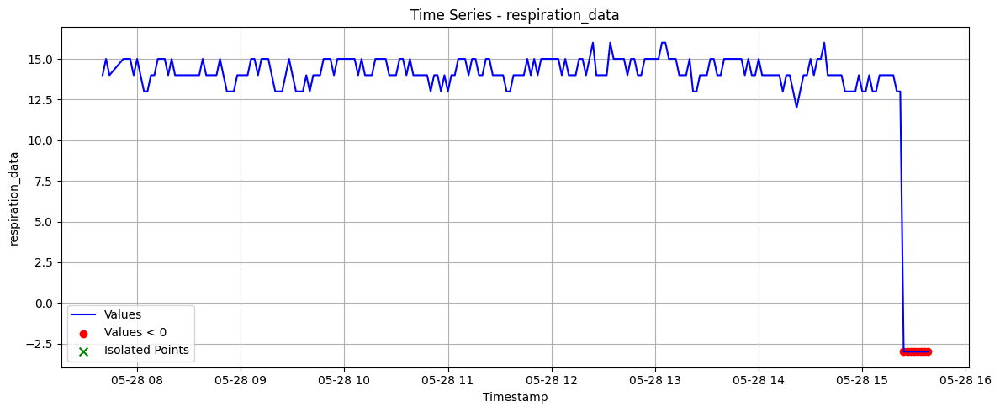

ADF Statistic:  -6.515373458235966
P-Value:  1.0746458479853172e-08
Critical Values:
	1%: -3.46
	5%: -2.87
	10%: -2.57
number of differentiation: 0


100%|██████████| 2/2 [00:03<00:00,  1.77s/it]


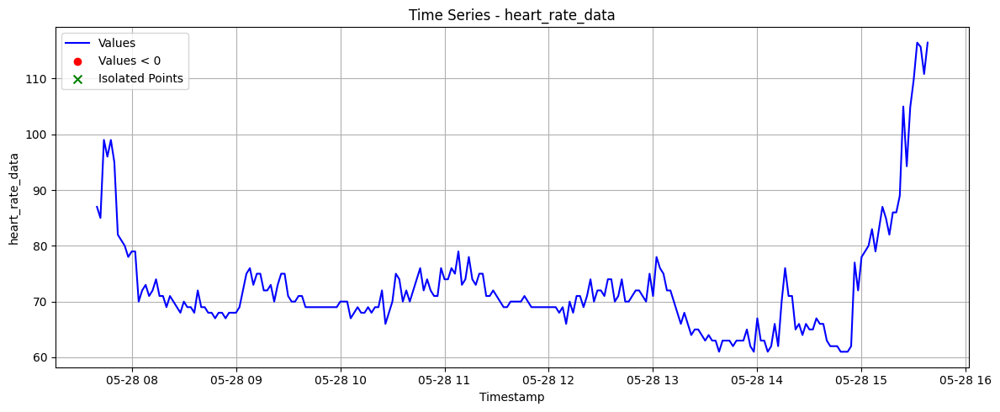

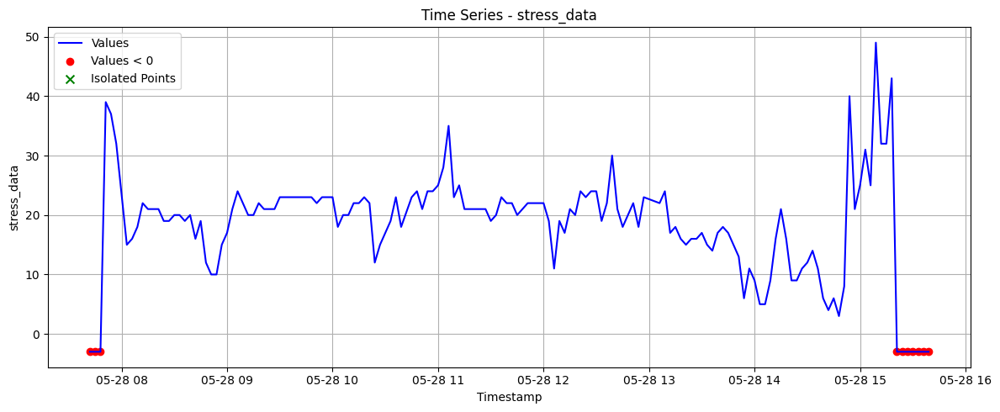

ADF Statistic:  -2.1461347052464887
P-Value:  0.22637255866514933
Critical Values:
	1%: -3.48
	5%: -2.88
	10%: -2.58
number of differentiation: 1


 14%|█▍        | 3/21 [00:01<00:09,  1.82it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 24%|██▍       | 5/21 [00:04<00:14,  1.08it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 29%|██▊       | 6/21 [00:06<00:20,  1.33s/it]/usr/local/lib/pyth

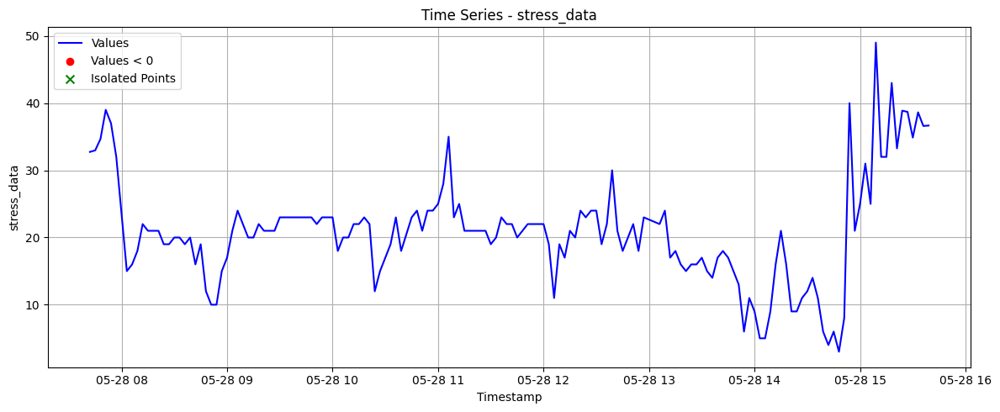




patient 12 have null values





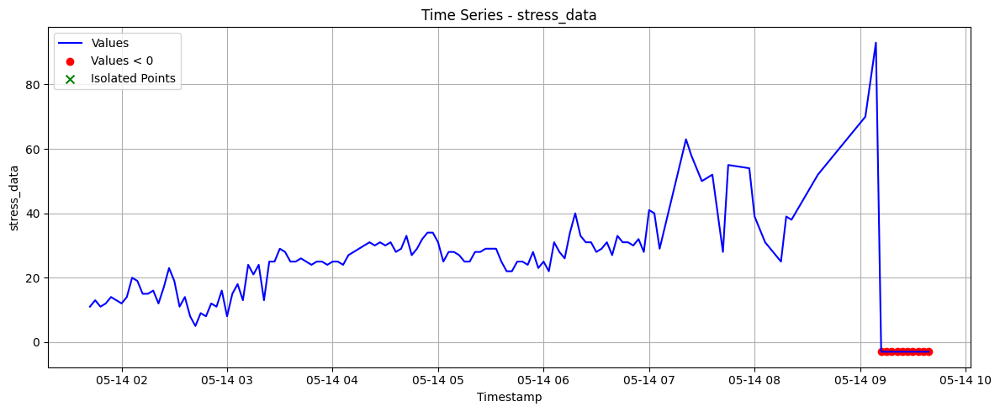

ADF Statistic:  -0.2501998247901363
P-Value:  0.9322673728555902
Critical Values:
	1%: -3.48
	5%: -2.88
	10%: -2.58
number of differentiation: 1


  5%|▌         | 1/19 [00:00<00:17,  1.01it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

 11%|█         | 2/19 [00:02<00:22,  1.34s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/

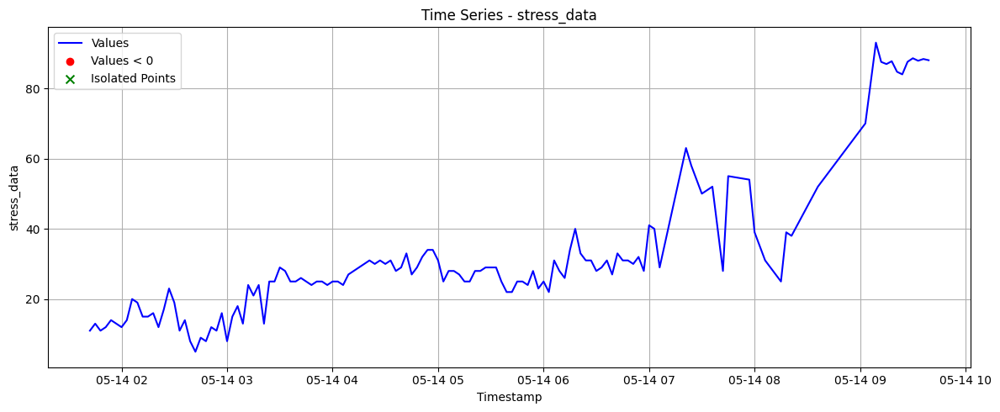




patient 13 have null values





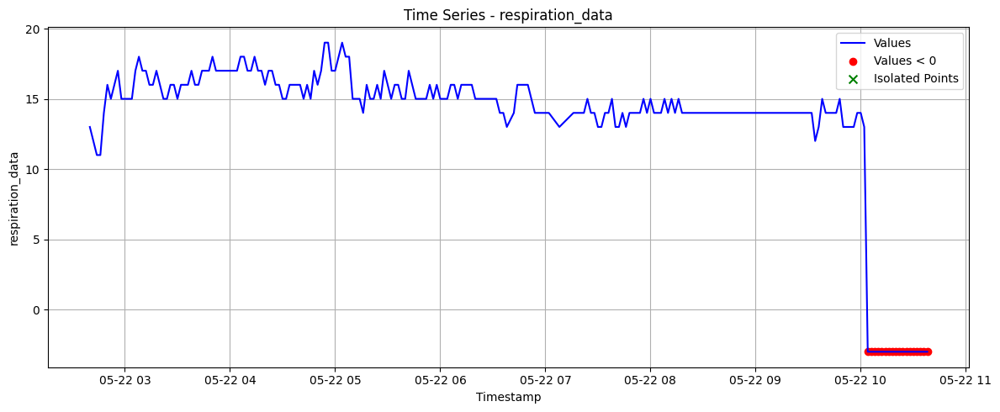

ADF Statistic:  -2.6353357152950085
P-Value:  0.08591176807048928
Critical Values:
	1%: -3.46
	5%: -2.87
	10%: -2.57
number of differentiation: 1


  7%|▋         | 1/14 [00:00<00:08,  1.53it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 21%|██▏       | 3/14 [00:03<00:12,  1.18s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 29%|██▊       | 4/14 [00:05<00:14,  1.45s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmo

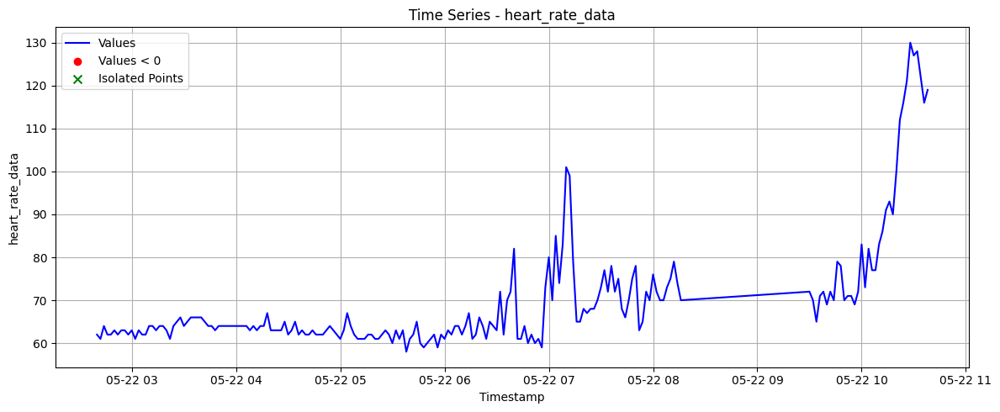

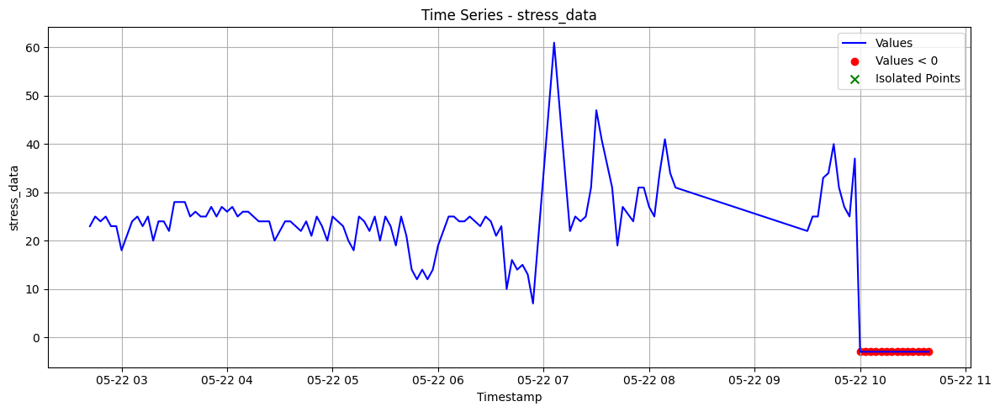

ADF Statistic:  -5.0519165170659655
P-Value:  1.7500075940258613e-05
Critical Values:
	1%: -3.48
	5%: -2.88
	10%: -2.58
number of differentiation: 0


100%|██████████| 3/3 [00:00<00:00,  3.17it/s]


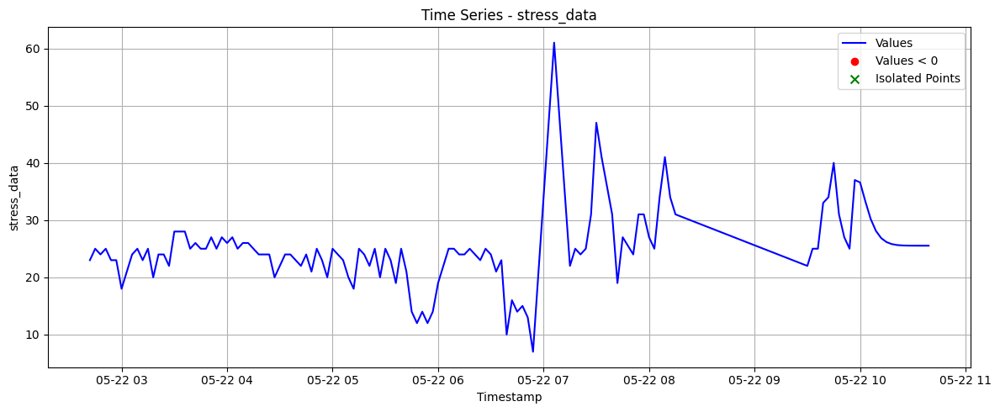




patient 28 have null values





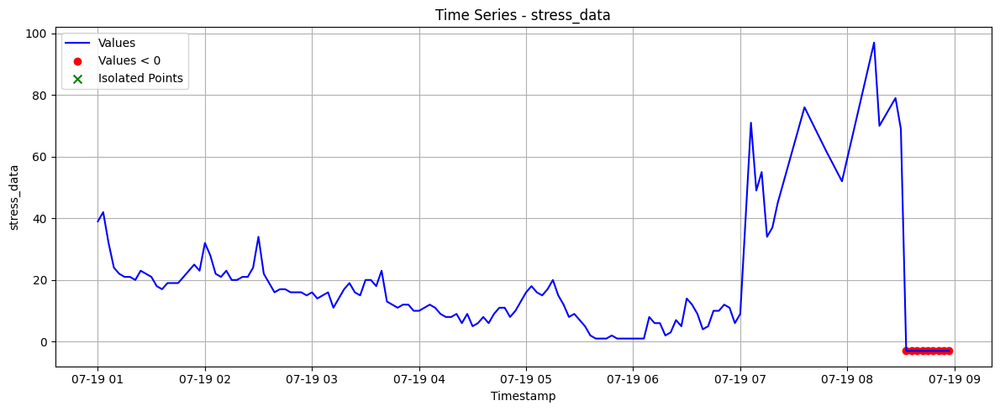

ADF Statistic:  -1.1749584974935017
P-Value:  0.6842741240632408
Critical Values:
	1%: -3.47
	5%: -2.88
	10%: -2.58
number of differentiation: 1


  0%|          | 0/18 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

  6%|▌         | 1/18 [00:11<03:22, 11.92s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/base/

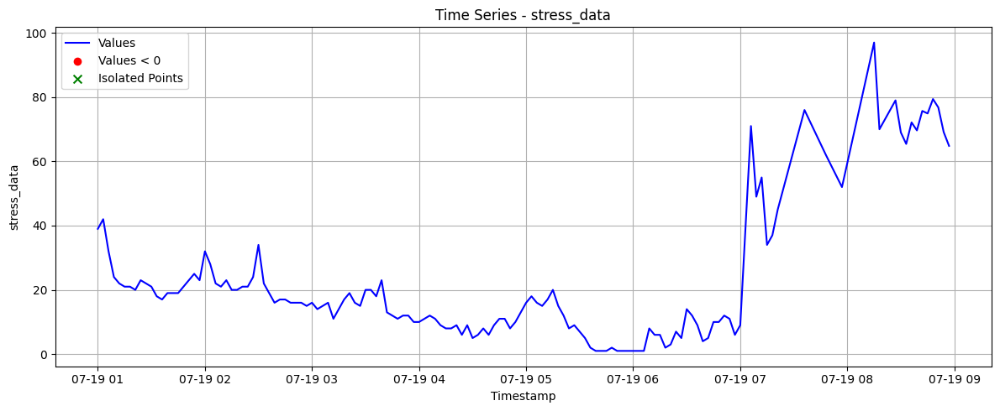




patient 33 have null values





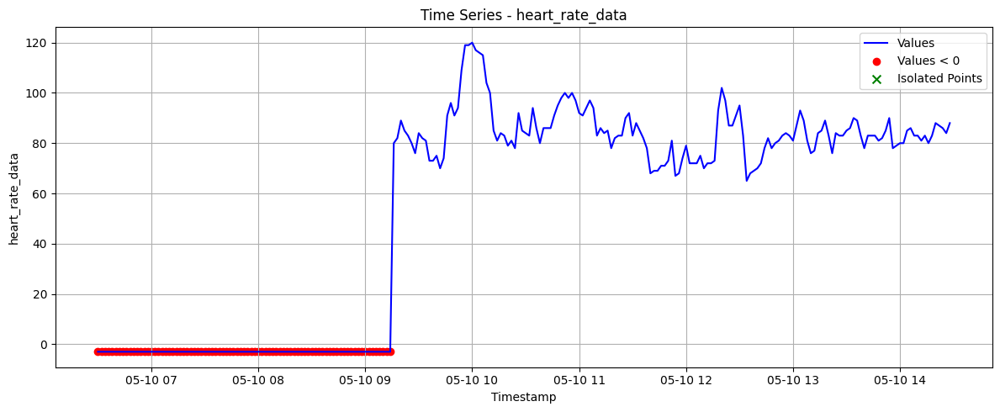

ADF Statistic:  -4.08532192661162
P-Value:  0.0010240685093538503
Critical Values:
	1%: -3.47
	5%: -2.88
	10%: -2.58
number of differentiation: 0


  0%|          | 0/7 [00:00<?, ?it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

 43%|████▎     | 3/7 [00:02<00:03,  1.09it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 57%|█████▋    | 4/7 [00:07<00:07,  2.47s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using z

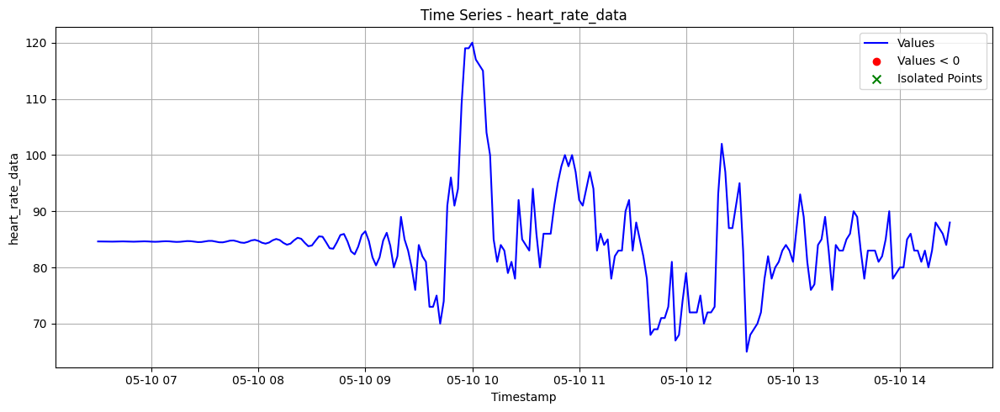

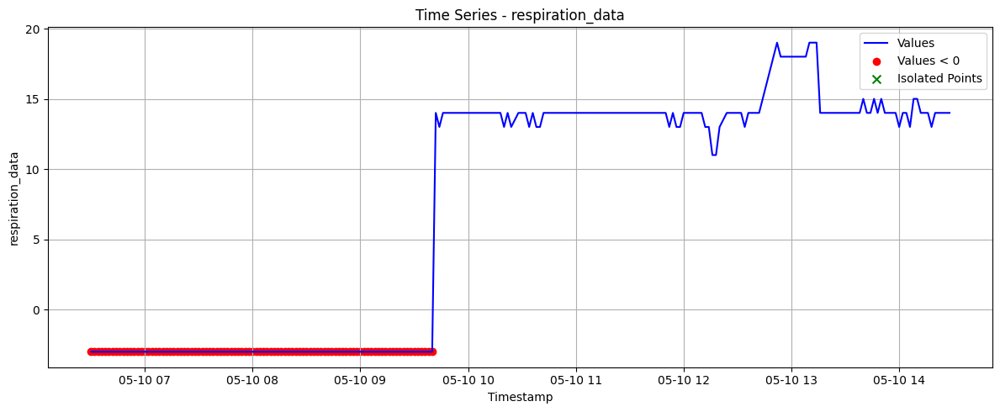

ADF Statistic:  -3.1119727379088795
P-Value:  0.02567974679183537
Critical Values:
	1%: -3.48
	5%: -2.88
	10%: -2.58
number of differentiation: 0


 11%|█         | 2/19 [00:06<00:50,  2.99s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

 16%|█▌        | 3/19 [00:09<00:49,  3.10s/it]/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespac

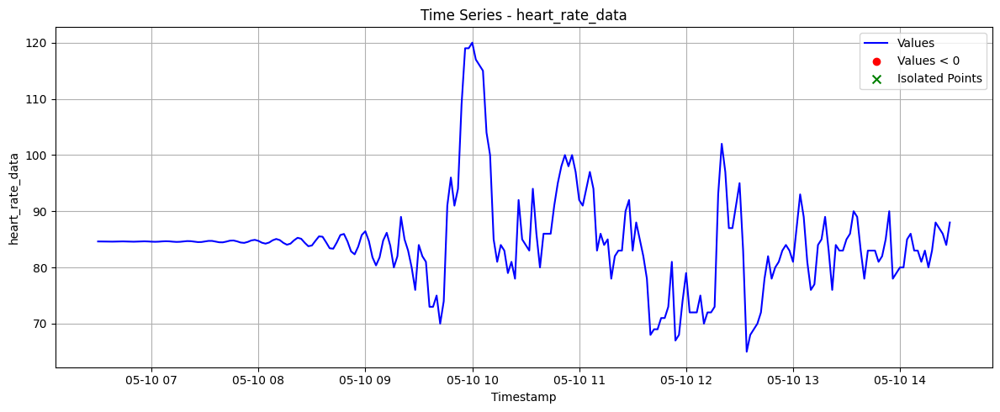

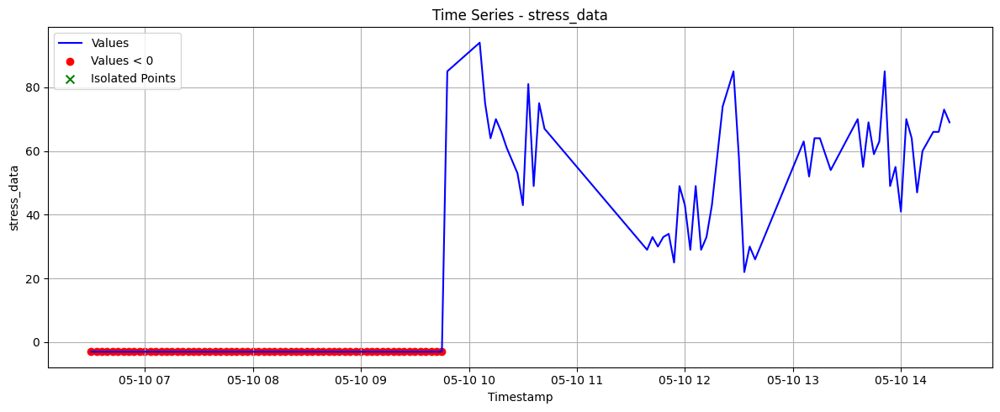

ADF Statistic:  -2.774056001416493
P-Value:  0.06207631189883694
Critical Values:
	1%: -3.50
	5%: -2.89
	10%: -2.58
number of differentiation: 1


 20%|██        | 1/5 [00:00<00:00,  6.93it/s]/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.11/dist-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

100%|██████████| 5/5 [00:00<00:00,  6.14it/s]


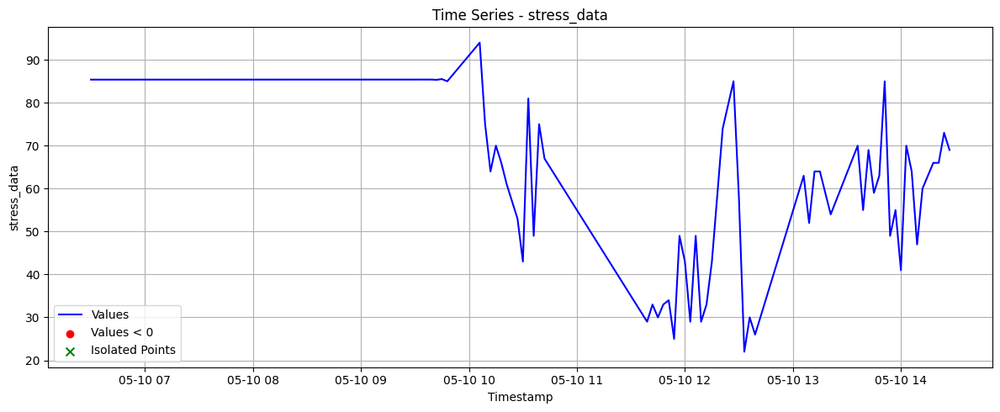

In [ ]:
#41 minutes required

full_inference_series=[None] * len(extracted_series_full_linear_inference)


i=0

for hr_df, bpm_db, stress_df in extracted_series_full_linear_inference:

  hr_requires_ARIMA=(hr_df['heart_rate_data']<=0).any()
  bpm_requires_ARIMA=(bpm_db['respiration_data']<=0).any()
  stress_requires_ARIMA=(stress_df['stress_data']<=0).any()

  if hr_requires_ARIMA or bpm_requires_ARIMA or stress_requires_ARIMA:
    print(f'\n\n\npatient {i} have null values\n\n\n')

  if hr_requires_ARIMA:
    disp_df=extracted_series_full_linear_inference[i][0].copy()
    plot_time_series_with_negatives(disp_df)
    new_hr=apply_arima(disp_df, False)
    plot_time_series_with_negatives(new_hr)
  else:
    new_hr=hr_df.copy()

  if bpm_requires_ARIMA:
    disp_df=extracted_series_full_linear_inference[i][1].copy()
    plot_time_series_with_negatives(disp_df)
    new_bpm=apply_arima(disp_df, False)
    plot_time_series_with_negatives(new_hr)
  else:
    new_bpm=bpm_db.copy()

  if stress_requires_ARIMA:
    disp_df=extracted_series_full_linear_inference[i][2].copy()
    plot_time_series_with_negatives(disp_df)
    new_stress=apply_arima(disp_df, False)
    plot_time_series_with_negatives(new_stress)
  else:
    new_stress=stress_df.copy()

  full_inference_series[i]=(new_hr, new_bpm, new_stress)

  i+=1




In [ ]:
with open('/content/drive/MyDrive/LL2/full_inference_series.pkl', 'wb') as f:
  pickle.dump(full_inference_series, f)

In [ ]:
i=0
for hr_df, bpm_db, stress_df in full_inference_series:

  hr_requires_ARIMA=(hr_df['heart_rate_data']<=0).any()
  bpm_requires_ARIMA=(bpm_db['respiration_data']<=0).any()
  stress_requires_ARIMA=(stress_df['stress_data']<=0).any()

  if hr_requires_ARIMA or bpm_requires_ARIMA or stress_requires_ARIMA:
    print(f'\n\n\npatient {i} have null values:')

  if hr_requires_ARIMA:
    print('in hr')

  if bpm_requires_ARIMA:
    print('in bpm')
  if stress_requires_ARIMA:
    print('in stress')
  i+=1

##Filtering

In [ ]:
def apply_lowpass_filter(df, timestamp_col, data_col, cutoff_freq, plot_results=True):
    """
    Apply a low-pass filter to a single time series in a pandas DataFrame.

    Args:
        df (pd.DataFrame): DataFrame containing the time series data.
        timestamp_col (str): Name of the column containing timestamps (in hh:mm:ss format).
        data_col (str): Name of the column containing the data to filter.
        cutoff_freq (float): Cutoff frequency in Hz.
        plot_results (bool, optional): Whether to plot the original and filtered signals. Defaults to True.

    Returns:
        pd.DataFrame: A copy of the input DataFrame with an additional column containing the filtered data.

    Raises:
        ValueError: If cutoff_freq is not positive.
    """
    # Create a copy of the DataFrame to avoid modifying the original
    result_df = df.copy()

    # Since timestamps are exactly every 2 minutes (120 seconds)
    sampling_interval = 120  # seconds
    fs = 1 / sampling_interval  # Hz = 1/120 Hz

    print(f"Sampling frequency: {fs:.6f} Hz (every {sampling_interval} seconds)")

    # Check if cutoff frequency is valid according to Nyquist criterion
    nyquist = fs / 2  # Nyquist frequency = fs/2 = 1/240 Hz
    if cutoff_freq >= nyquist:
        raise ValueError(f"Cutoff frequency ({cutoff_freq} Hz) must be less than Nyquist frequency ({nyquist} Hz)")

    # Design a Butterworth low-pass filter
    # Normalize cutoff frequency by the Nyquist frequency
    normalized_cutoff = cutoff_freq / nyquist

    # Create a 4th order Butterworth filter
    # The butter function returns two arrays: b (numerator coefficients) and a (denominator coefficients)
    # These coefficients define the filter's transfer function H(z) = B(z)/A(z)
    b, a = signal.butter(4, normalized_cutoff, 'low')

    # Apply the filter using filtfilt (zero-phase filtering)
    # filtfilt applies the filter twice, once forward and once backward
    # This eliminates phase distortion and effectively doubles the filter order (to 8th order)
    filtered_data = signal.filtfilt(b, a, df[data_col].values)

    # Add filtered data to the result DataFrame
    result_df[data_col] = filtered_data

    # Plot original and filtered signals if requested
    if plot_results:
        plt.figure(figsize=(12, 6))
        plt.plot(df[timestamp_col], df[data_col], 'b-', alpha=0.5, label='Original Signal')
        plt.plot(df[timestamp_col], filtered_data, 'r-', label='Filtered Signal')
        plt.title(f'Low-Pass Filter (cutoff: {cutoff_freq:.6f} Hz)')
        plt.xlabel('Time')
        plt.ylabel(data_col)
        plt.legend()
        plt.grid(True)
        plt.show()

    return result_df

Sampling frequency: 0.008333 Hz (every 120 seconds)


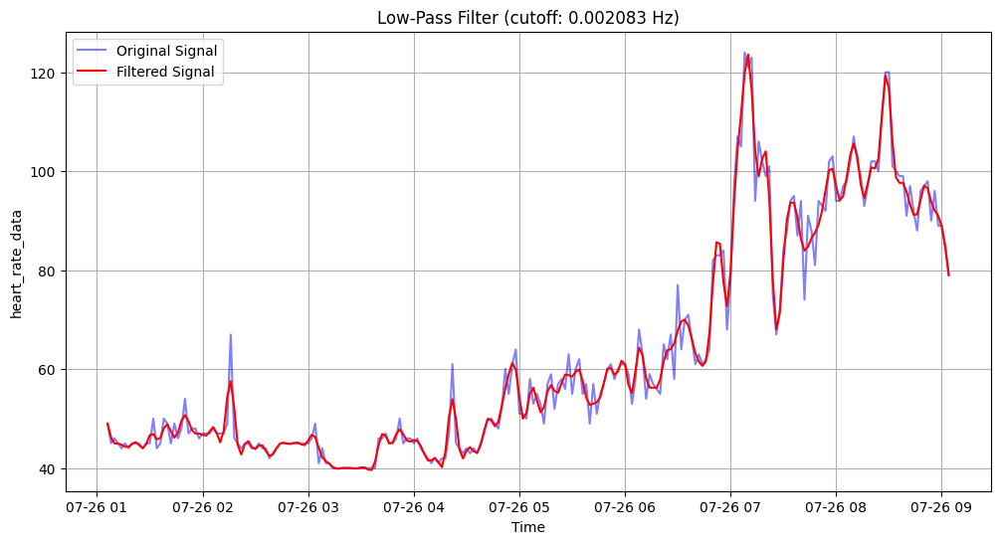

Sampling frequency: 0.008333 Hz (every 120 seconds)


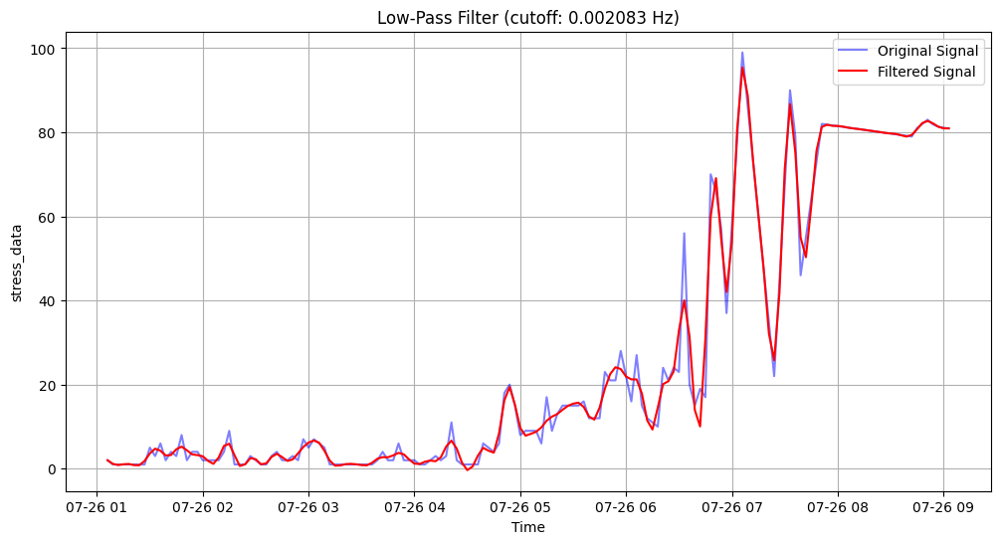

Sampling frequency: 0.008333 Hz (every 120 seconds)


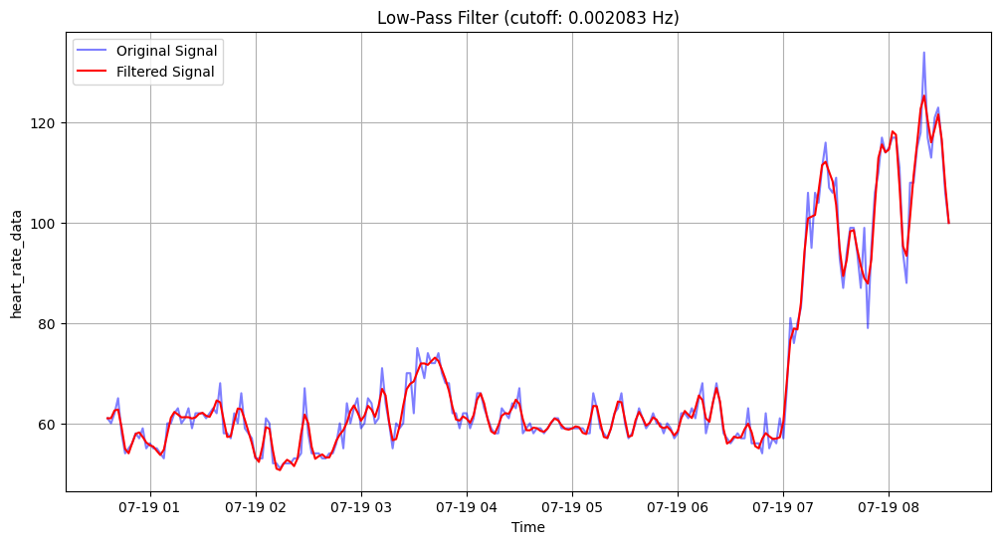

Sampling frequency: 0.008333 Hz (every 120 seconds)


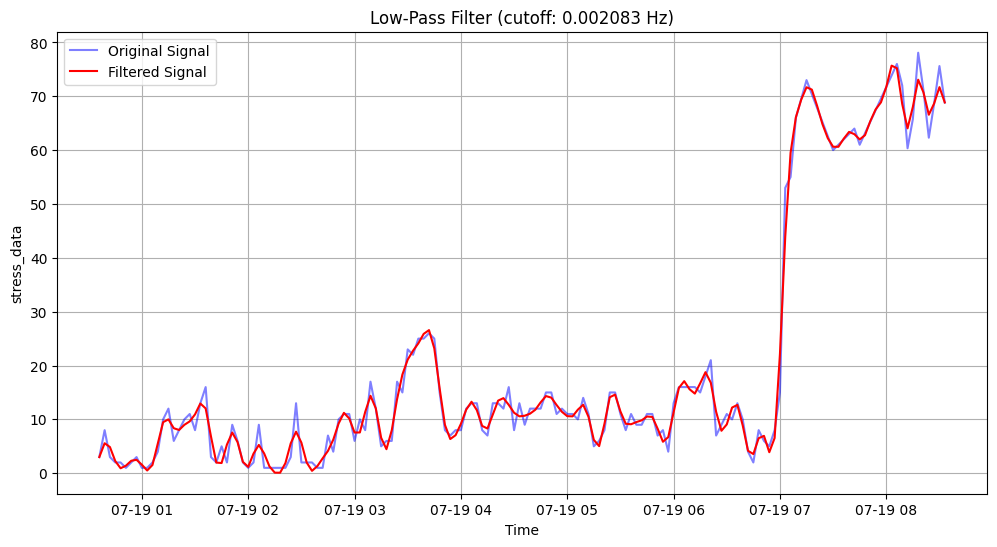

Sampling frequency: 0.008333 Hz (every 120 seconds)


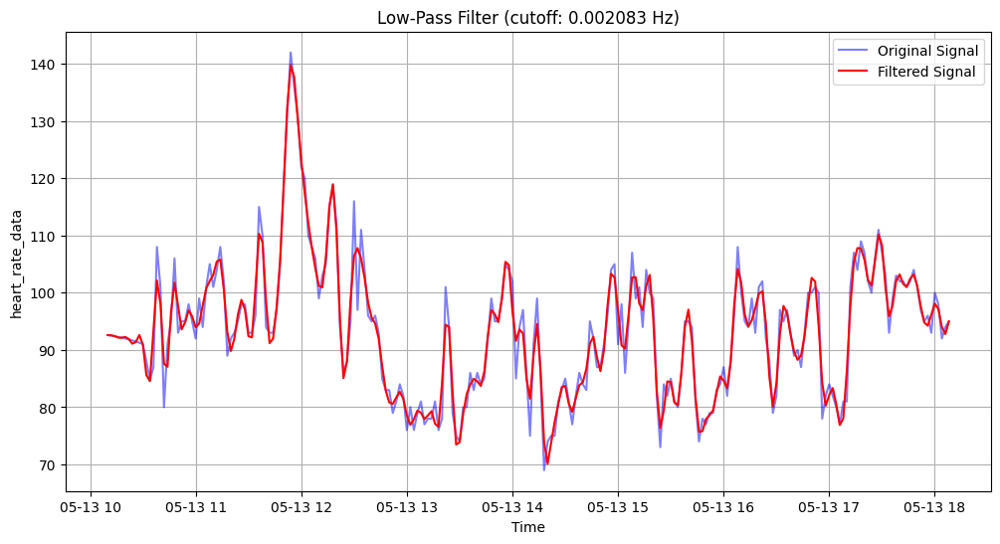

Sampling frequency: 0.008333 Hz (every 120 seconds)


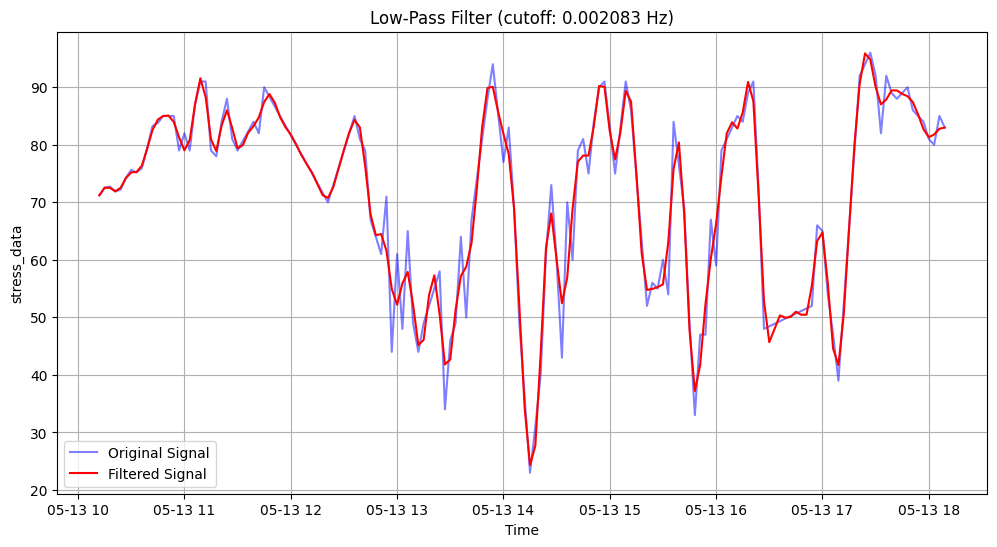

Sampling frequency: 0.008333 Hz (every 120 seconds)


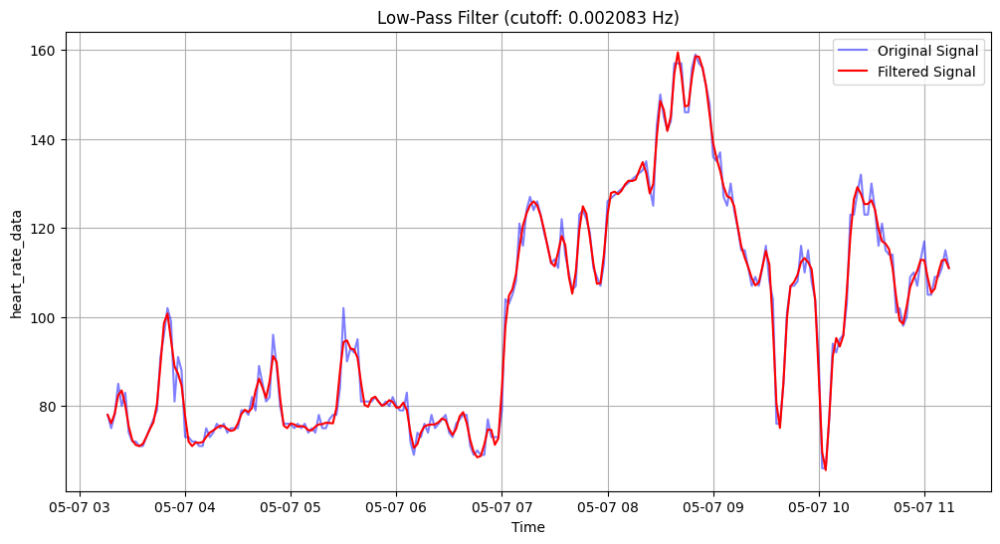

Sampling frequency: 0.008333 Hz (every 120 seconds)


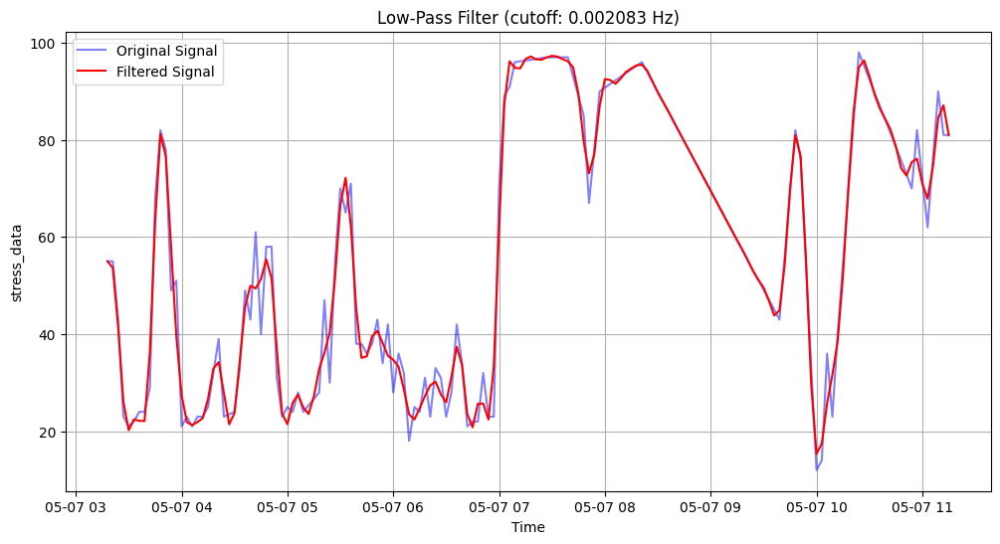

Sampling frequency: 0.008333 Hz (every 120 seconds)


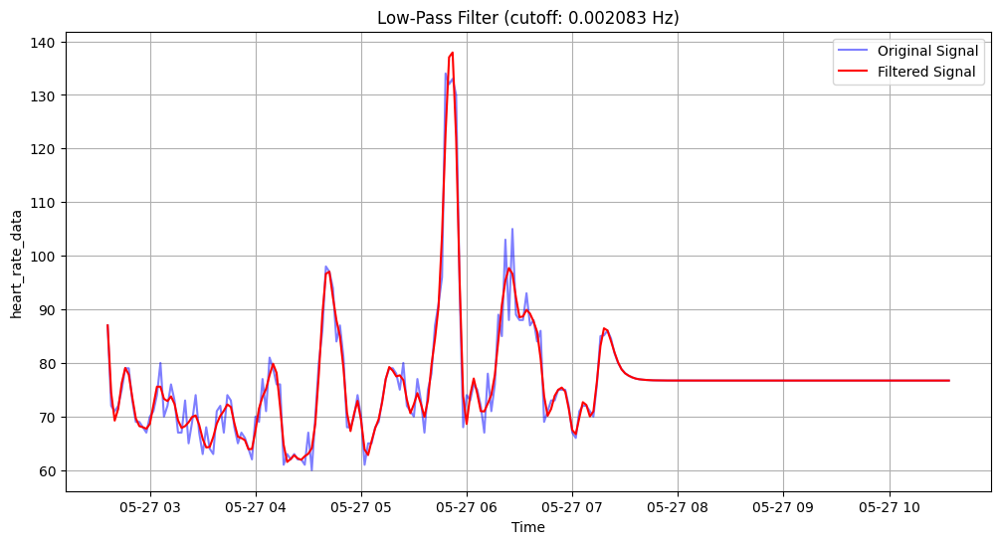

Sampling frequency: 0.008333 Hz (every 120 seconds)


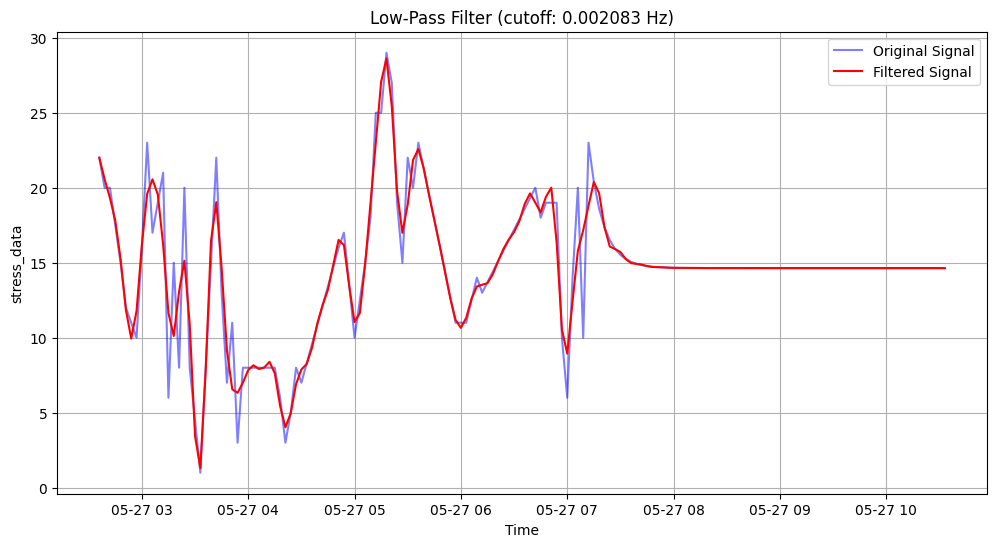

Sampling frequency: 0.008333 Hz (every 120 seconds)


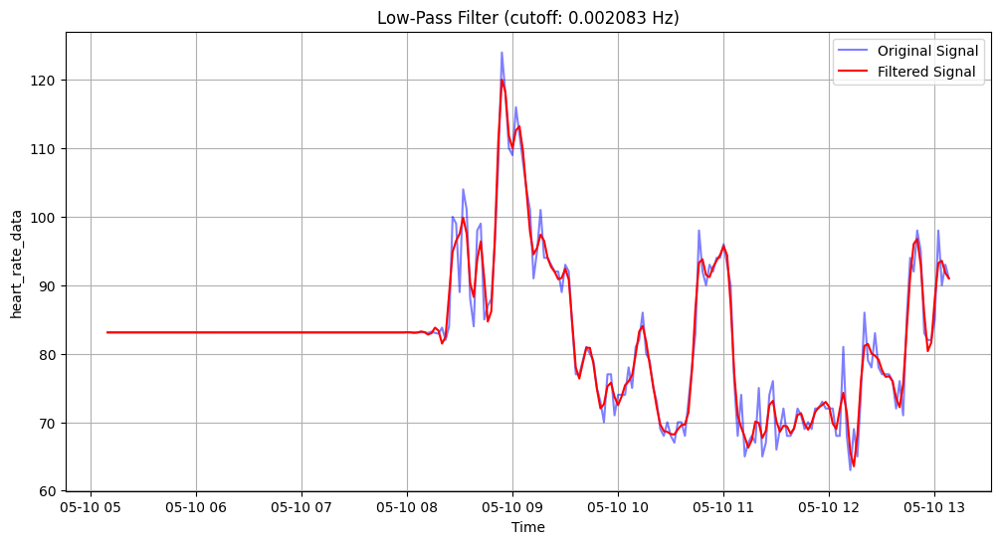

Sampling frequency: 0.008333 Hz (every 120 seconds)


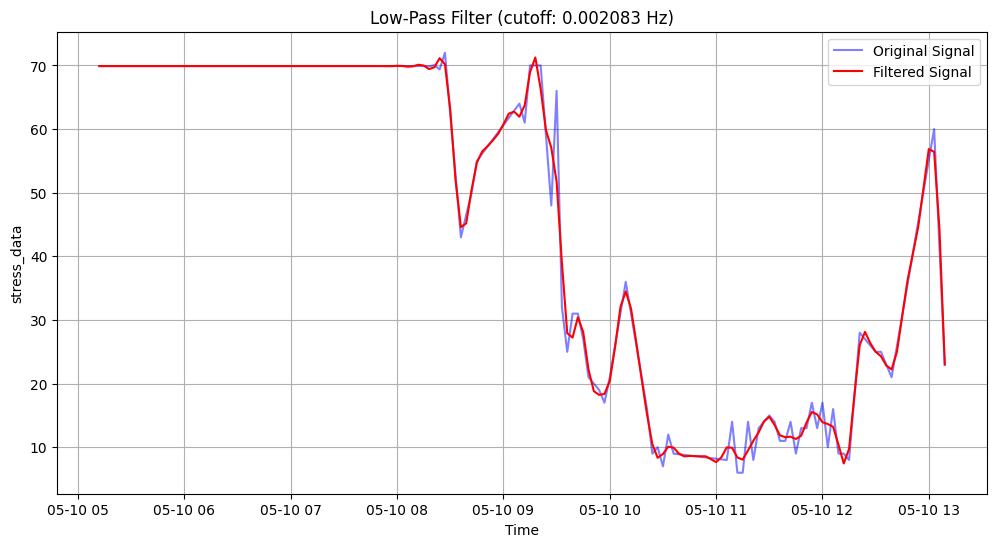

Sampling frequency: 0.008333 Hz (every 120 seconds)


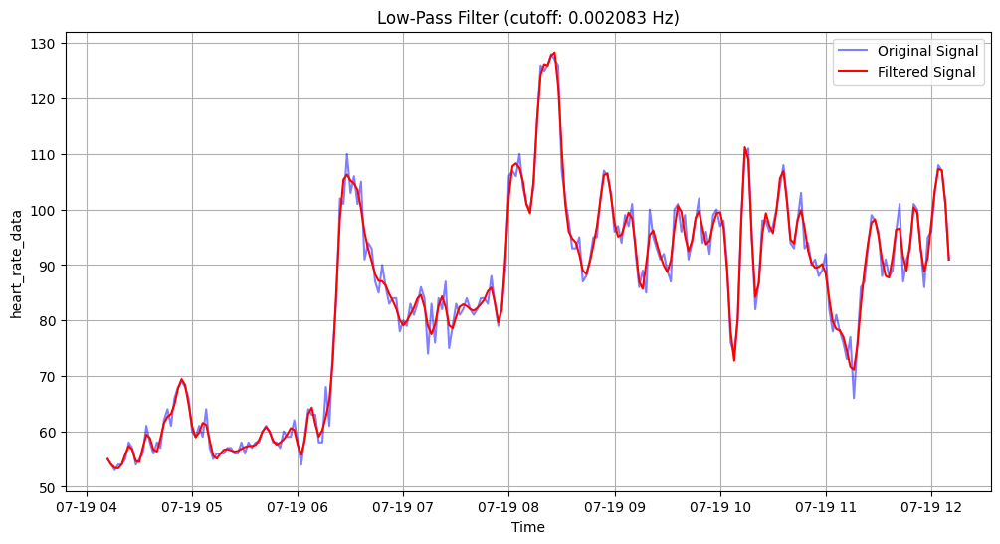

Sampling frequency: 0.008333 Hz (every 120 seconds)


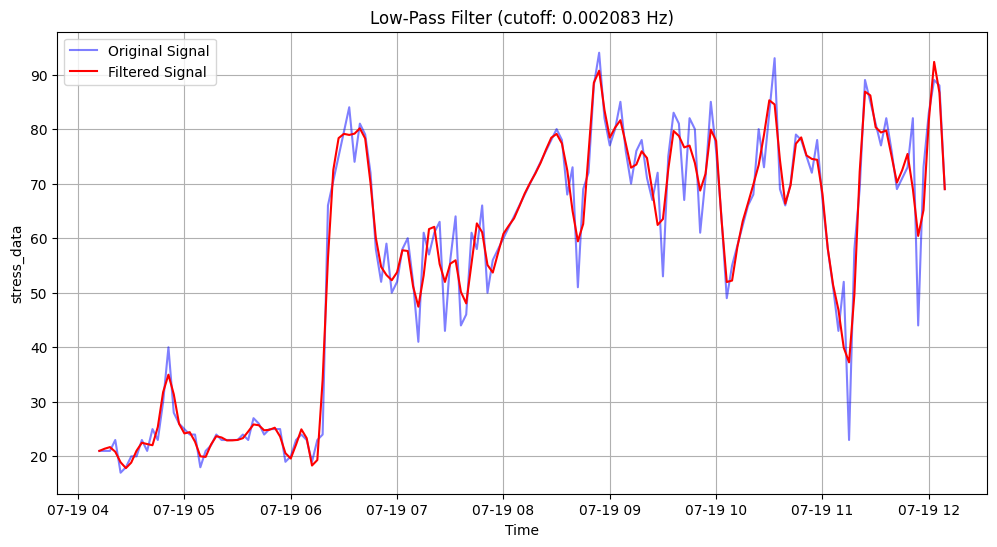

Sampling frequency: 0.008333 Hz (every 120 seconds)


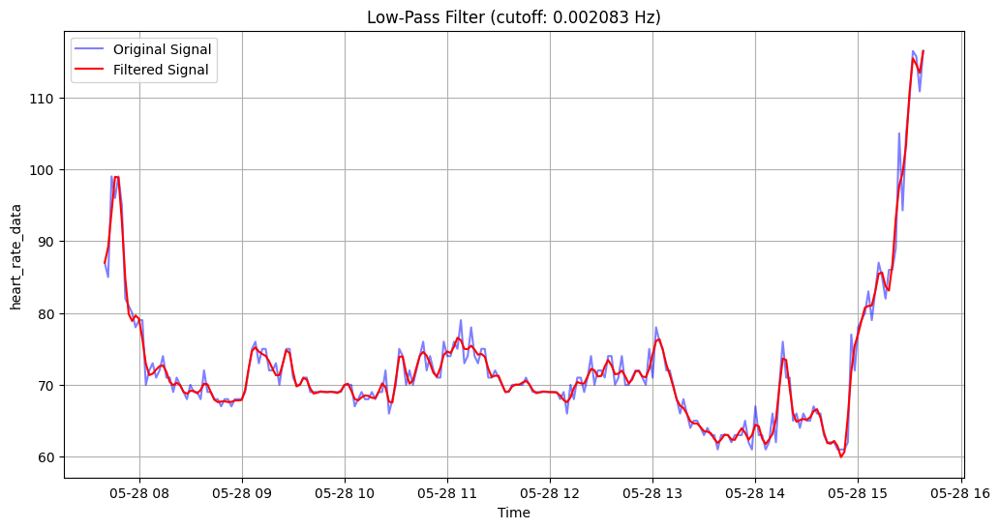

Sampling frequency: 0.008333 Hz (every 120 seconds)


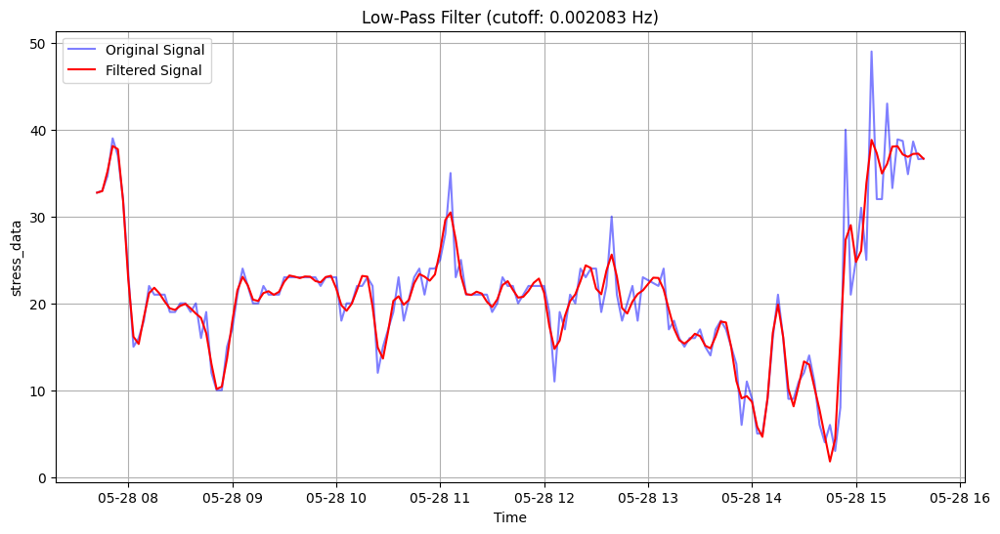

Sampling frequency: 0.008333 Hz (every 120 seconds)


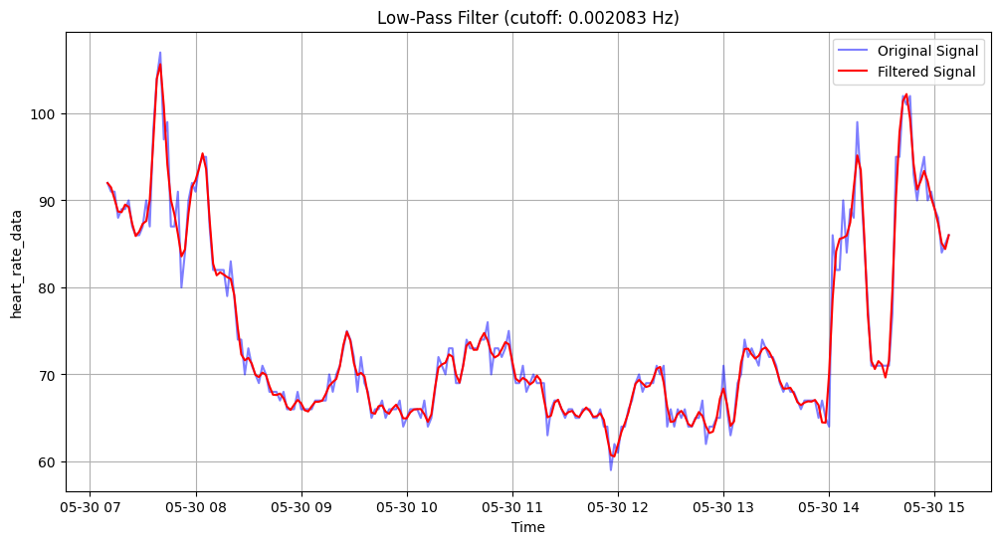

Sampling frequency: 0.008333 Hz (every 120 seconds)


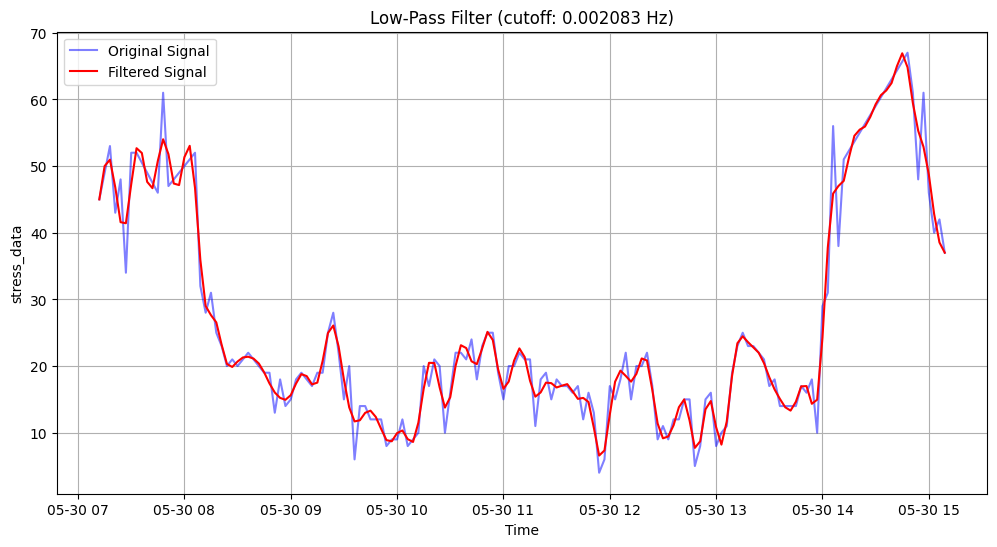

Sampling frequency: 0.008333 Hz (every 120 seconds)


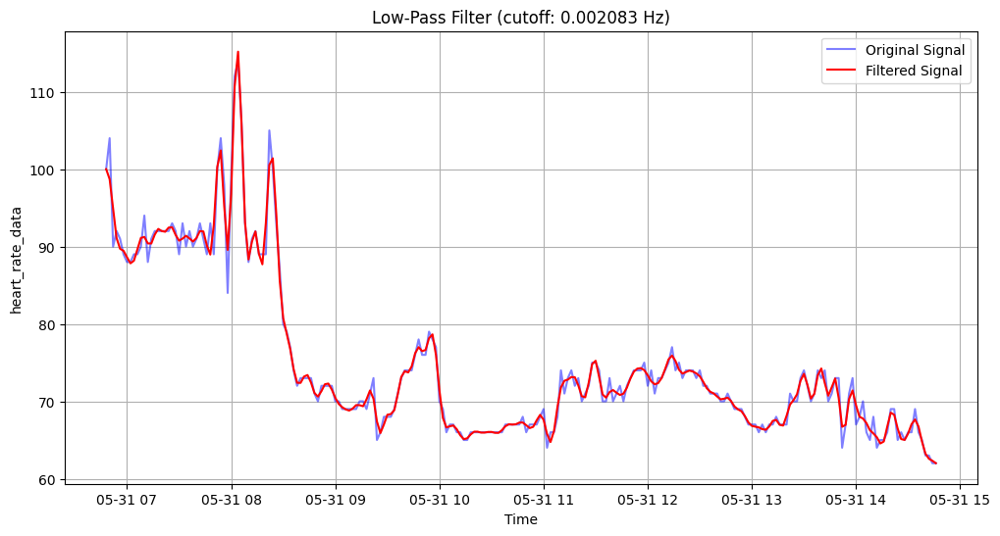

Sampling frequency: 0.008333 Hz (every 120 seconds)


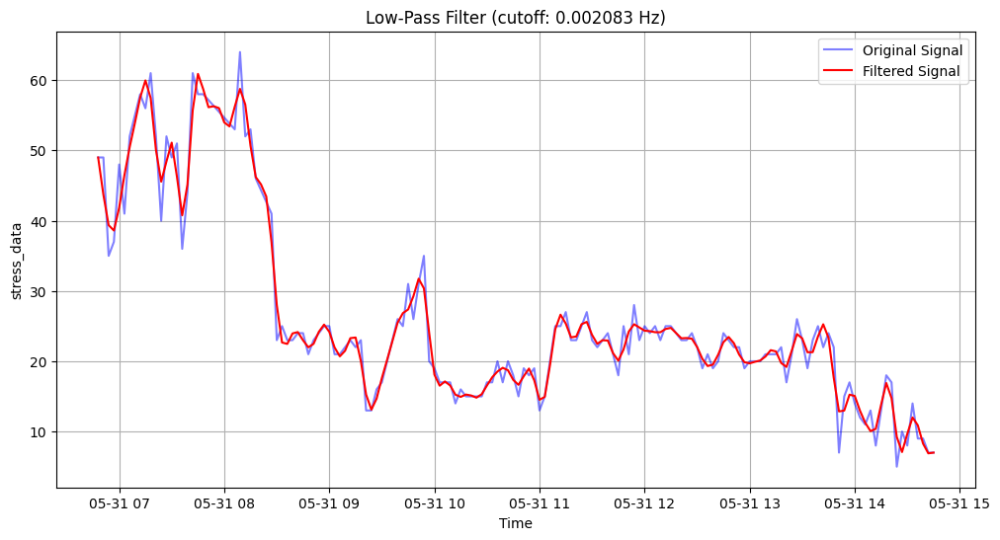

Sampling frequency: 0.008333 Hz (every 120 seconds)


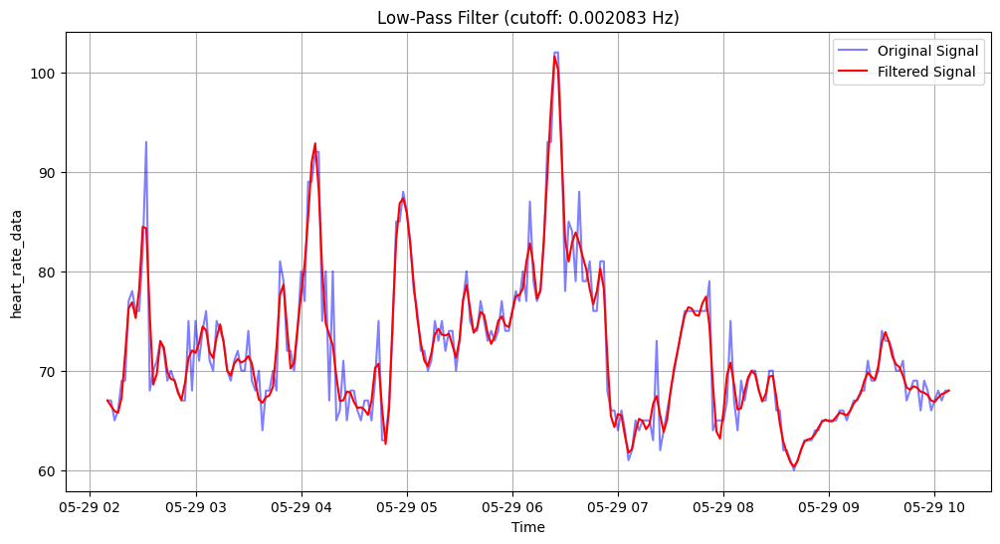

Sampling frequency: 0.008333 Hz (every 120 seconds)


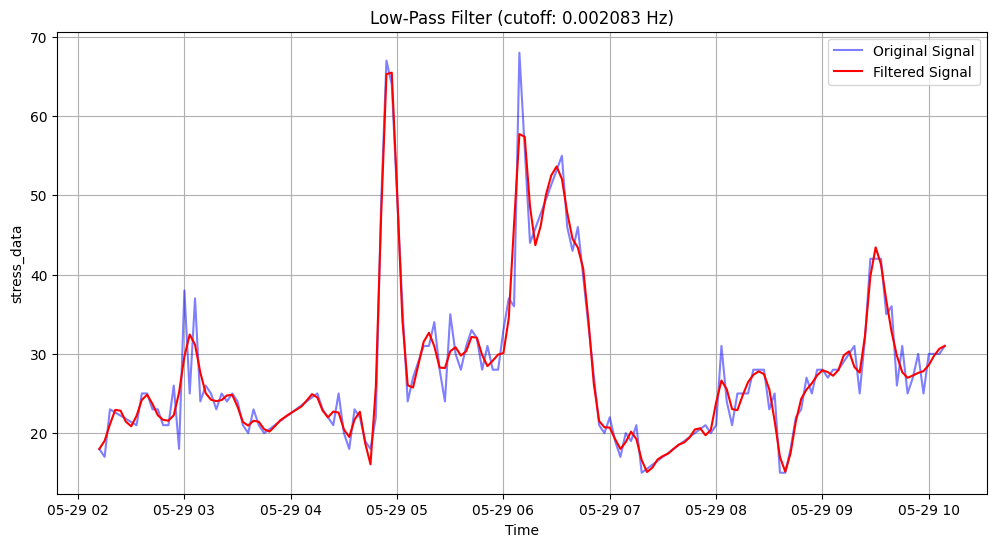

Sampling frequency: 0.008333 Hz (every 120 seconds)


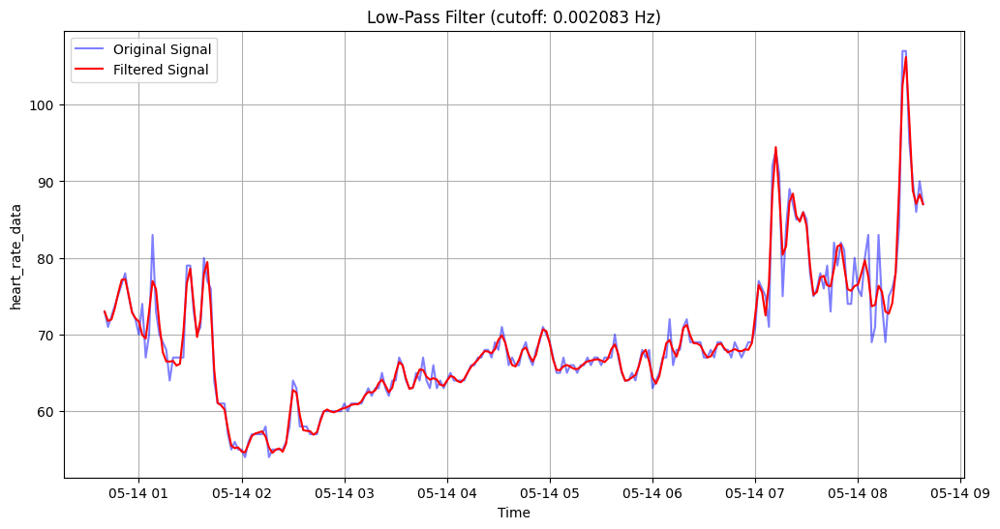

Sampling frequency: 0.008333 Hz (every 120 seconds)


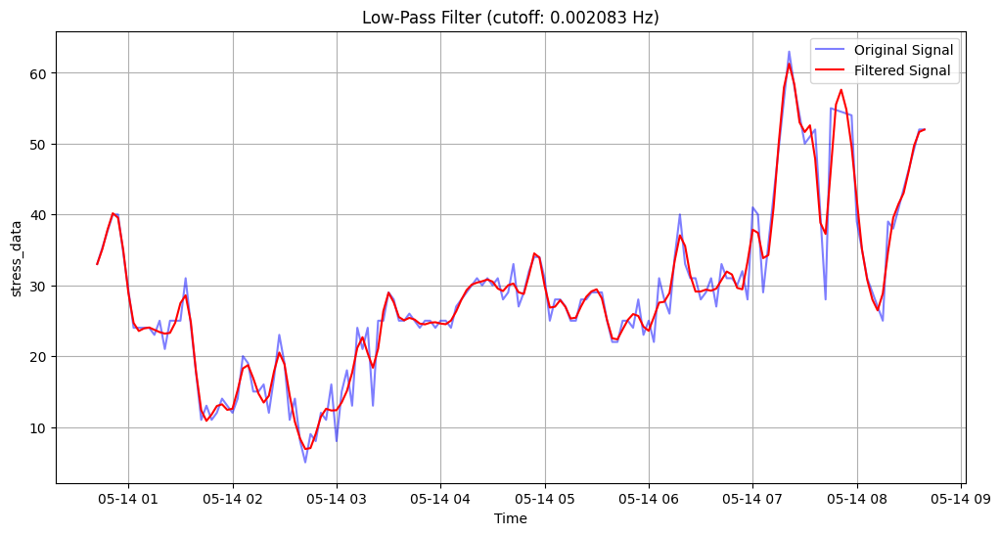

Sampling frequency: 0.008333 Hz (every 120 seconds)


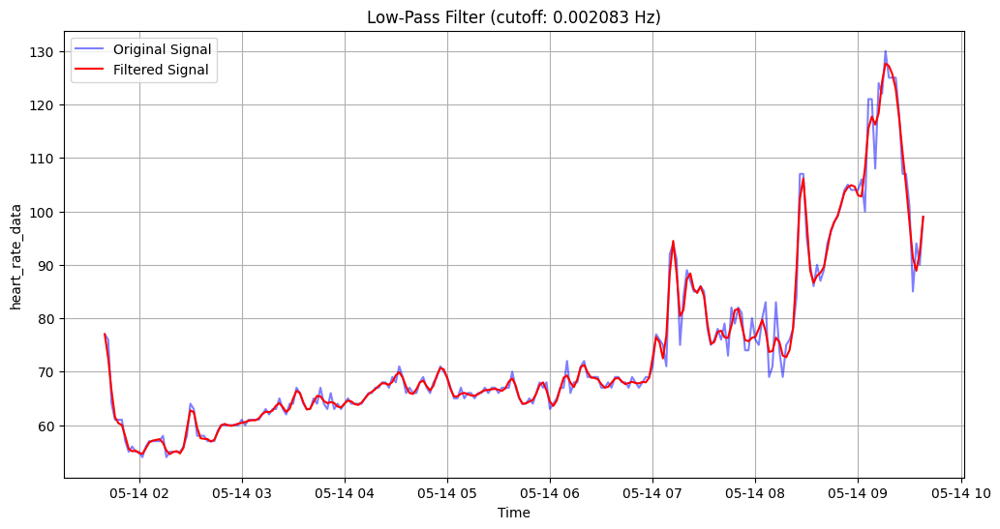

Sampling frequency: 0.008333 Hz (every 120 seconds)


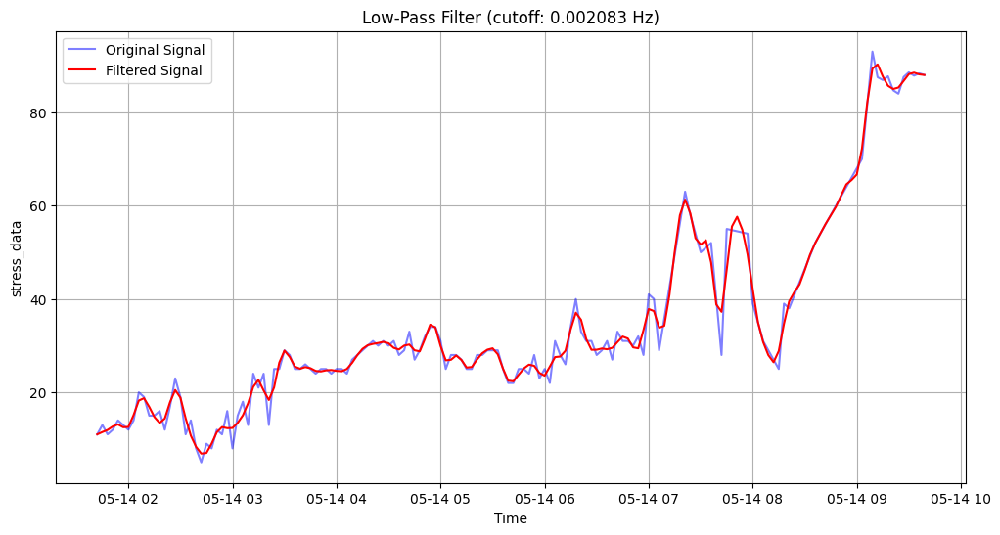

Sampling frequency: 0.008333 Hz (every 120 seconds)


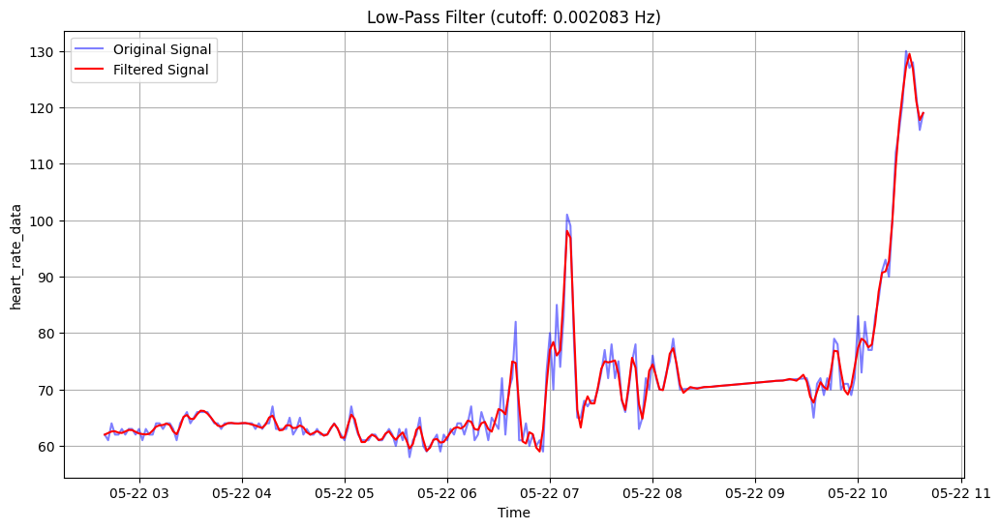

Sampling frequency: 0.008333 Hz (every 120 seconds)


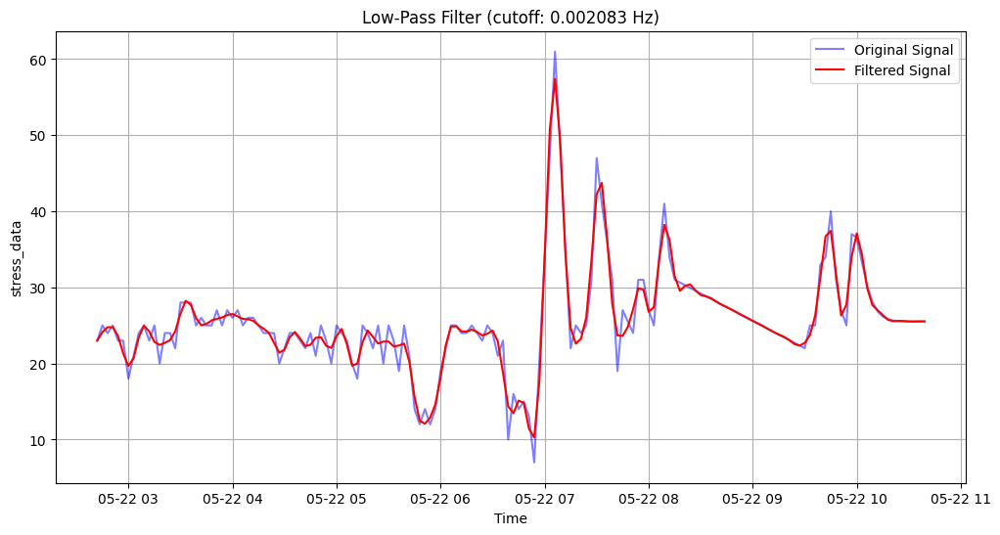

Sampling frequency: 0.008333 Hz (every 120 seconds)


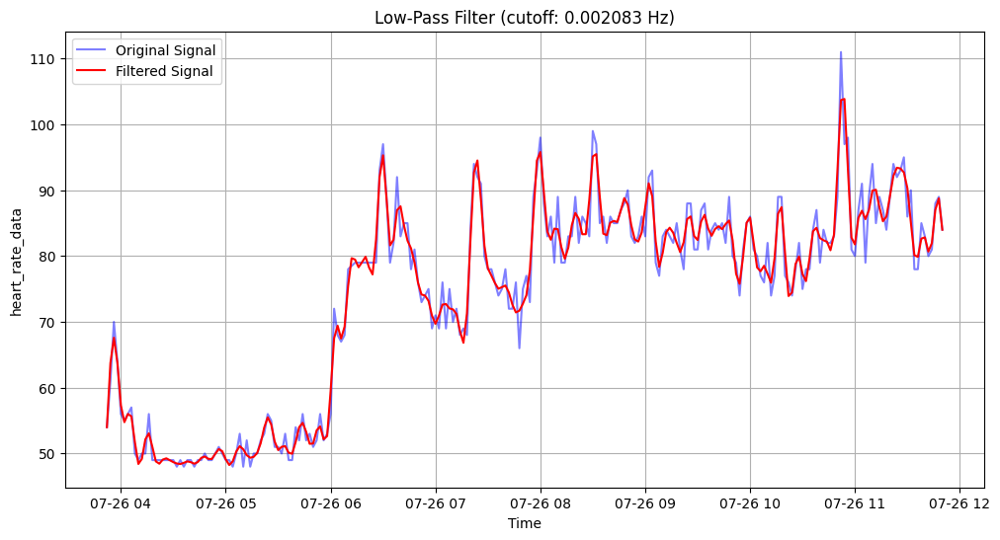

Sampling frequency: 0.008333 Hz (every 120 seconds)


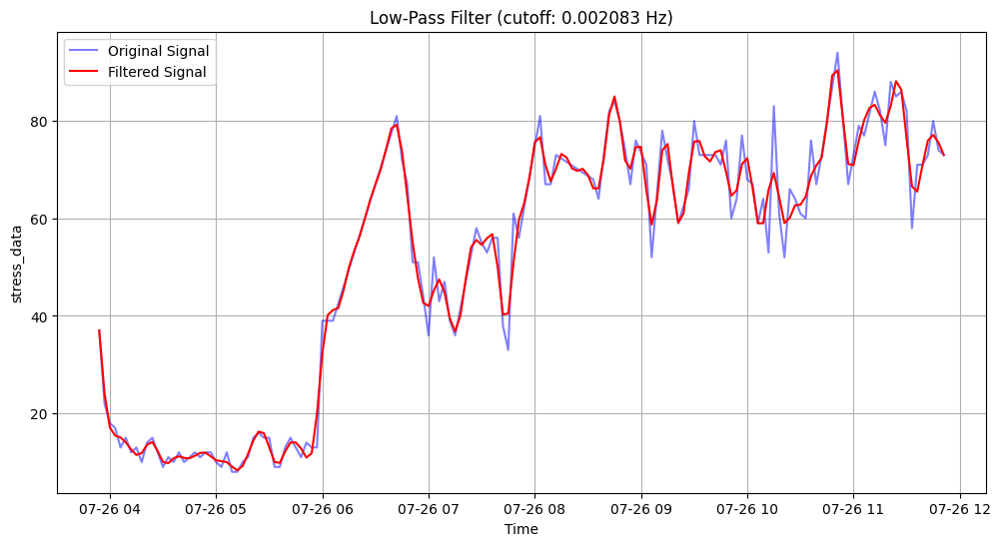

Sampling frequency: 0.008333 Hz (every 120 seconds)


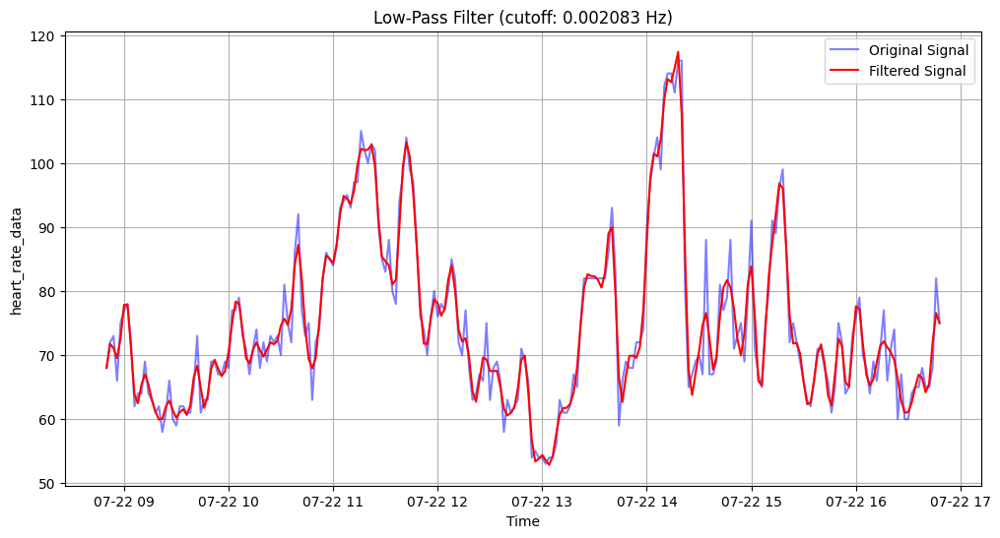

Sampling frequency: 0.008333 Hz (every 120 seconds)


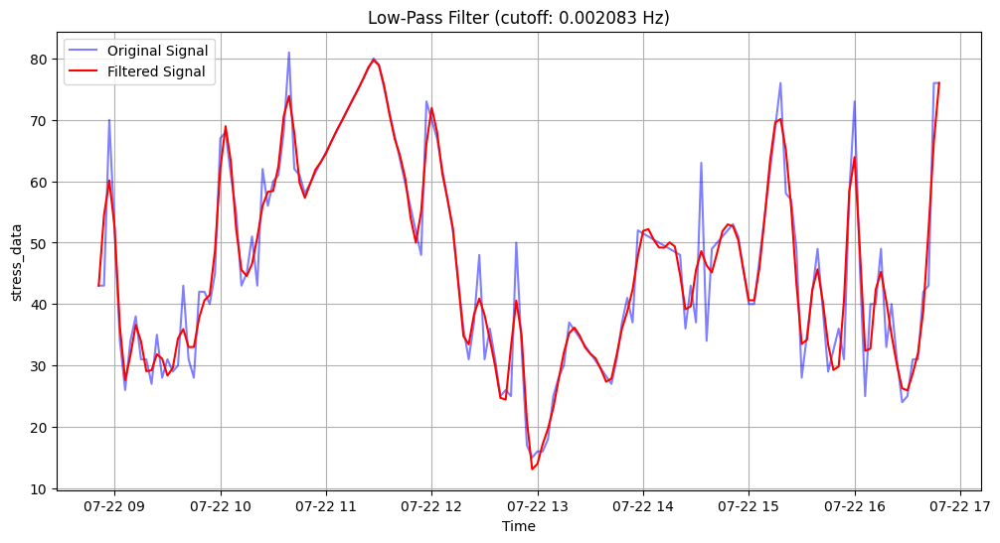

Sampling frequency: 0.008333 Hz (every 120 seconds)


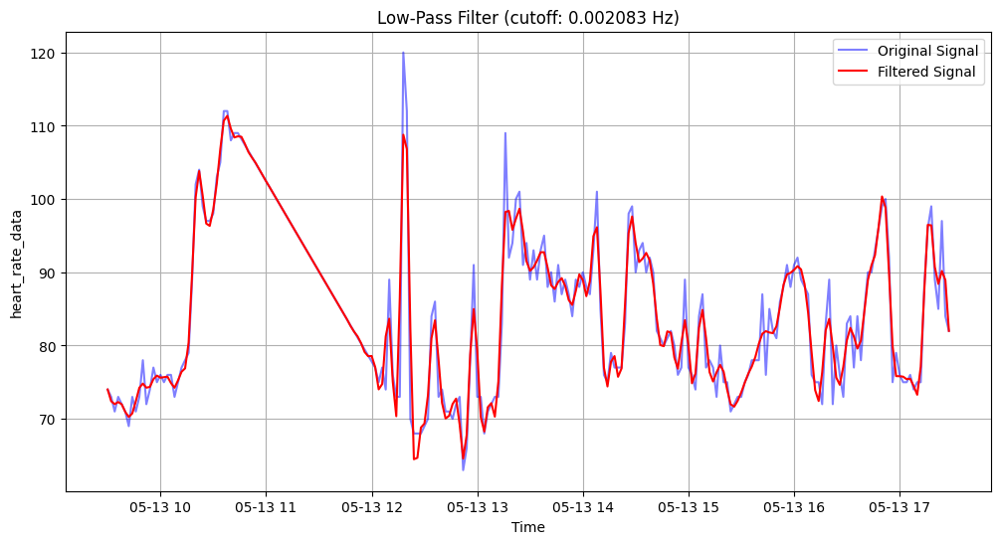

Sampling frequency: 0.008333 Hz (every 120 seconds)


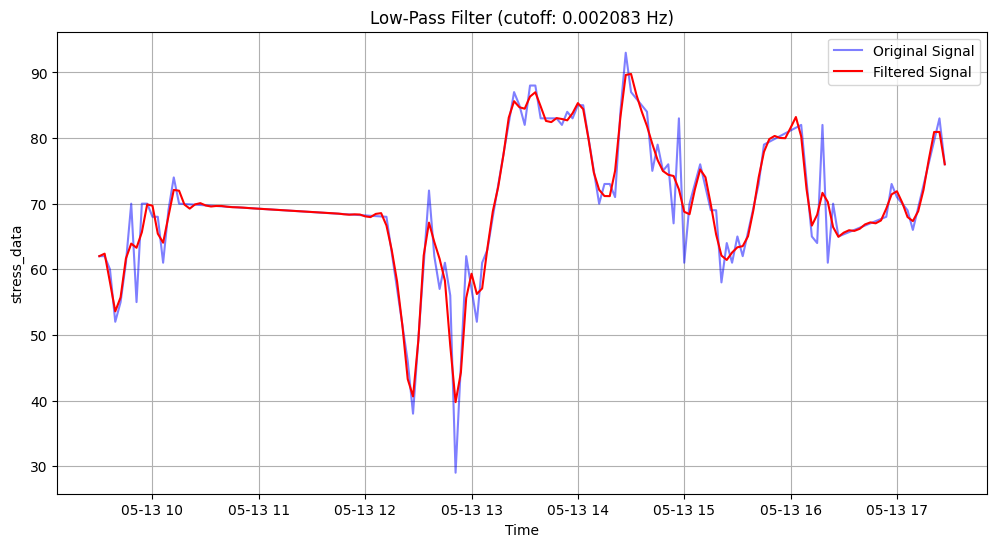

Sampling frequency: 0.008333 Hz (every 120 seconds)


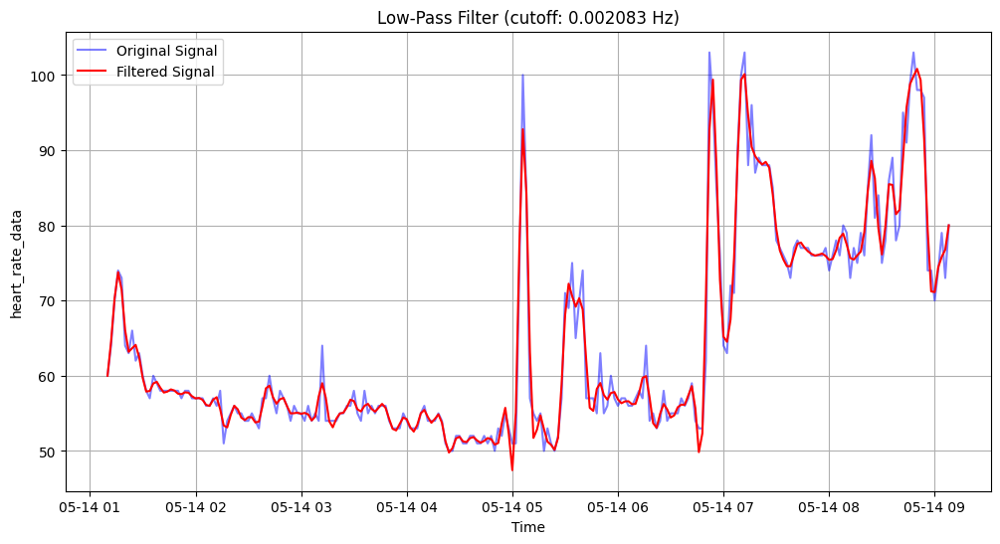

Sampling frequency: 0.008333 Hz (every 120 seconds)


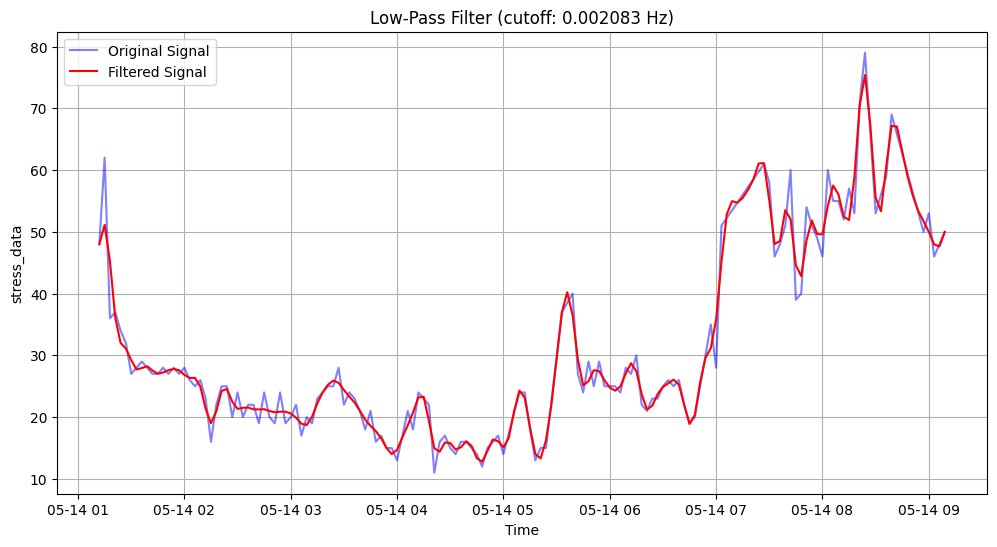

Sampling frequency: 0.008333 Hz (every 120 seconds)


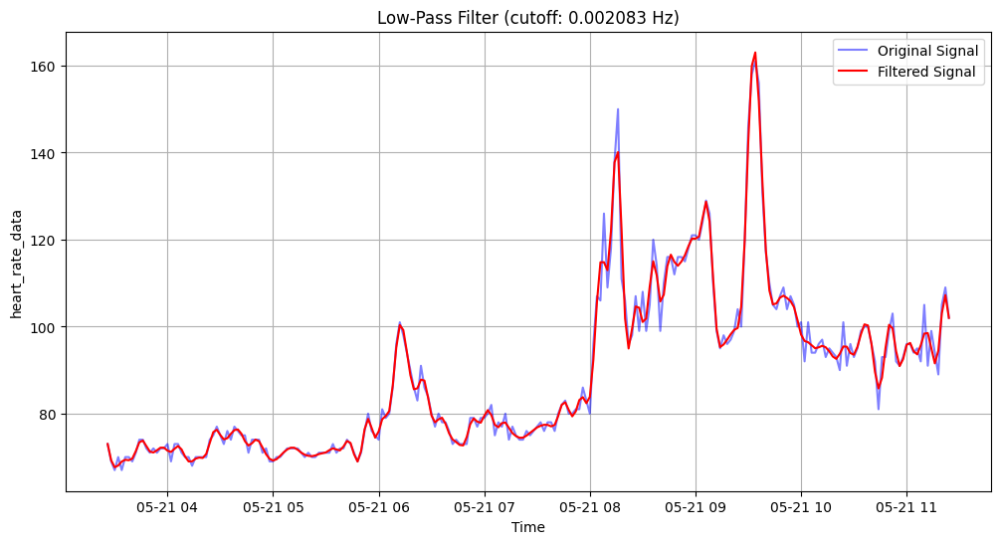

Sampling frequency: 0.008333 Hz (every 120 seconds)


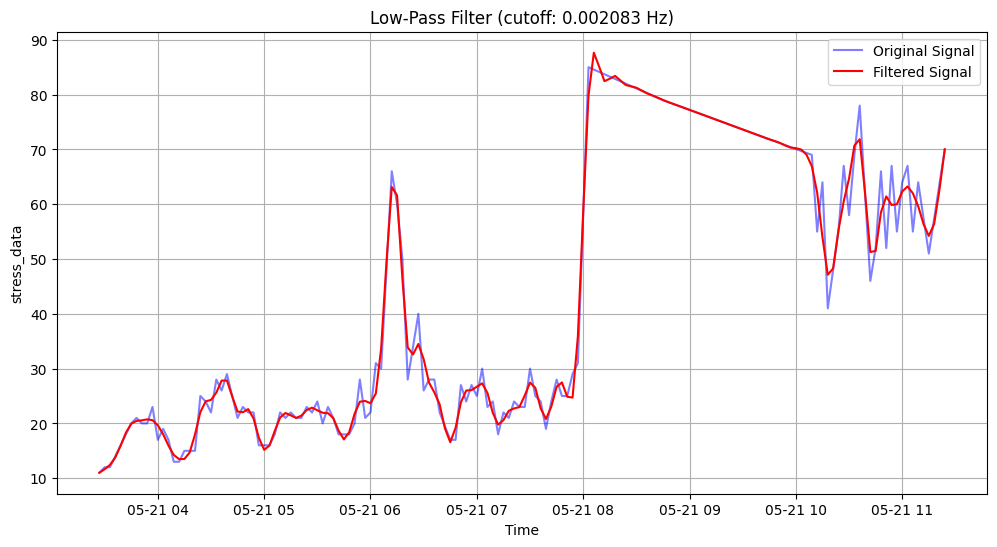

Sampling frequency: 0.008333 Hz (every 120 seconds)


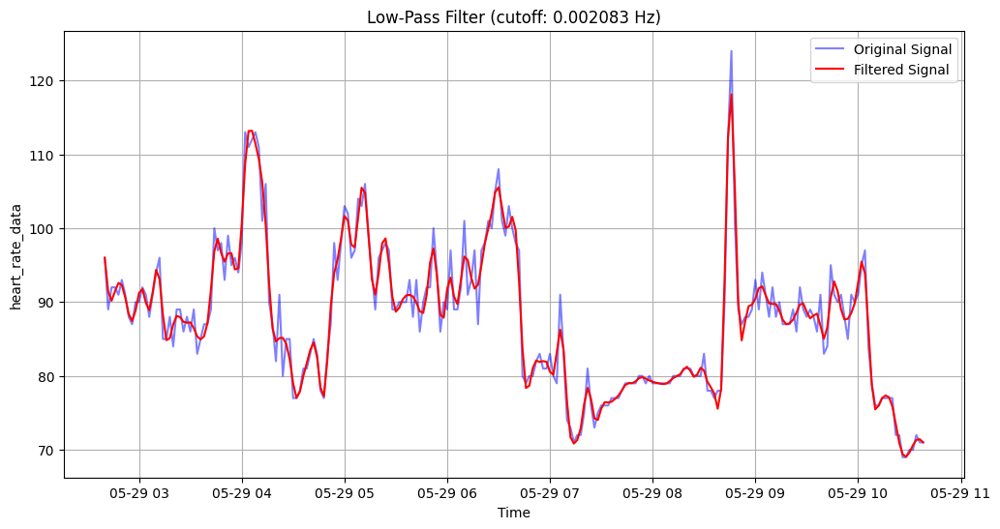

Sampling frequency: 0.008333 Hz (every 120 seconds)


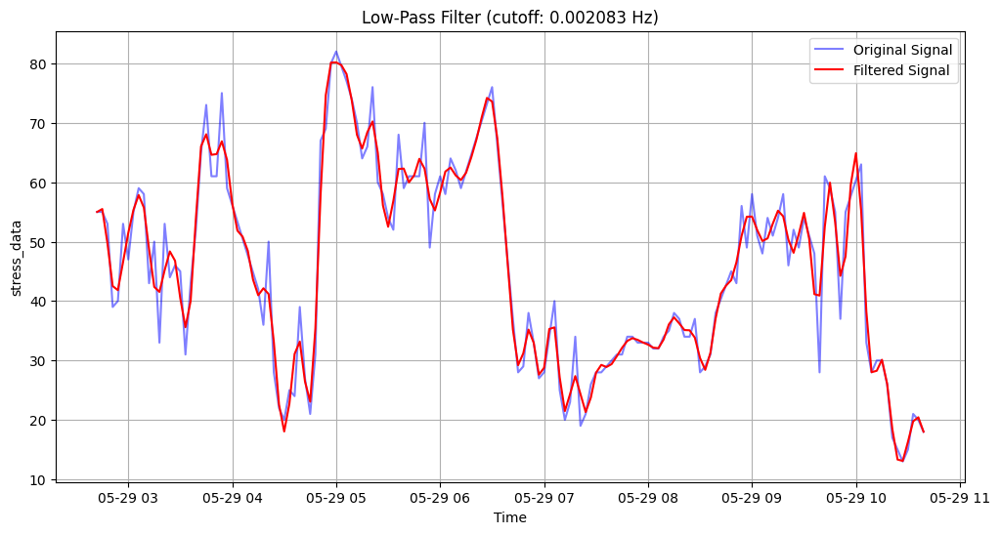

Sampling frequency: 0.008333 Hz (every 120 seconds)


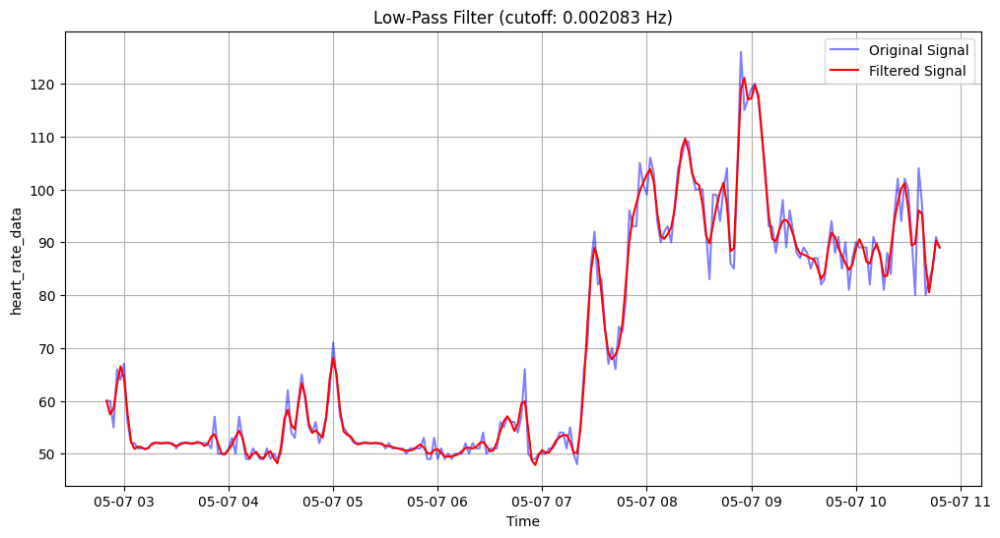

Sampling frequency: 0.008333 Hz (every 120 seconds)


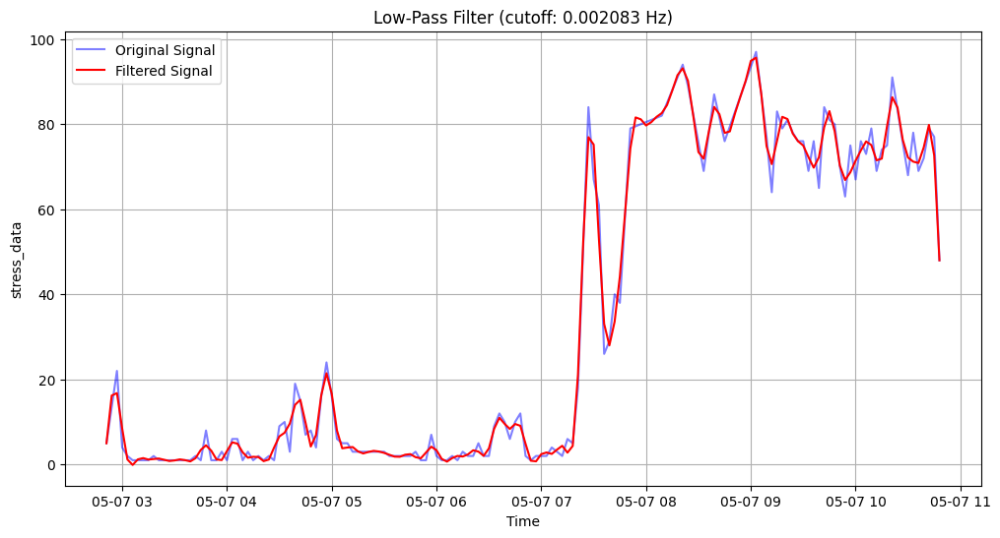

Sampling frequency: 0.008333 Hz (every 120 seconds)


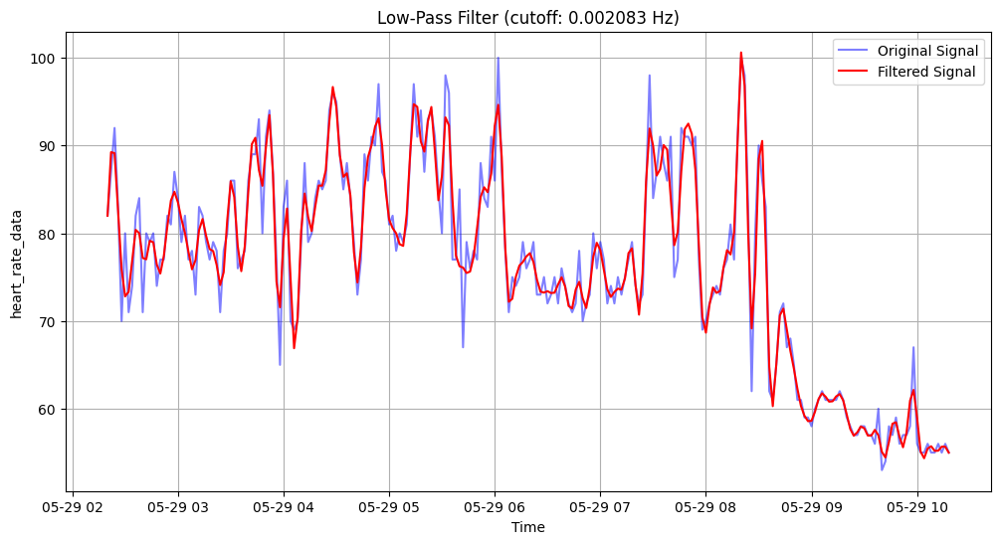

Sampling frequency: 0.008333 Hz (every 120 seconds)


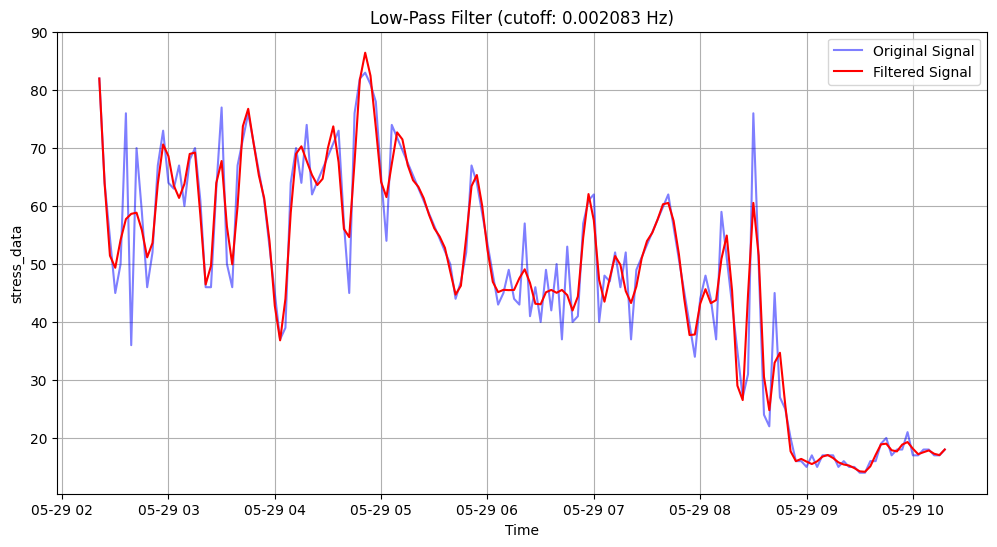

Sampling frequency: 0.008333 Hz (every 120 seconds)


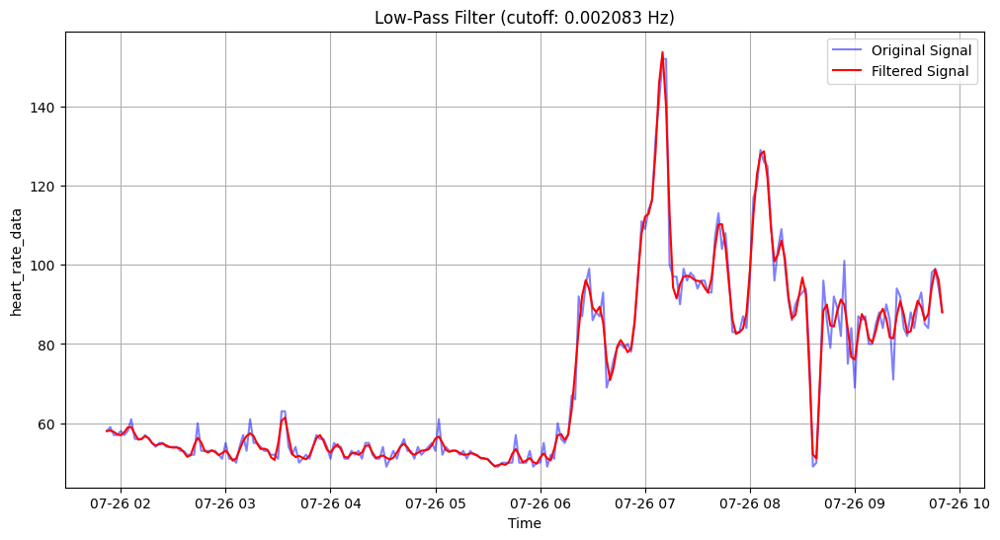

Sampling frequency: 0.008333 Hz (every 120 seconds)


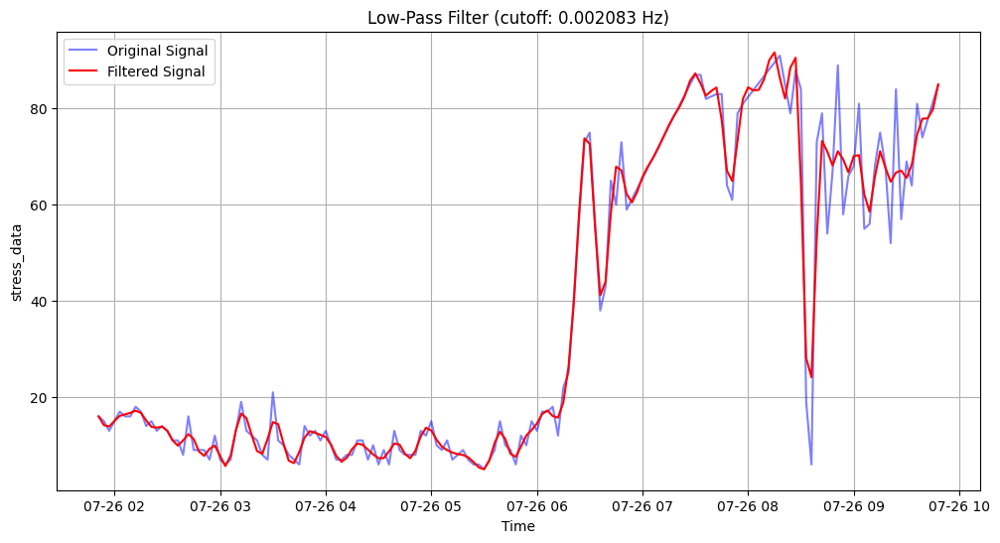

Sampling frequency: 0.008333 Hz (every 120 seconds)


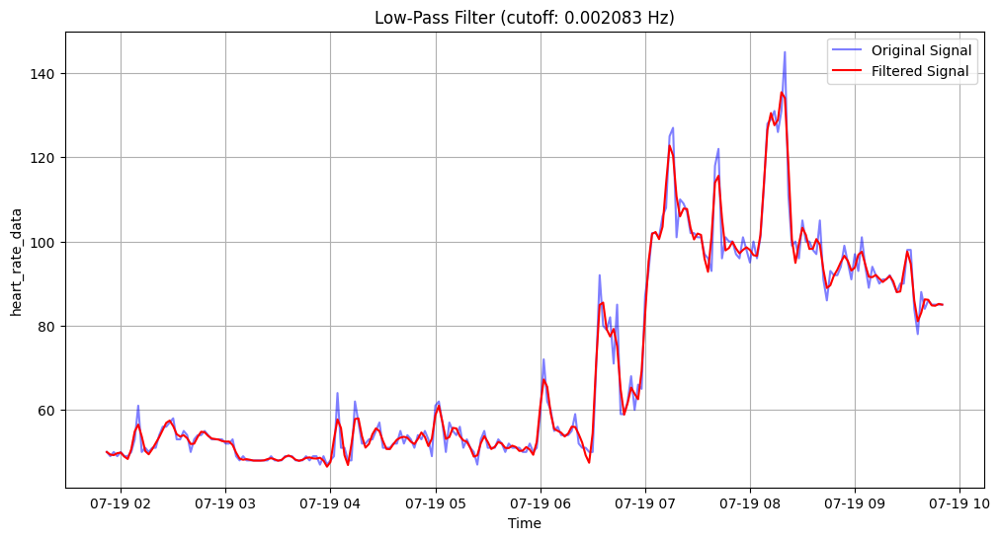

Sampling frequency: 0.008333 Hz (every 120 seconds)


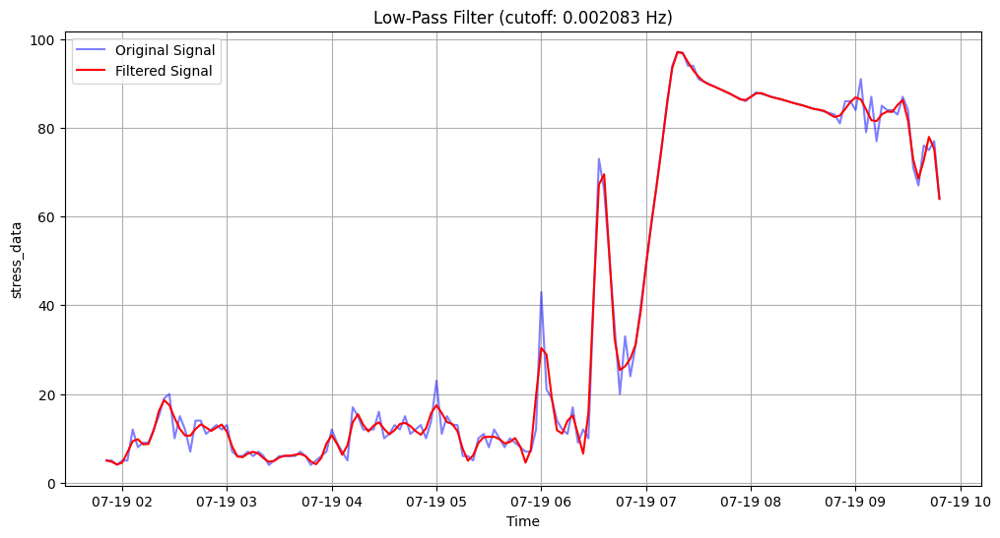

Sampling frequency: 0.008333 Hz (every 120 seconds)


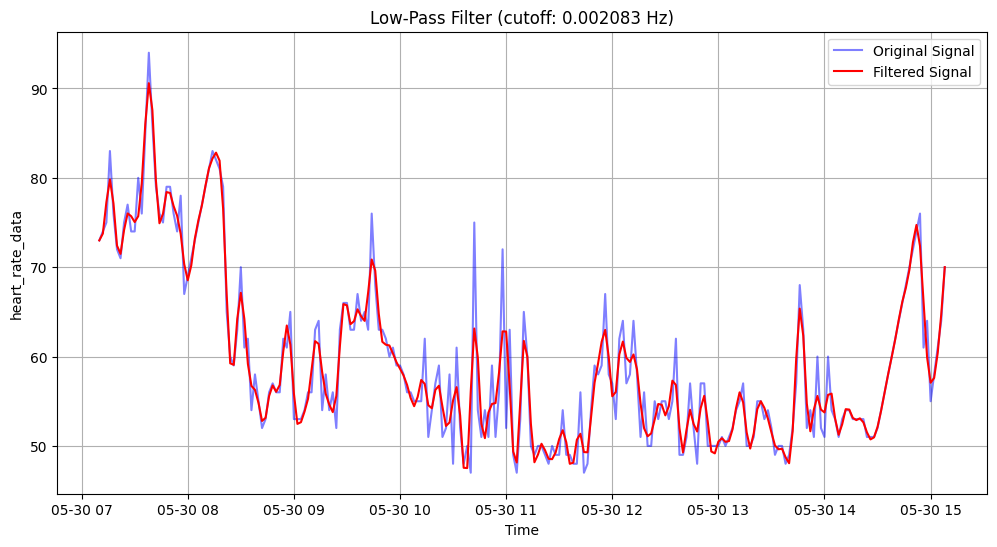

Sampling frequency: 0.008333 Hz (every 120 seconds)


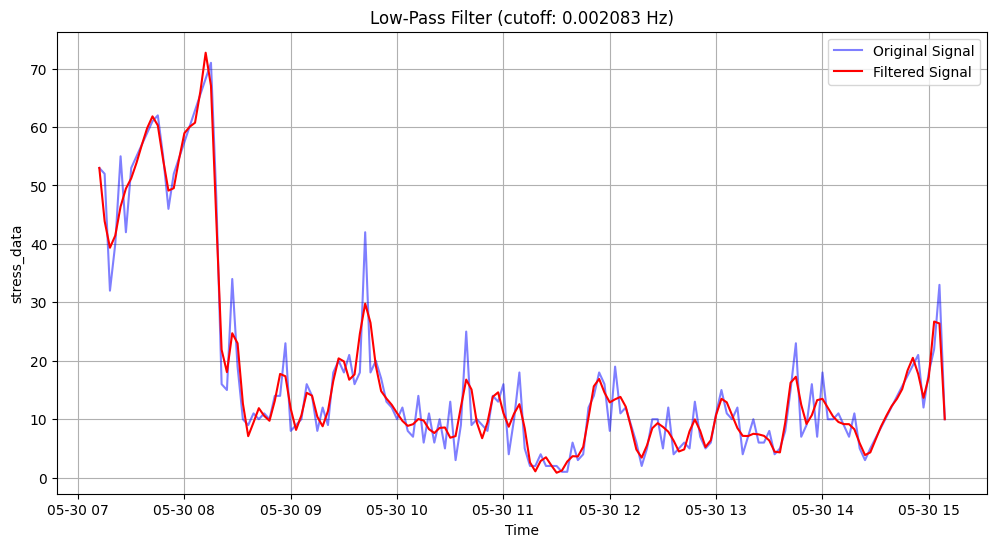

Sampling frequency: 0.008333 Hz (every 120 seconds)


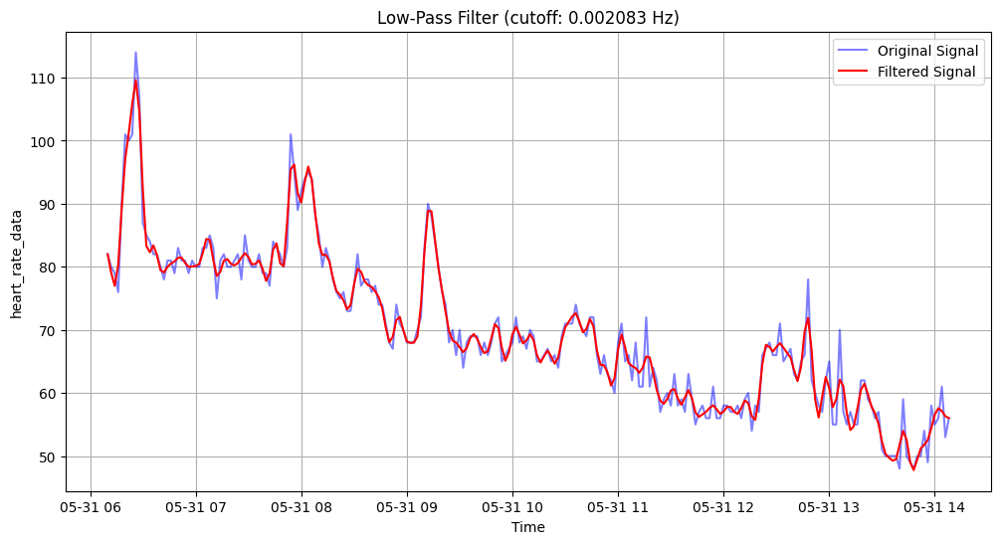

Sampling frequency: 0.008333 Hz (every 120 seconds)


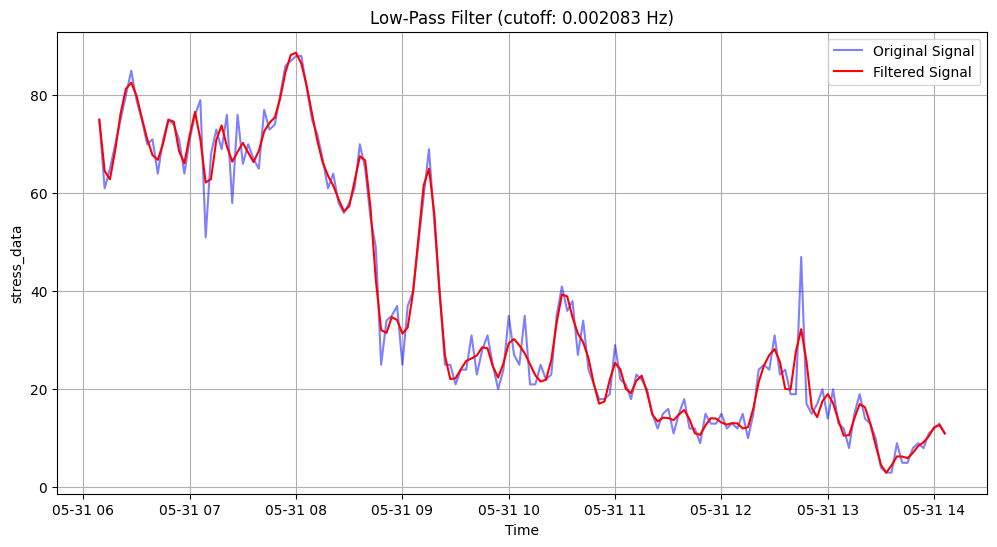

Sampling frequency: 0.008333 Hz (every 120 seconds)


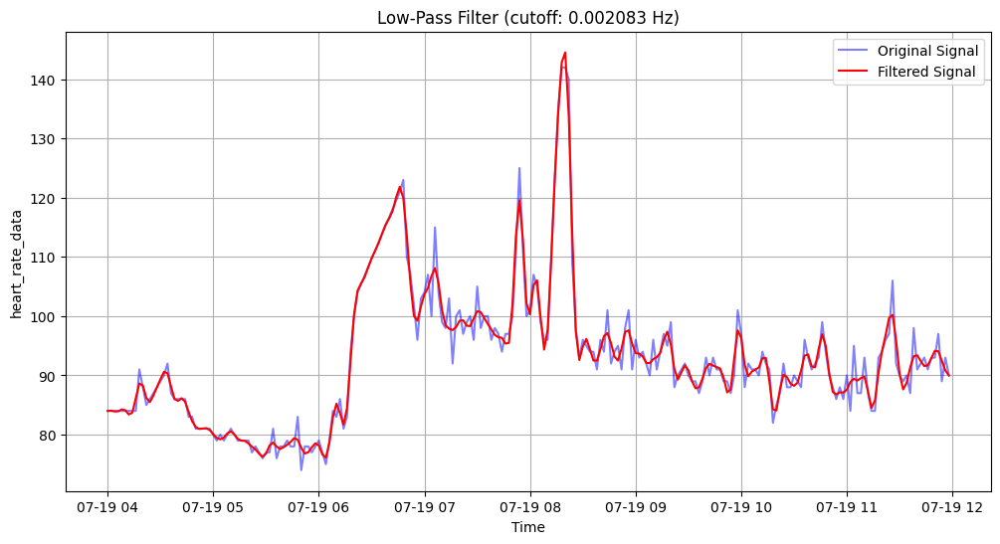

Sampling frequency: 0.008333 Hz (every 120 seconds)


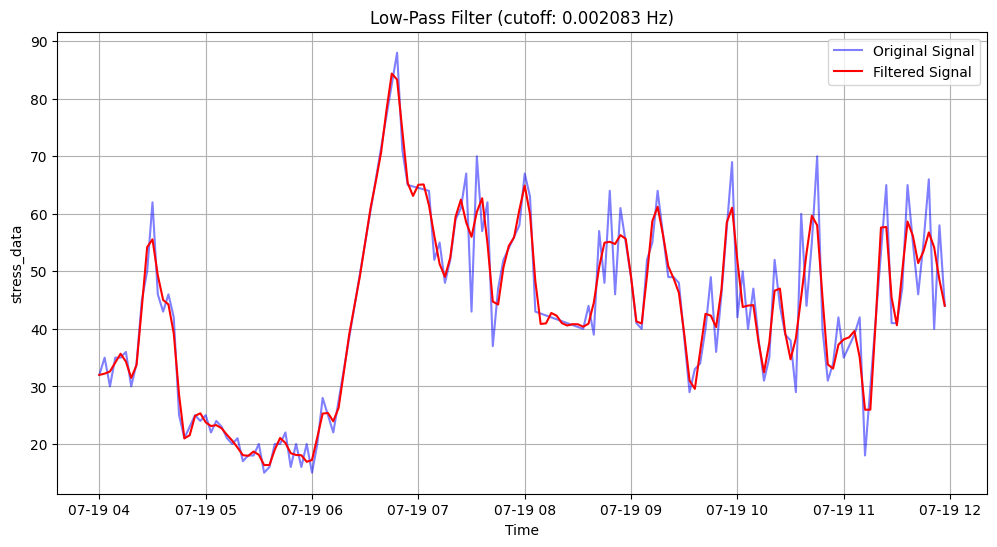

Sampling frequency: 0.008333 Hz (every 120 seconds)


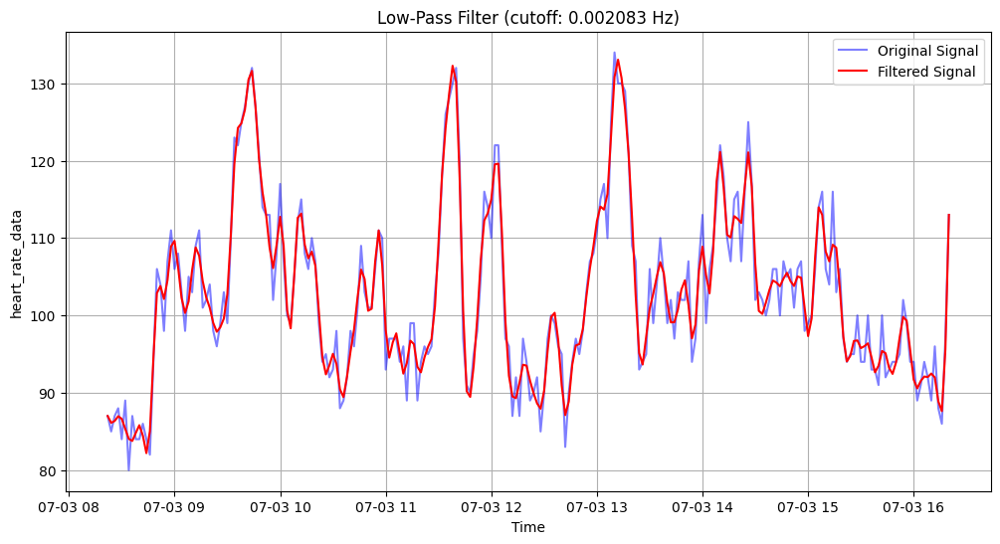

Sampling frequency: 0.008333 Hz (every 120 seconds)


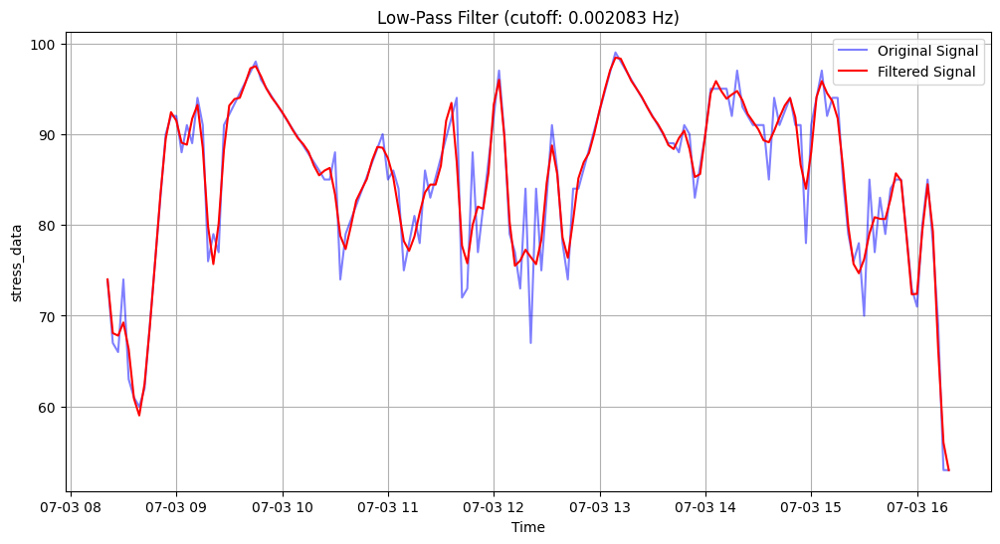

Sampling frequency: 0.008333 Hz (every 120 seconds)


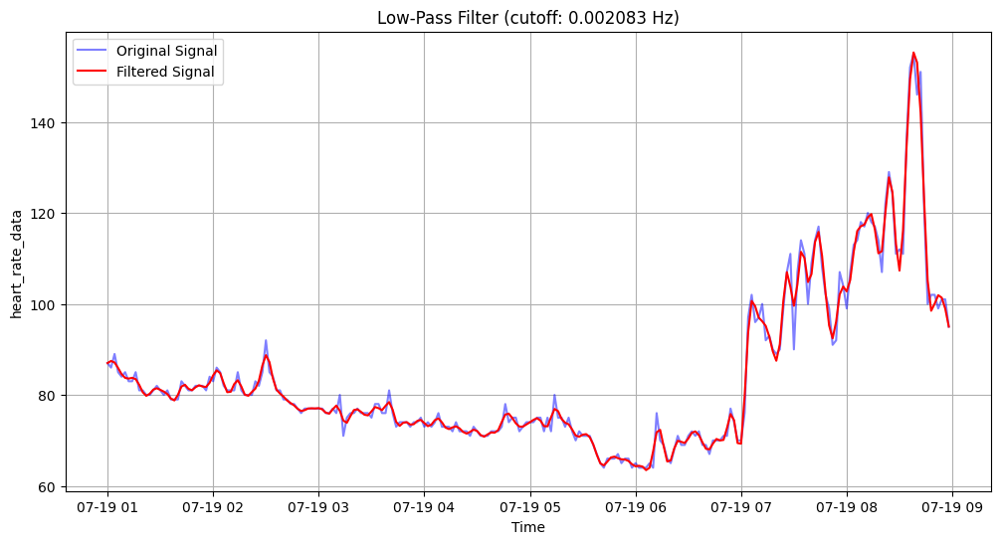

Sampling frequency: 0.008333 Hz (every 120 seconds)


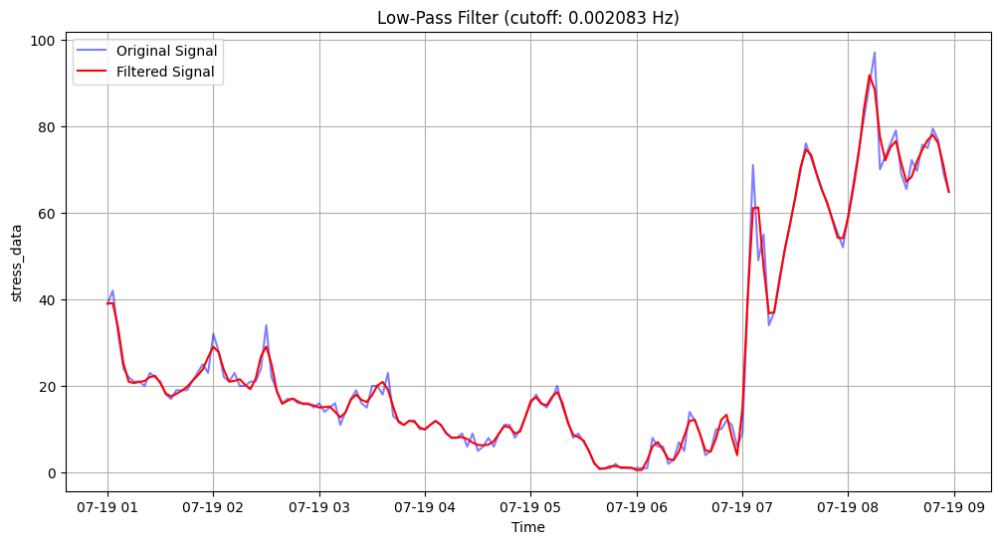

Sampling frequency: 0.008333 Hz (every 120 seconds)


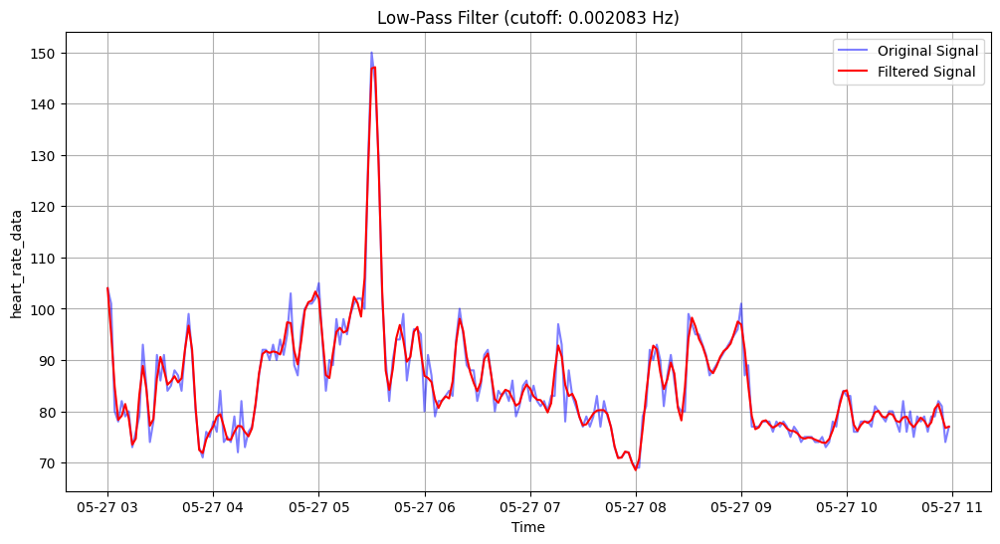

Sampling frequency: 0.008333 Hz (every 120 seconds)


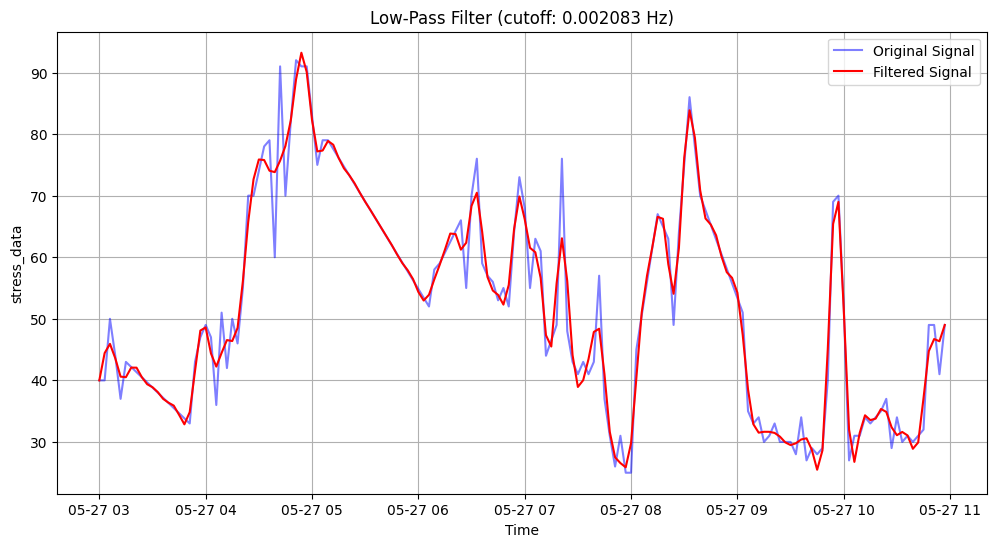

Sampling frequency: 0.008333 Hz (every 120 seconds)


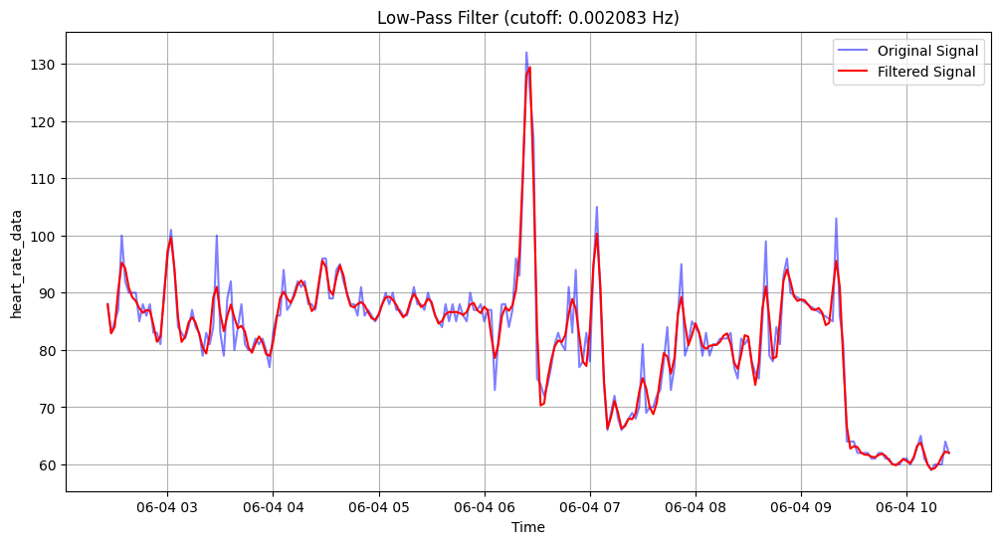

Sampling frequency: 0.008333 Hz (every 120 seconds)


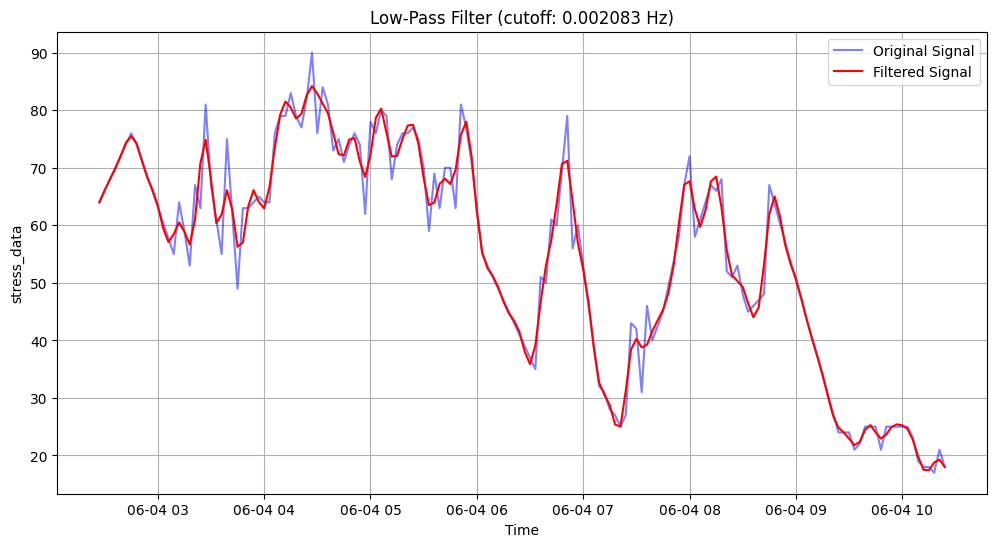

Sampling frequency: 0.008333 Hz (every 120 seconds)


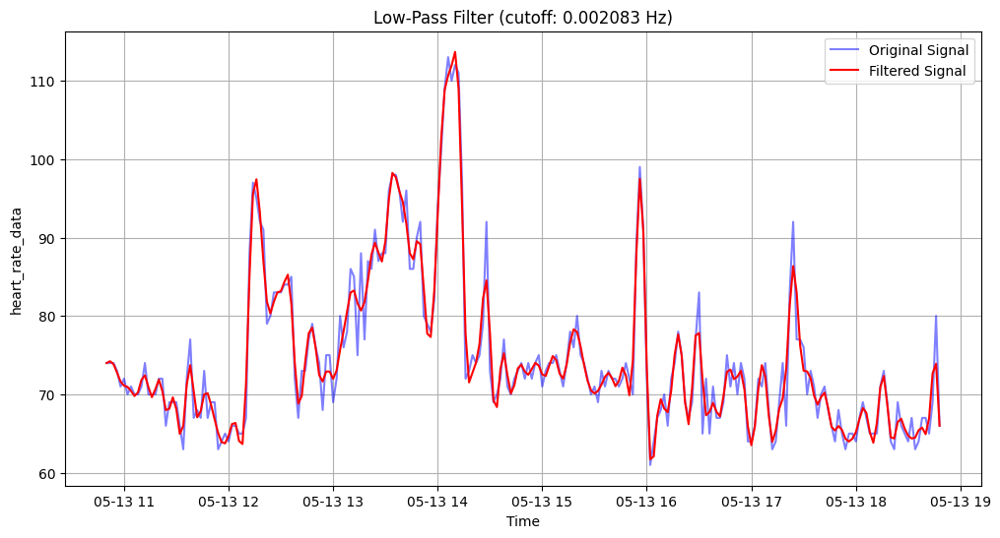

Sampling frequency: 0.008333 Hz (every 120 seconds)


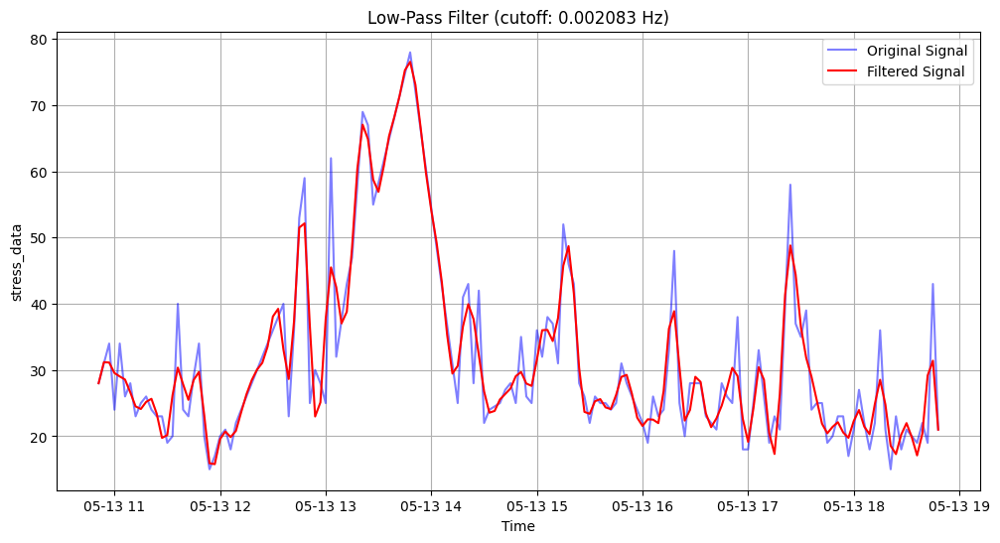

Sampling frequency: 0.008333 Hz (every 120 seconds)


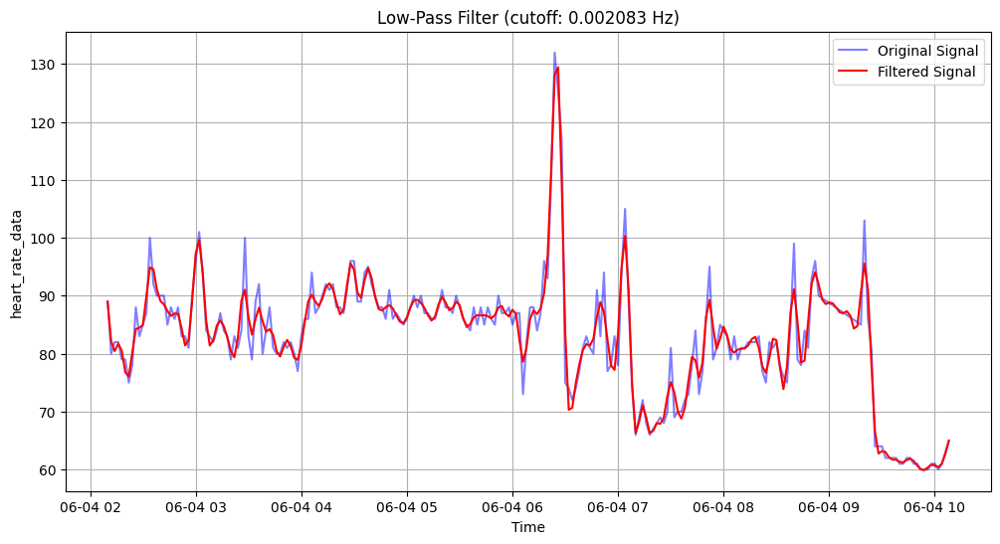

Sampling frequency: 0.008333 Hz (every 120 seconds)


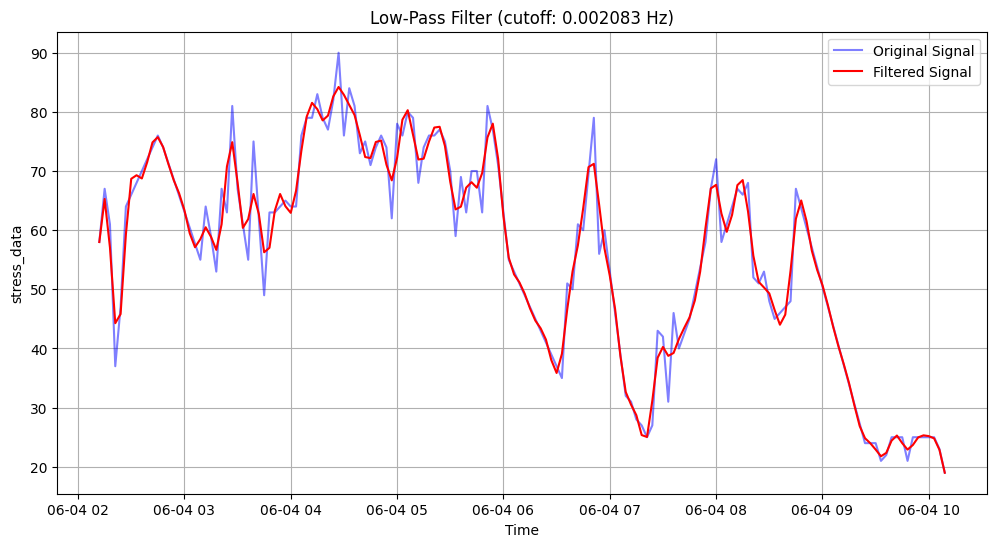

Sampling frequency: 0.008333 Hz (every 120 seconds)


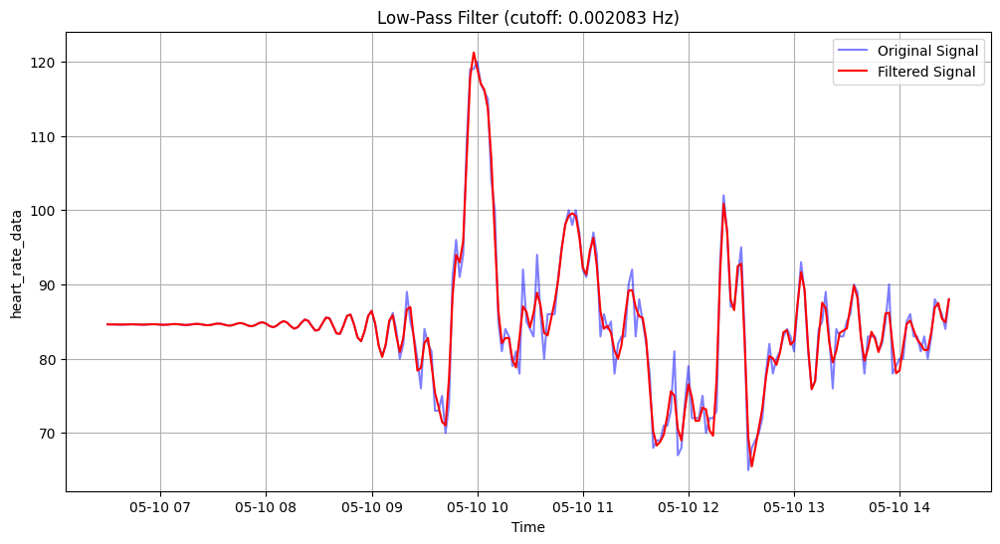

Sampling frequency: 0.008333 Hz (every 120 seconds)


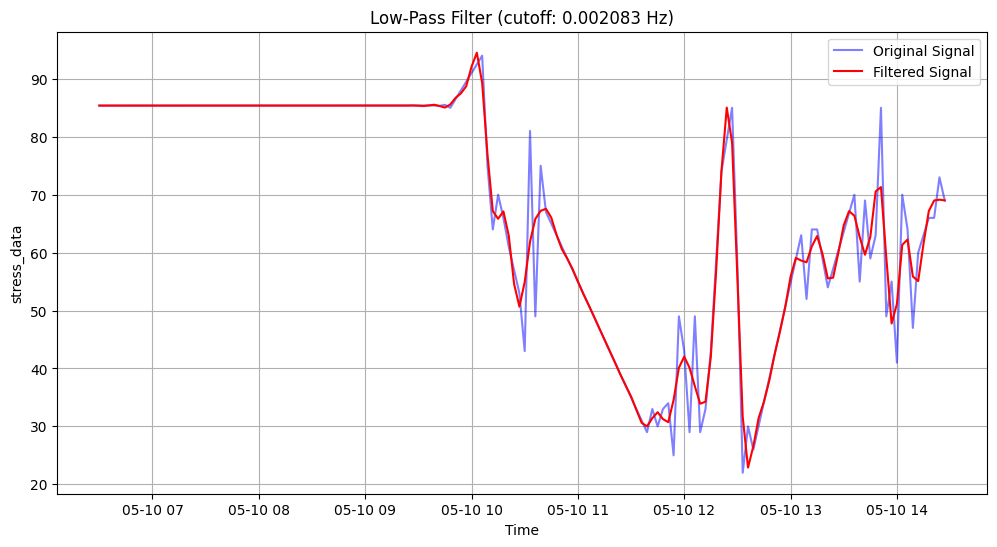

In [ ]:
# Applicare un filtro passa-basso con frequenza di taglio di 1/240 Hz
cutoff_freq = 1/(120*4)  # Hz


filtered_series=[None] * len(full_inference_series)


i=0

for hr_df, bpm_db, stress_df in full_inference_series:

  new_hr=apply_lowpass_filter(full_inference_series[i][0], 'timestamp', 'heart_rate_data', cutoff_freq)
  #new_bpm=apply_lowpass_filter(full_inference_series[i][1], 'timestamp', 'respiration_data', cutoff_freq)
  new_bpm=full_inference_series[i][1].copy()    #since we decided not to filter bpm, being an integer and not a float
  new_stress=apply_lowpass_filter(full_inference_series[i][2], 'timestamp', 'stress_data', cutoff_freq)

  filtered_series[i]=(new_hr, new_bpm, new_stress)

  i+=1

##Test Stress-Rescaling

In [ ]:
print(filtered_series[22][0])

              timestamp  heart_rate_data
0   2024-07-26 01:52:00        57.999777
1   2024-07-26 01:54:00        58.131946
2   2024-07-26 01:56:00        57.804911
3   2024-07-26 01:58:00        57.177029
4   2024-07-26 02:00:00        56.929902
..                  ...              ...
235 2024-07-26 09:42:00        87.565625
236 2024-07-26 09:44:00        94.284241
237 2024-07-26 09:46:00        98.847624
238 2024-07-26 09:48:00        96.093204
239 2024-07-26 09:50:00        88.014082

[240 rows x 2 columns]


<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


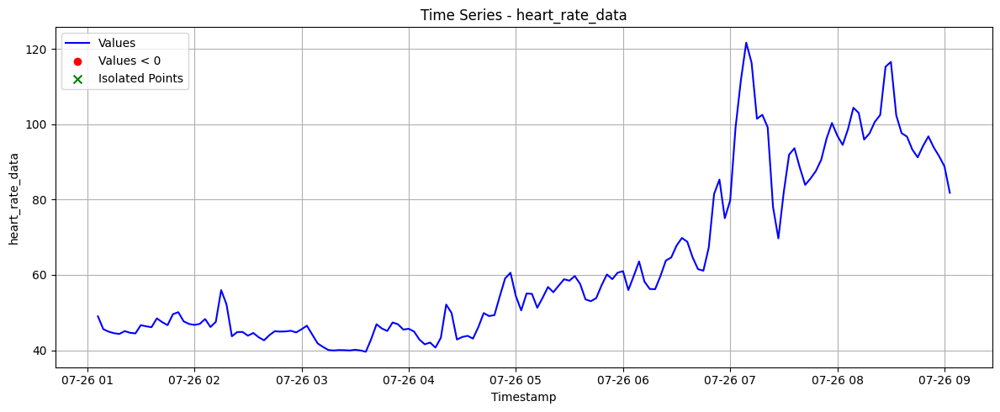

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


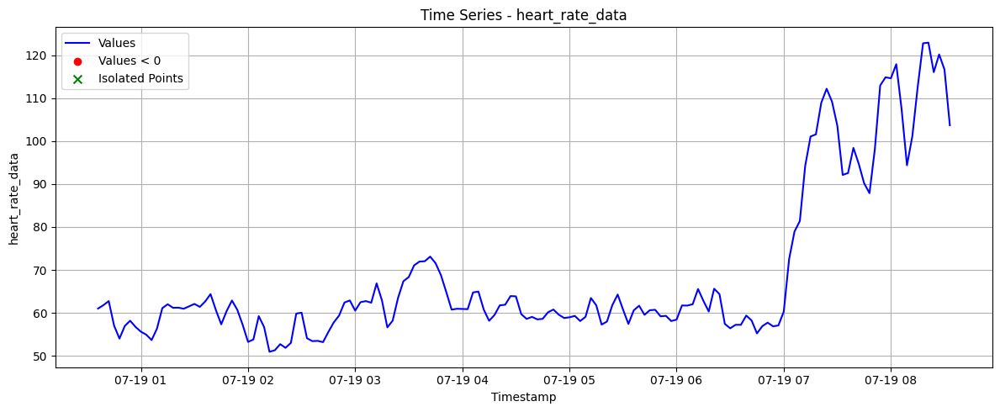

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


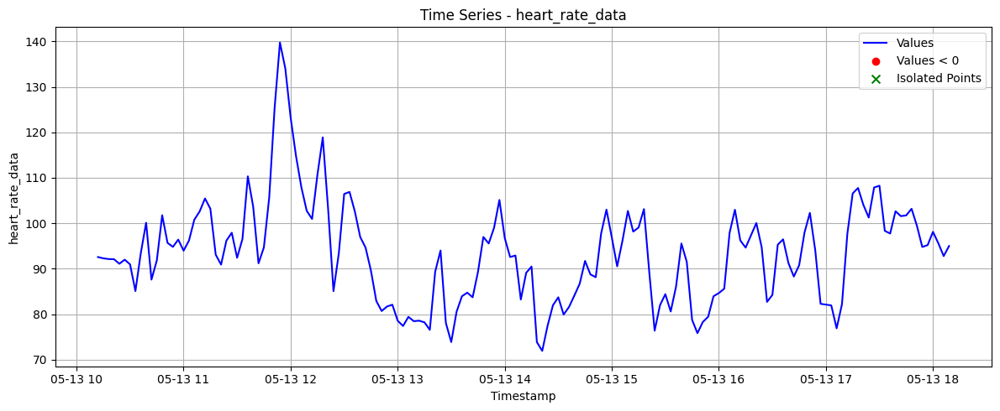

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


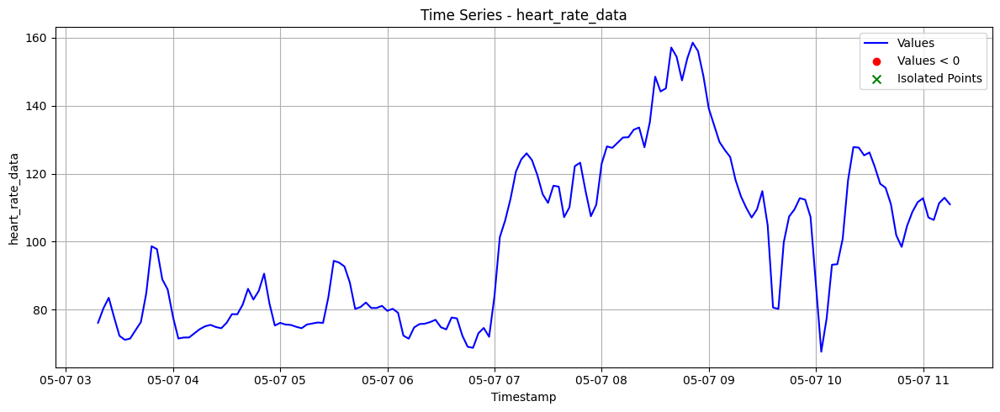

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


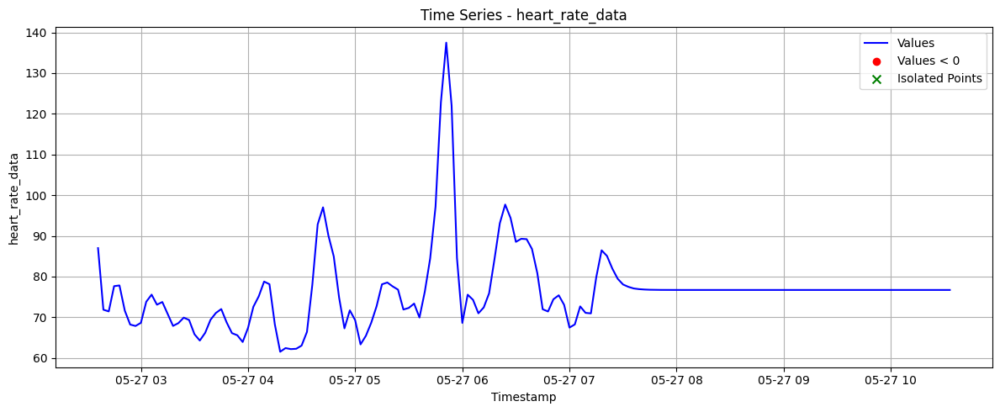

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


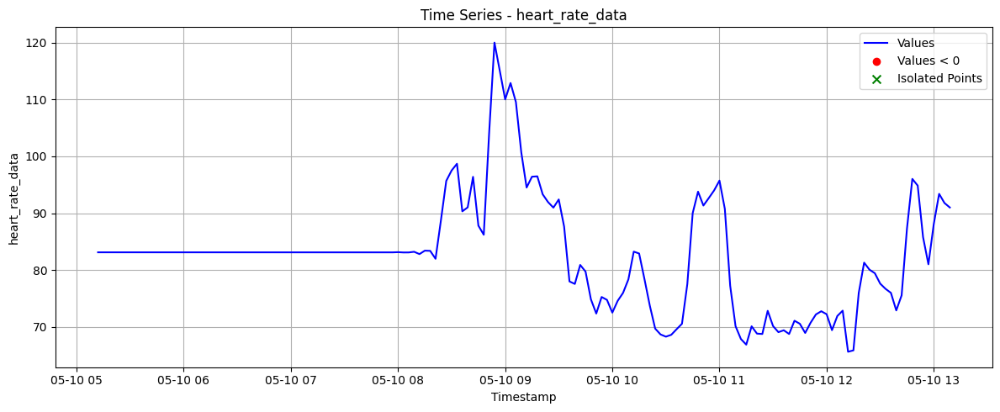

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


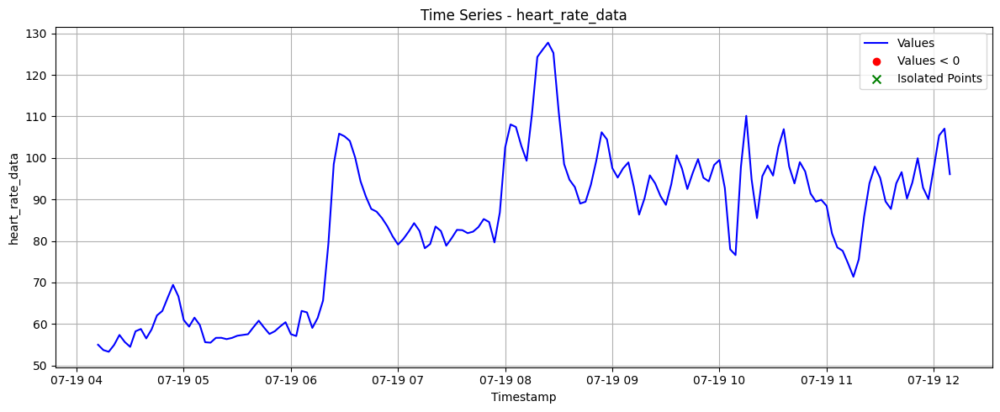

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


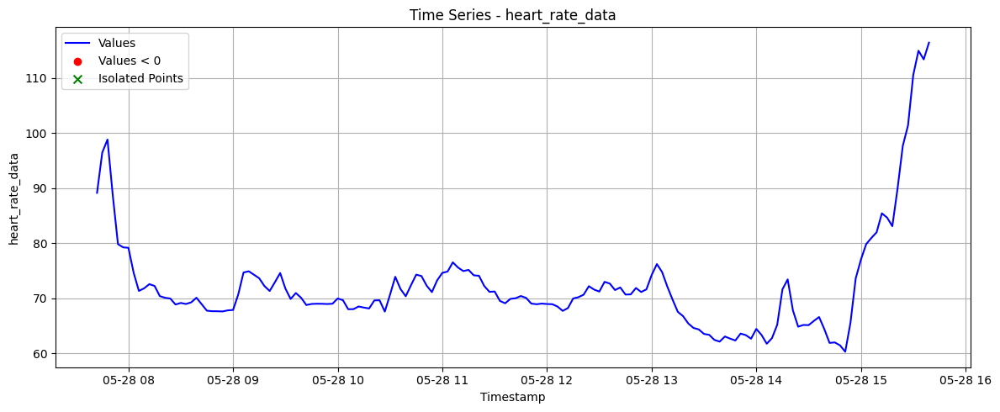

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


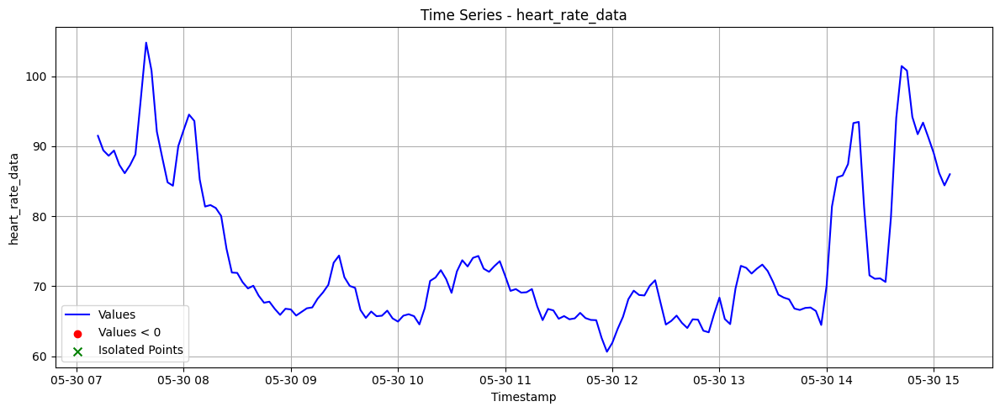

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


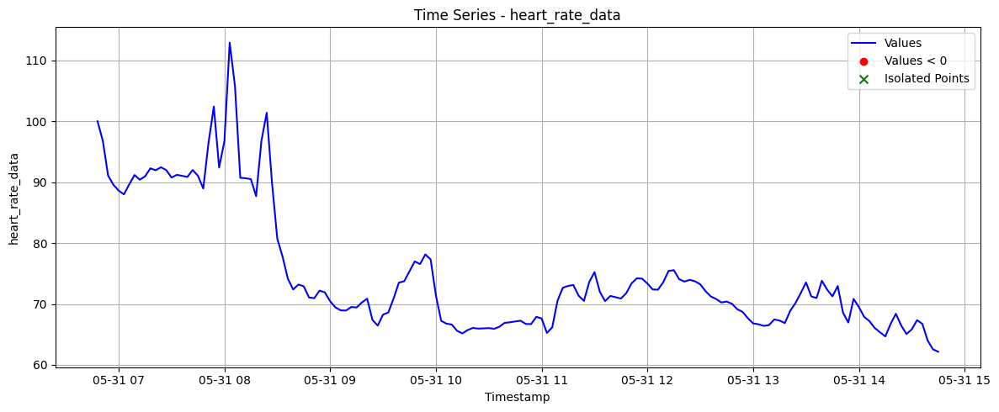

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


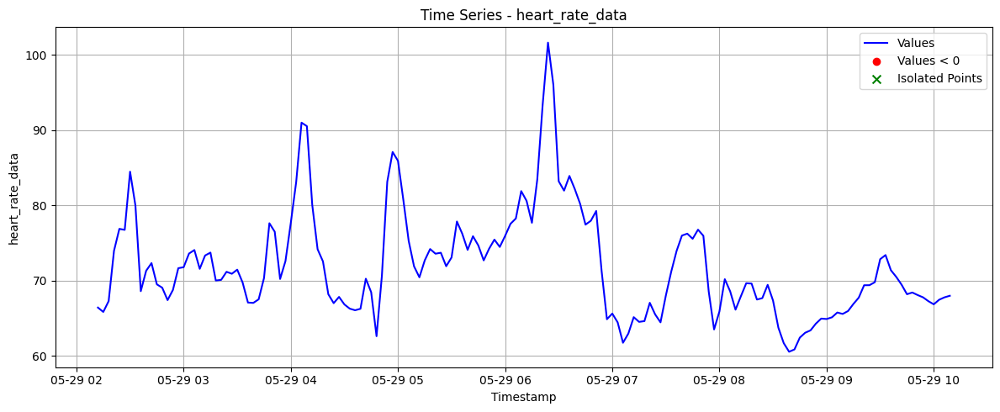

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


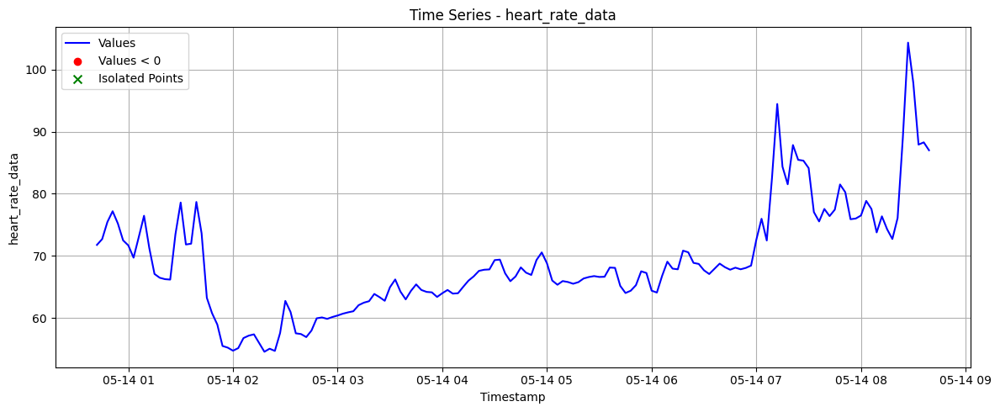

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


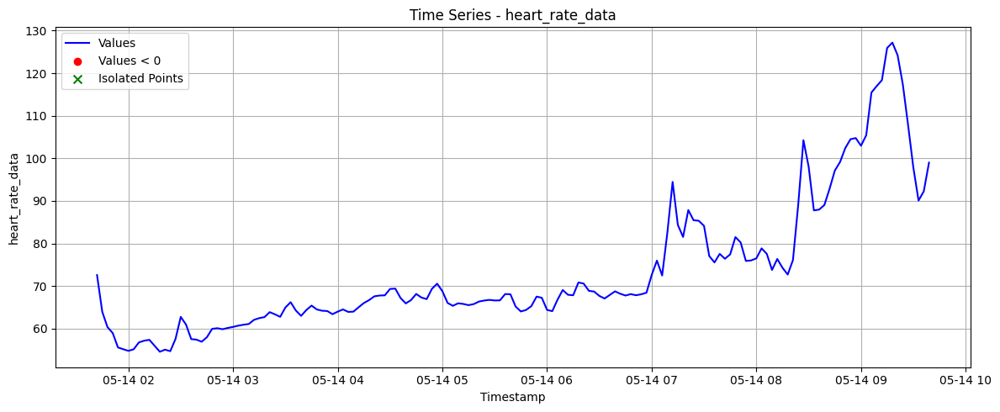

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


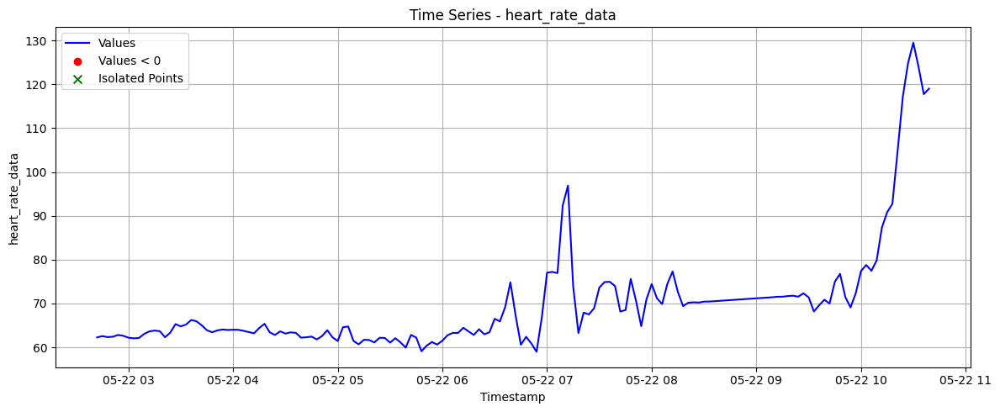

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


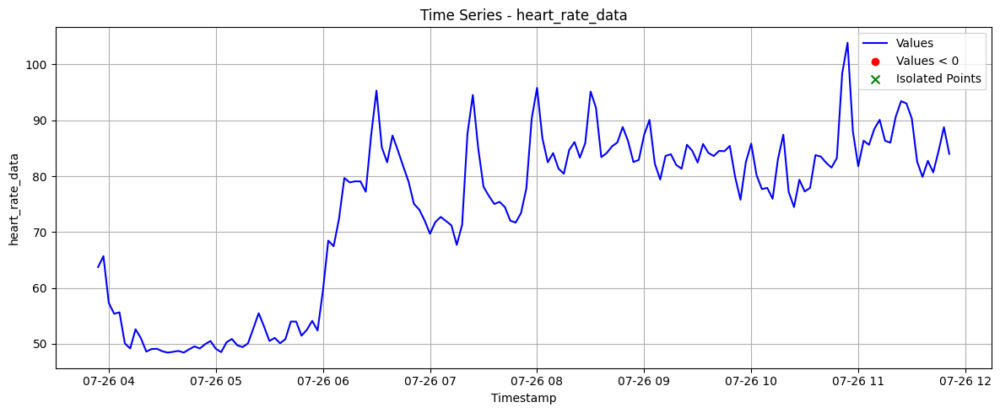

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


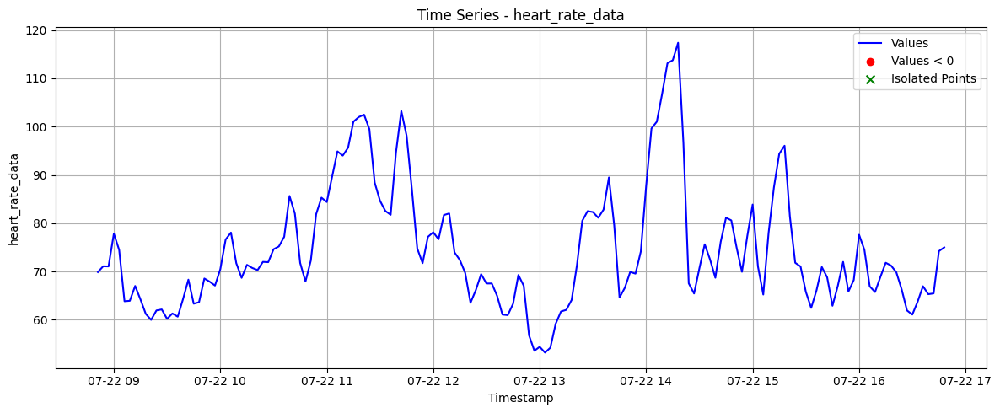

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


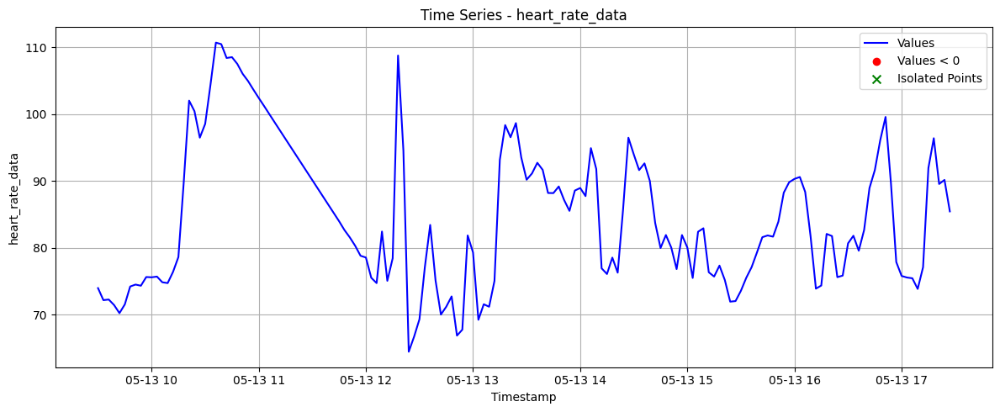

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


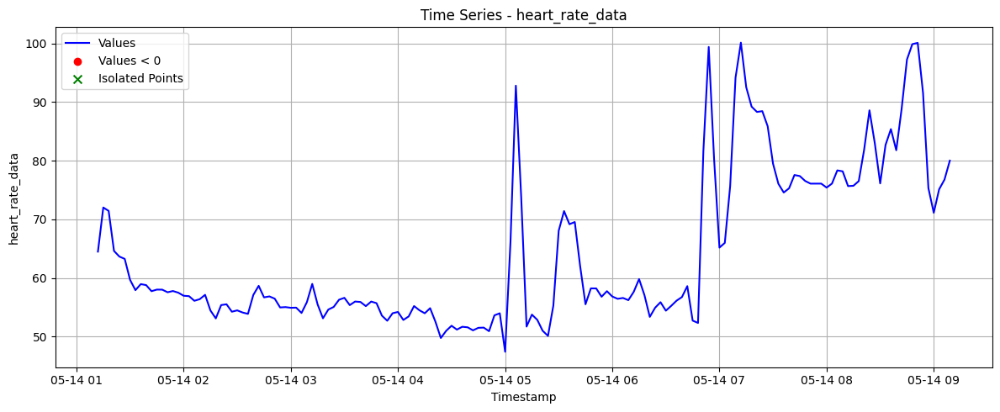

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


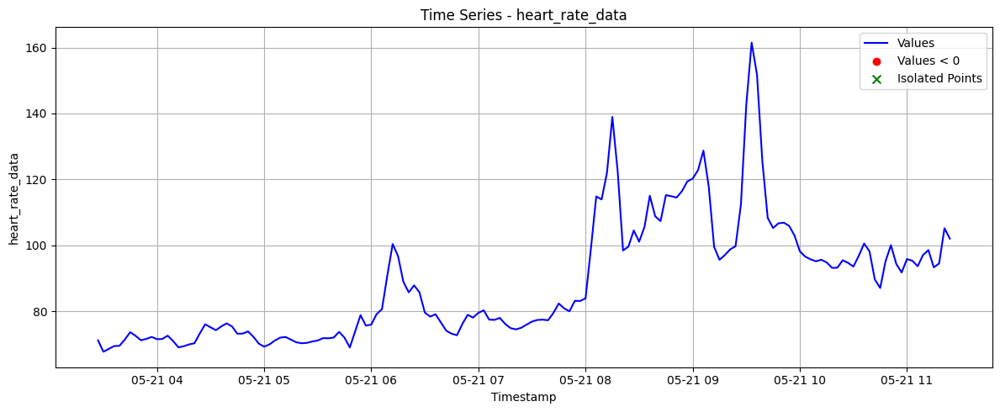

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


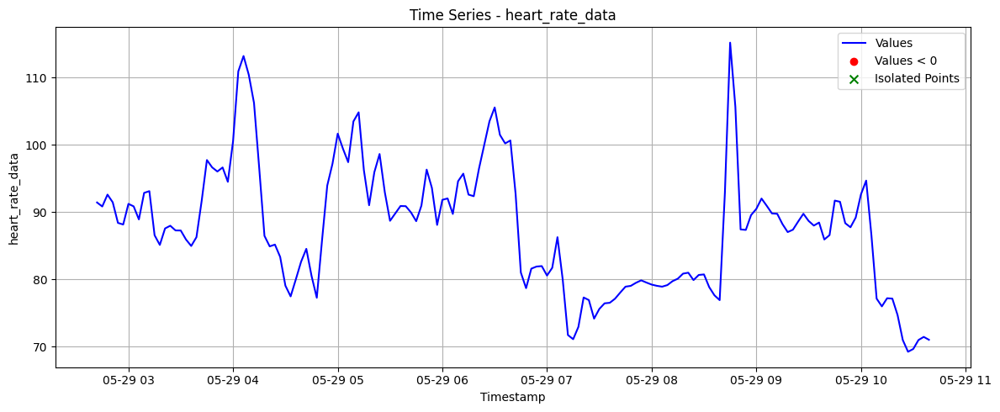

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


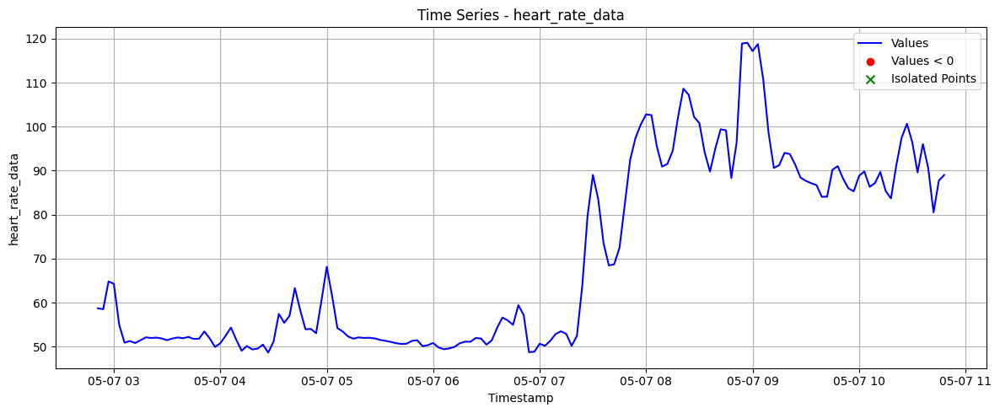

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


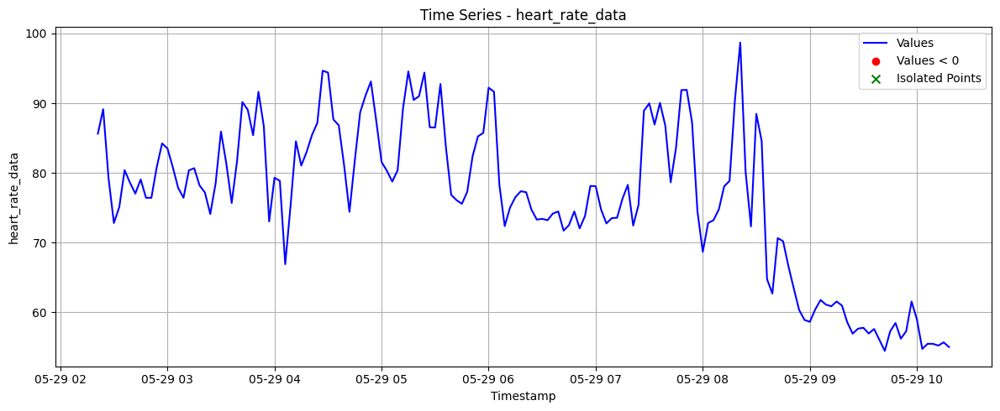

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


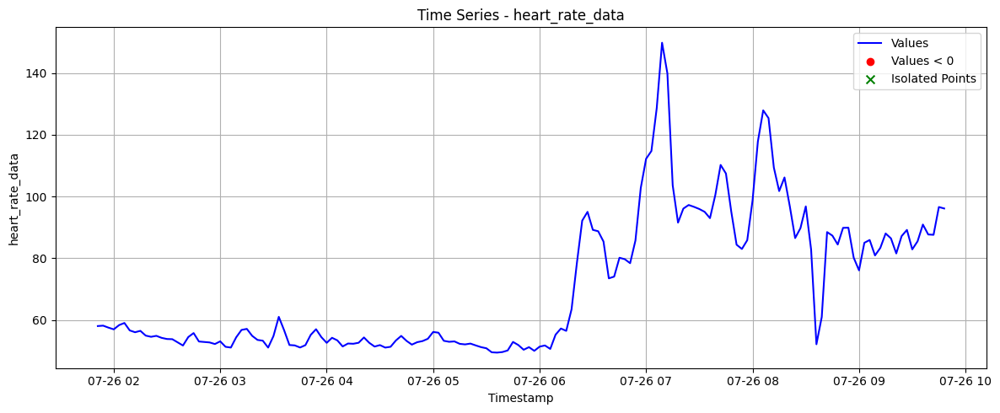

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


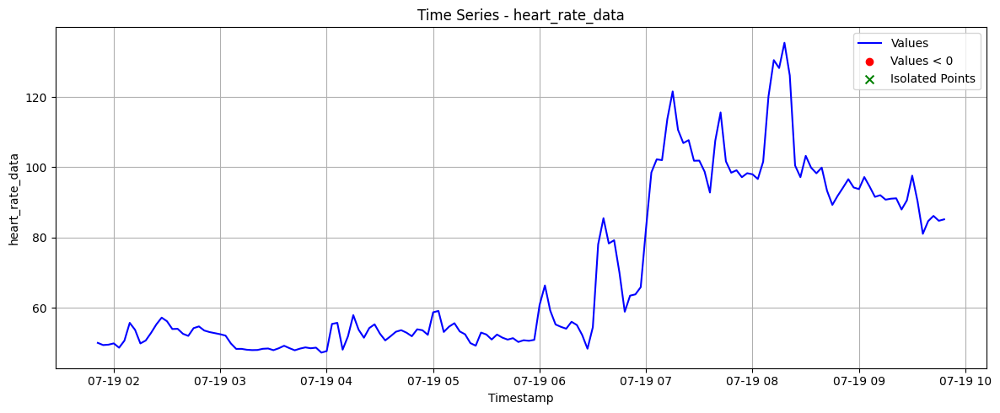

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


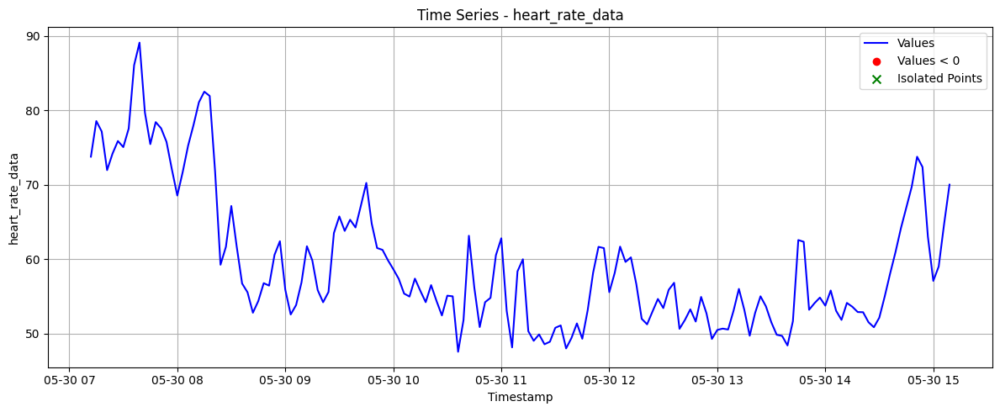

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


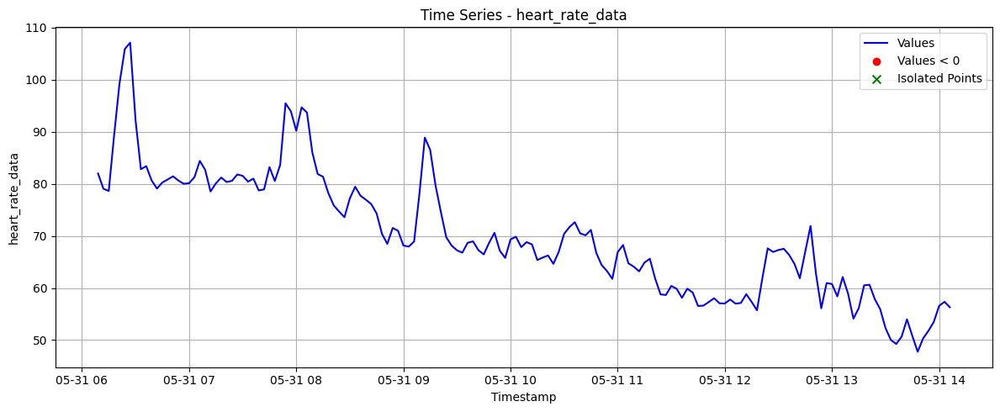

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


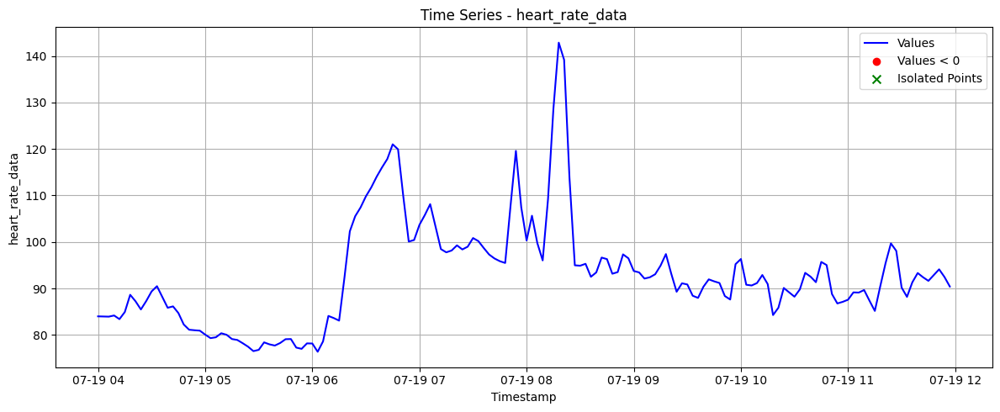

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


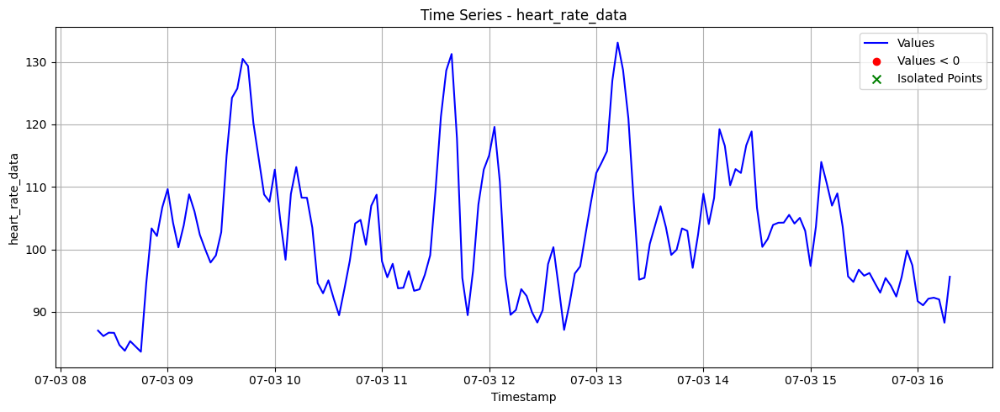

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


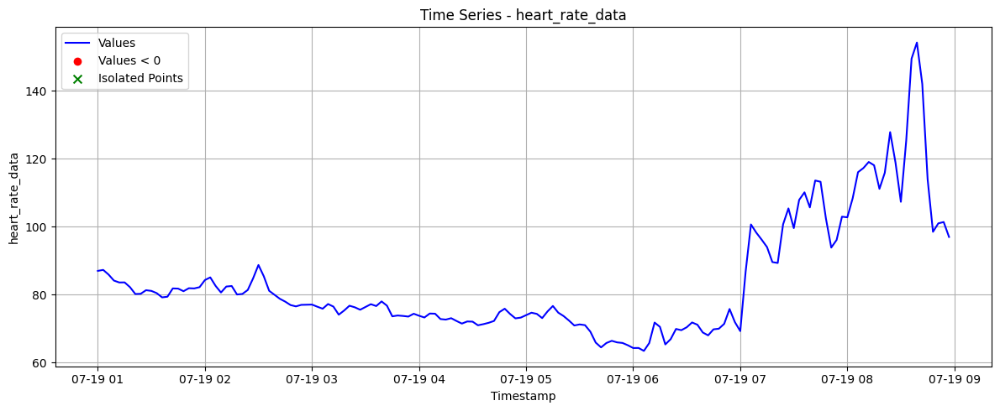

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


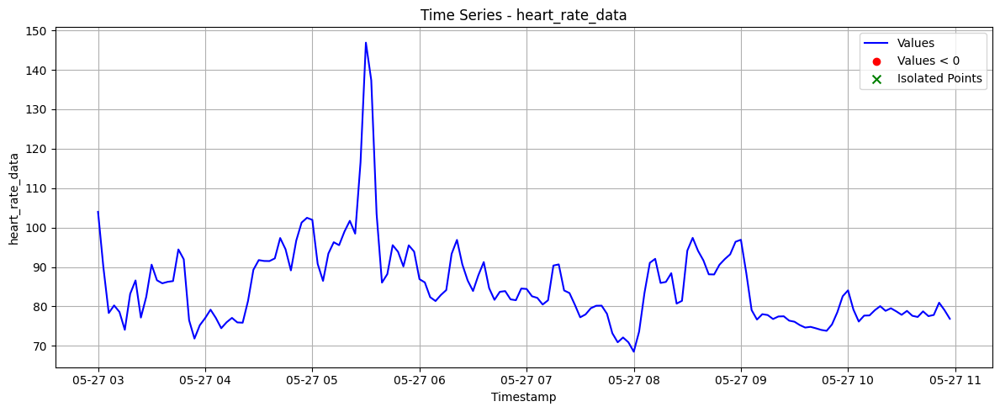

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


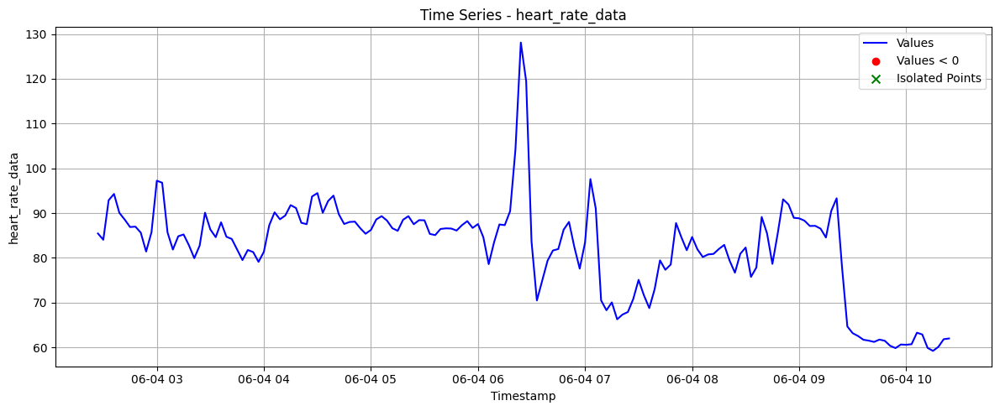

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


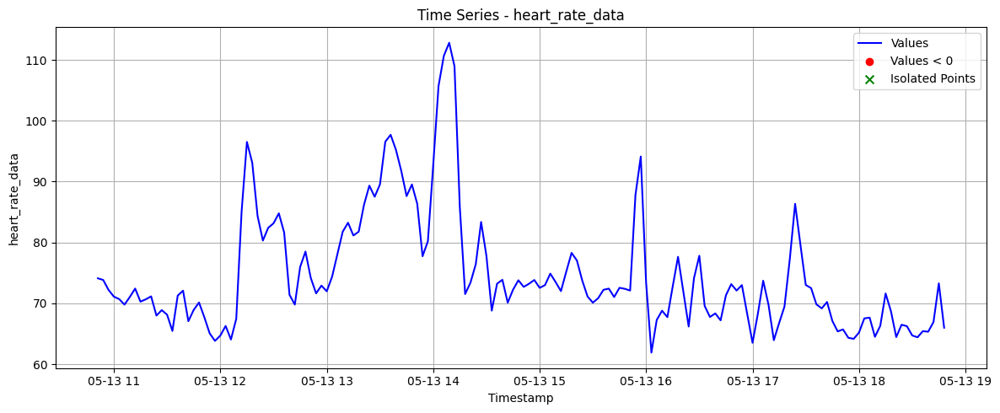

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


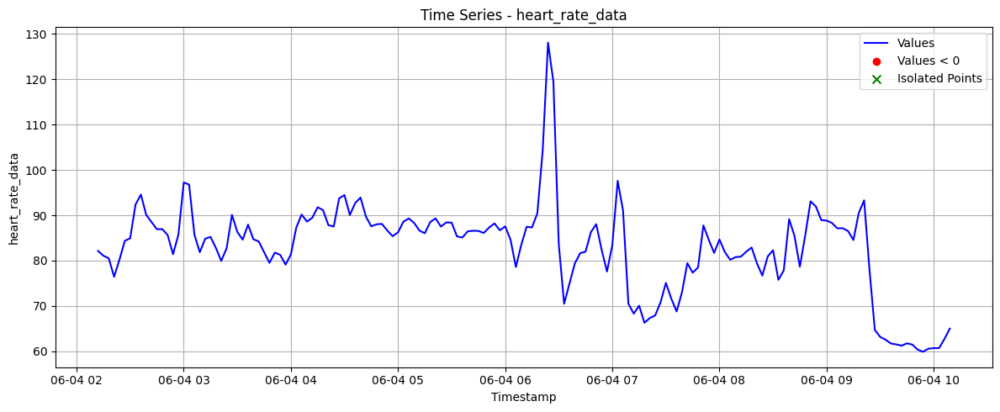

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)
<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


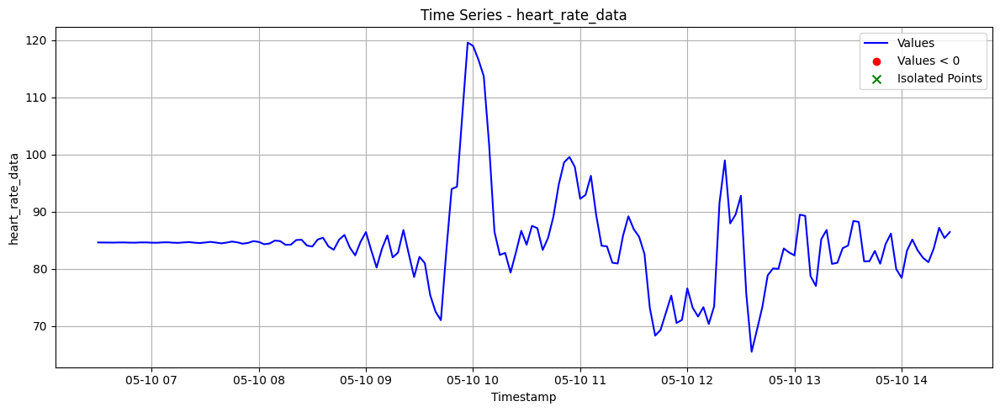

<ipython-input-67-12a47c4aa017>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  new_df_interpolated = new_df.interpolate(method='time').fillna(method='ffill', limit=2).fillna(method='bfill', limit=2)


In [ ]:
#test for rescaling stress from sampled once every 3' to once every 2'
#hr, bpm, stress = full_inference_series[0]

rescaled_series=[None] * len(filtered_series)


i=0

for hr_df, bpm_db, stress_df in filtered_series:


  new_hr=align_to_timestamps(hr_df, stress_df['timestamp'])
  if not new_hr['timestamp'].equals(stress_df['timestamp']):
    print(f'error in converting patient {i} hr timestamps')
  plot_time_series_with_negatives(new_hr)

  new_bpm=align_to_timestamps(bpm_db, stress_df['timestamp'])
  if not new_bpm['timestamp'].equals(stress_df['timestamp']):
    print(f'error in converting patient {i} bpm timestamps')

  new_stress=stress_df.copy()

  #print(f'{len(new_hr)}-{len(new_bpm)}-{len(new_stress)}')

  rescaled_series[i]=(new_hr, new_bpm, new_stress)

  i+=1

In [ ]:
print(rescaled_series[22][0])

              timestamp  heart_rate_data
0   2024-07-26 01:51:00        57.999777
1   2024-07-26 01:54:00        58.131946
2   2024-07-26 01:57:00        57.490970
3   2024-07-26 02:00:00        56.929902
4   2024-07-26 02:03:00        58.304885
..                  ...              ...
155 2024-07-26 09:36:00        90.892310
156 2024-07-26 09:39:00        87.672480
157 2024-07-26 09:42:00        87.565625
158 2024-07-26 09:45:00        96.565933
159 2024-07-26 09:48:00        96.093204

[160 rows x 2 columns]


In [ ]:
# prompt: saving rescaled_series as a pkle file

with open('/content/drive/MyDrive/LL2/rescaled_series.pkl', 'wb') as f:
  pickle.dump(rescaled_series, f)

##Visualizing and merge with Ground Truth

In [ ]:
df_CP_5['heart_rate_data'] = None
df_CP_5['respiration_data'] = None
df_CP_5['stress_data'] = None

# Itera su ogni riga di df_CP_5 e ogni elemento di rescaled_series contemporaneamente
for i in range(len(df_CP_5)):
    # Estrai la tupla corrispondente da rescaled_series
    hr_df, resp_df, stress_df = rescaled_series[i]

    if len(hr_df.columns)!=2 or len(resp_df.columns)!=2 or len(stress_df.columns)!=2:
      print(f'error in patient {i}')

    # Estrai le serie temporali (la seconda colonna di ciascun dataframe)
    heart_rate_series = hr_df['heart_rate_data'] if 'heart_rate_data' in hr_df.columns else hr_df.iloc[:, 1]
    respiration_series = resp_df['respiration_data'] if 'respiration_data' in resp_df.columns else resp_df.iloc[:, 1]
    stress_series = stress_df['stress_data'] if 'stress_data' in stress_df.columns else stress_df.iloc[:, 1]

    # Assegna le serie alle rispettive celle di df_CP_5
    df_CP_5.at[i, 'heart_rate_data'] = heart_rate_series.values.tolist()
    df_CP_5.at[i, 'respiration_data'] = respiration_series.values.tolist()
    df_CP_5.at[i, 'stress_data'] = stress_series.values.tolist()

In [ ]:
df_CP_5.to_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_5_listlike.xlsx', index=False)

In [ ]:
test=df_CP_5.at[0, 'heart_rate_data']
for i in range(len(test)):
  print(f'{i:>3}: {test[i]:>10}')

  0: 49.000774719118965
  1: 45.60371183830627
  2: 44.925615678450086
  3: 44.52462545994944
  4: 44.32238350310848
  5: 45.07629080973836
  6: 44.62882766225998
  7: 44.464145747025924
  8: 46.660234756840744
  9: 46.352854894272156
 10: 46.113700467106845
 11: 48.45851358798197
 12: 47.4489868946885
 13: 46.657847296544176
 14: 49.57473513997175
 15: 50.10466462524225
 16: 47.6728511165695
 17: 46.98220581896087
 18: 46.728539108848246
 19: 46.981383320907064
 20: 48.29260430817382
 21: 46.173263909885534
 22: 47.52929881265671
 23: 55.96601019378661
 24: 52.174222602029985
 25: 43.70167375614122
 26: 44.823551529923996
 27: 44.85334904196682
 28: 43.85984859567598
 29: 44.584759145490494
 30: 43.44381532382366
 31: 42.63130612694145
 32: 43.998362696298294
 33: 45.04430607953671
 34: 44.948019191423995
 35: 44.99041919652487
 36: 45.164202165541816
 37: 44.727721357573586
 38: 45.566904636187445
 39: 46.51379298213746
 40: 44.14921023546639
 41: 41.819451133651896
 42: 40.883545888

heart_rate_data:


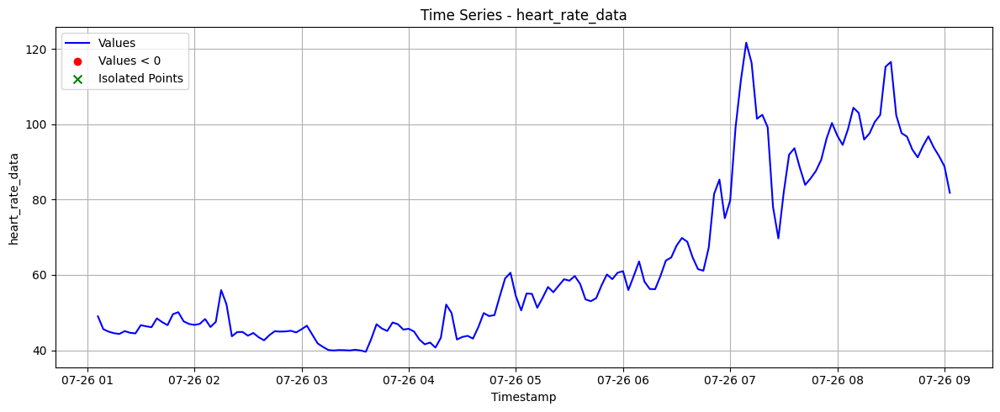

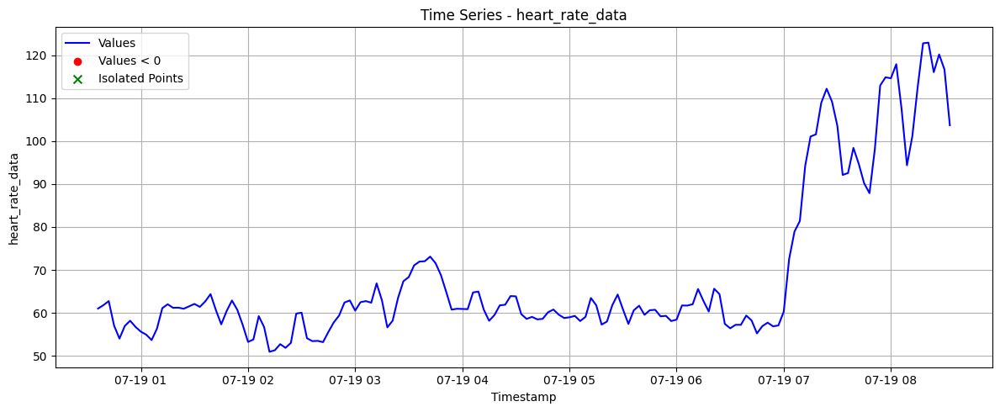

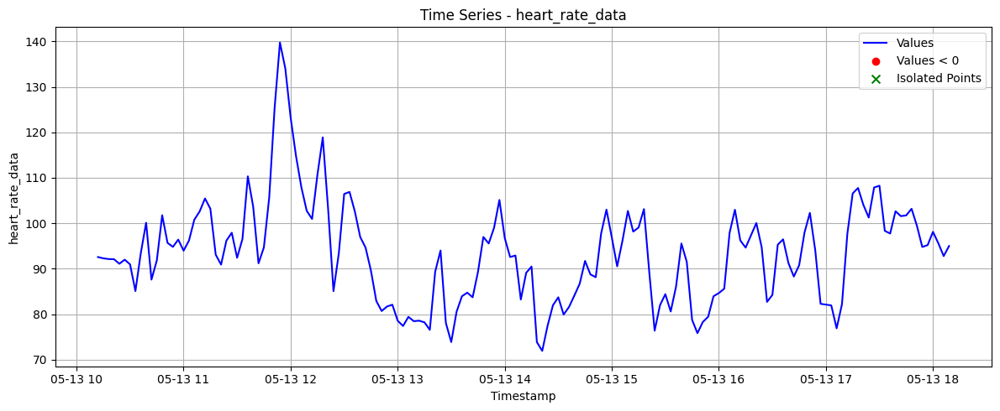

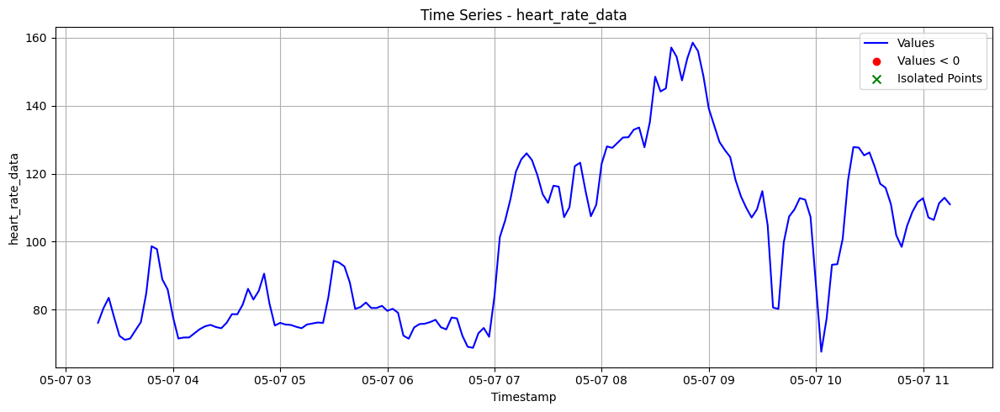

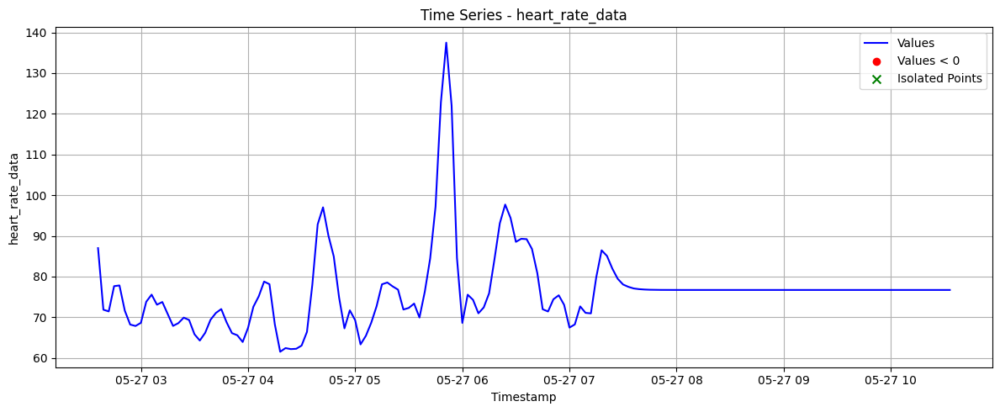

...

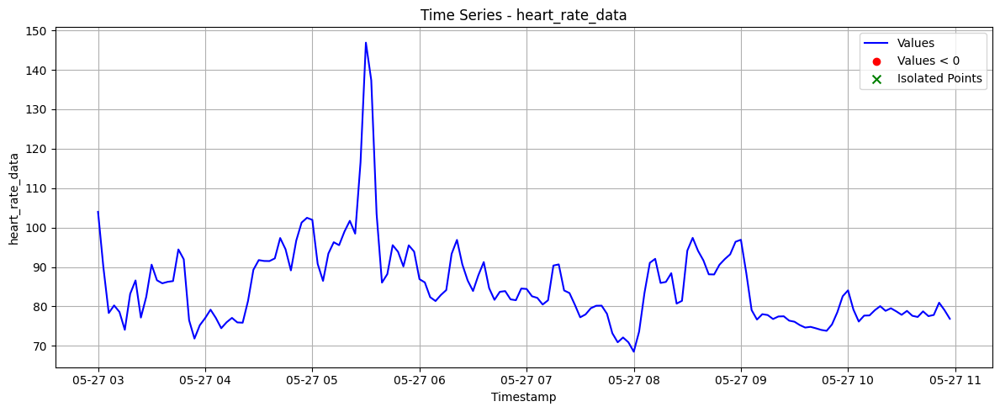

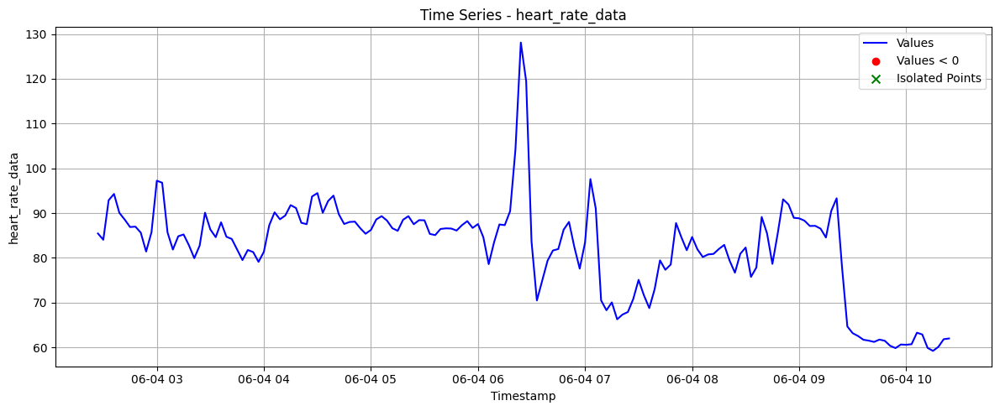

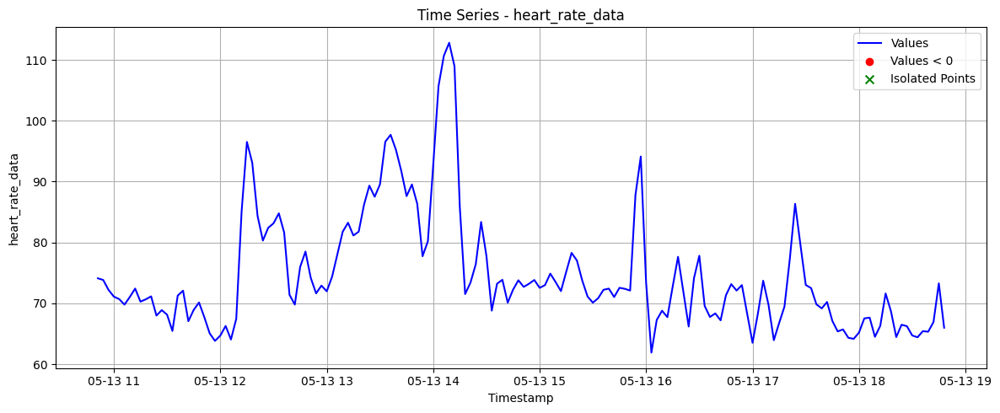

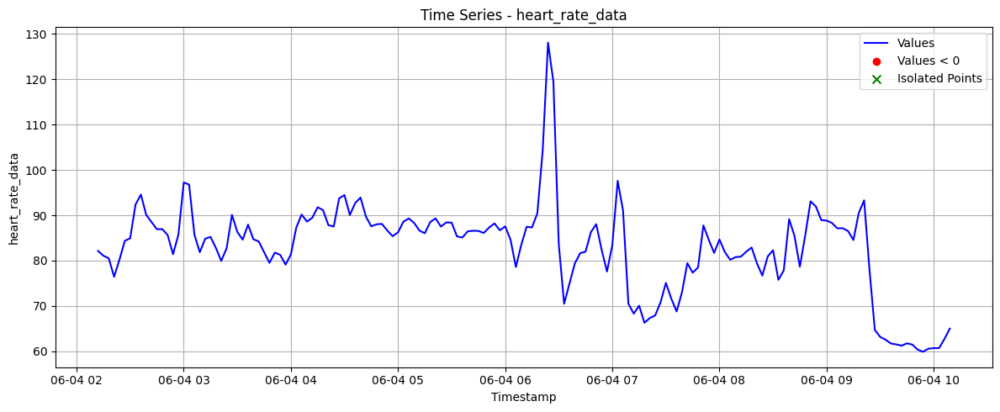

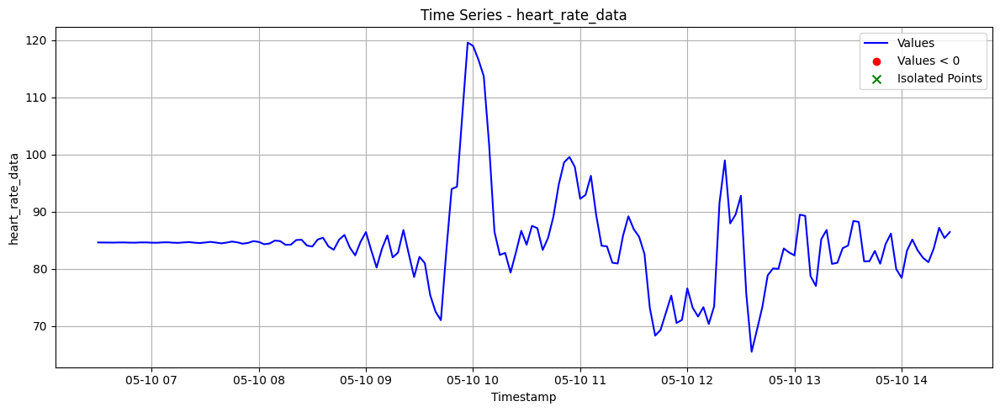






















-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
respiration_data:


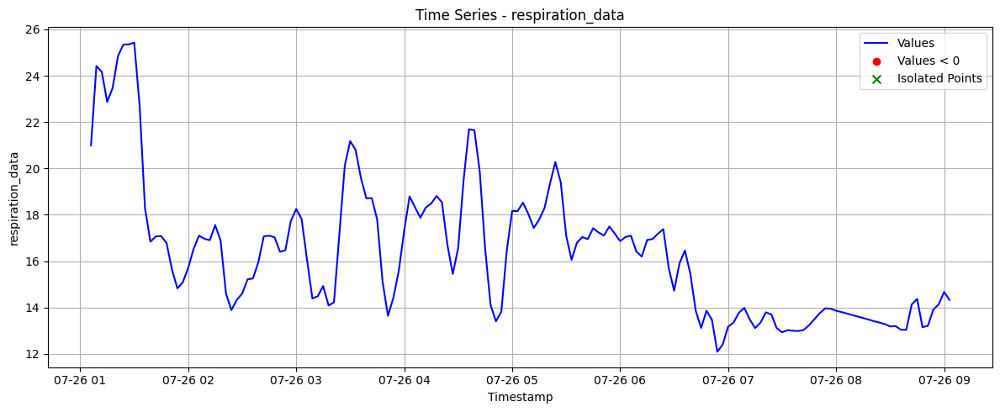

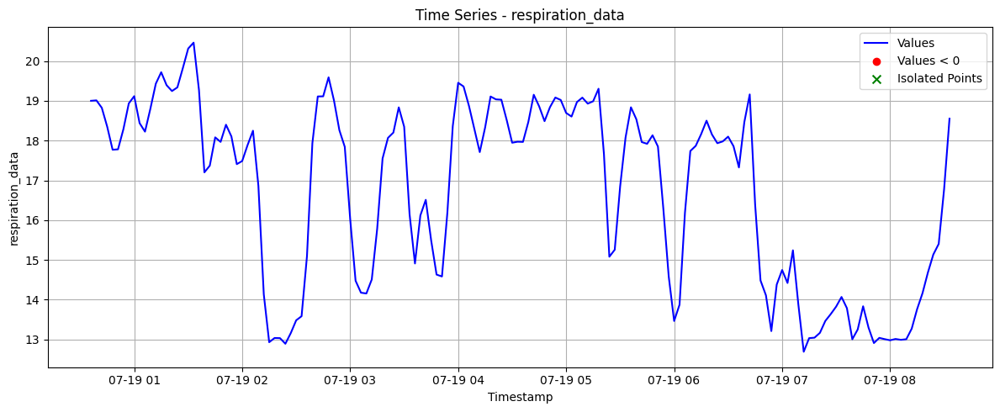

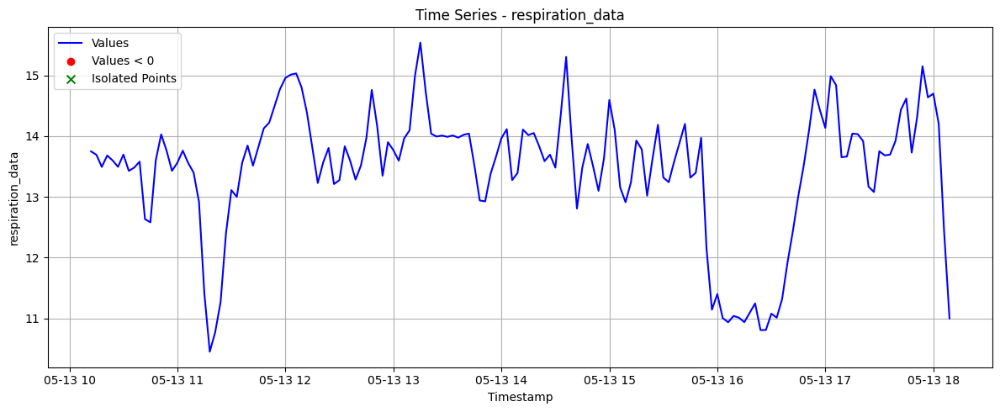

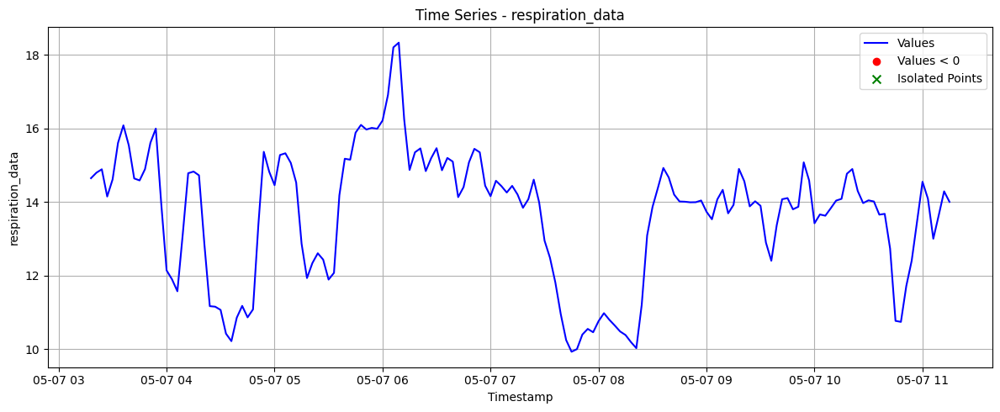

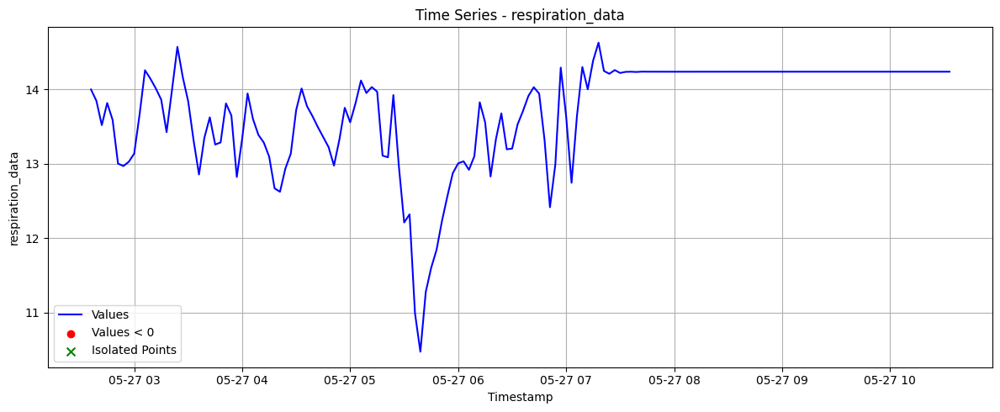

...

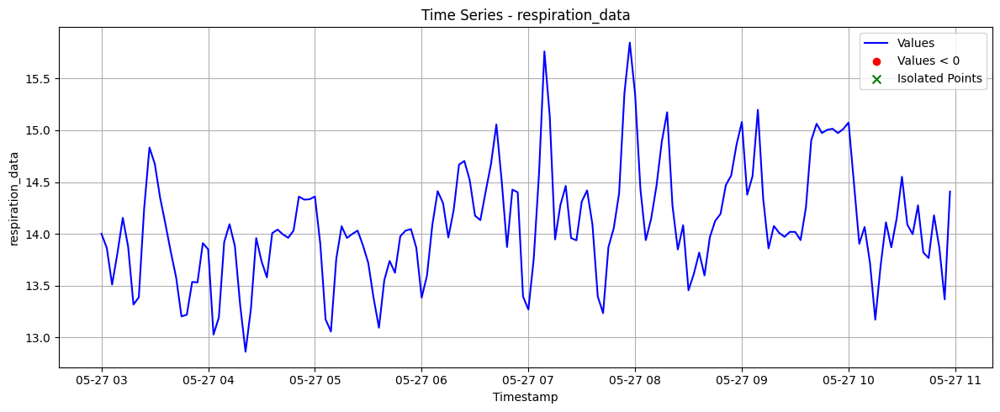

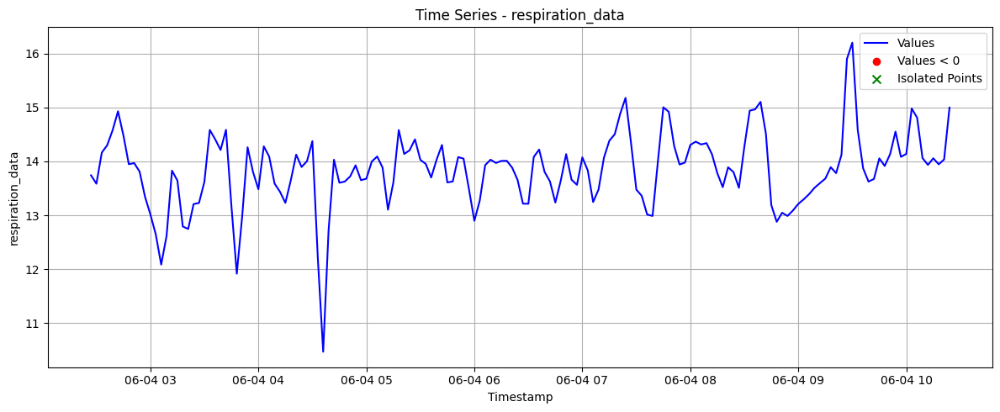

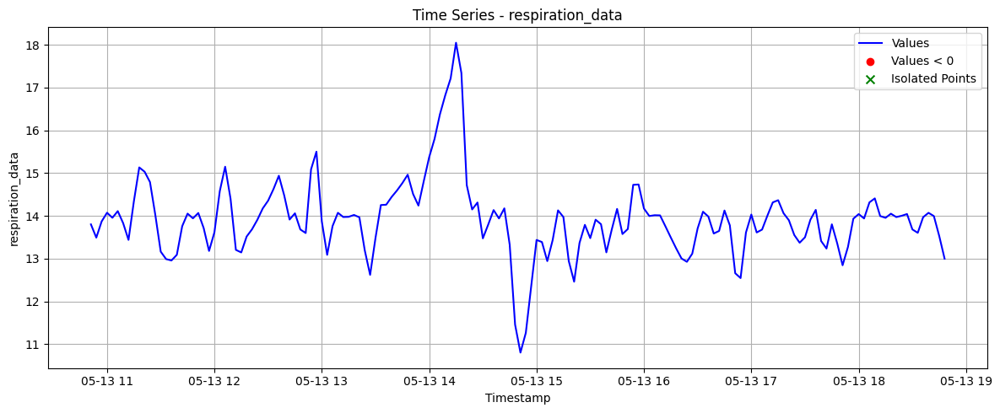

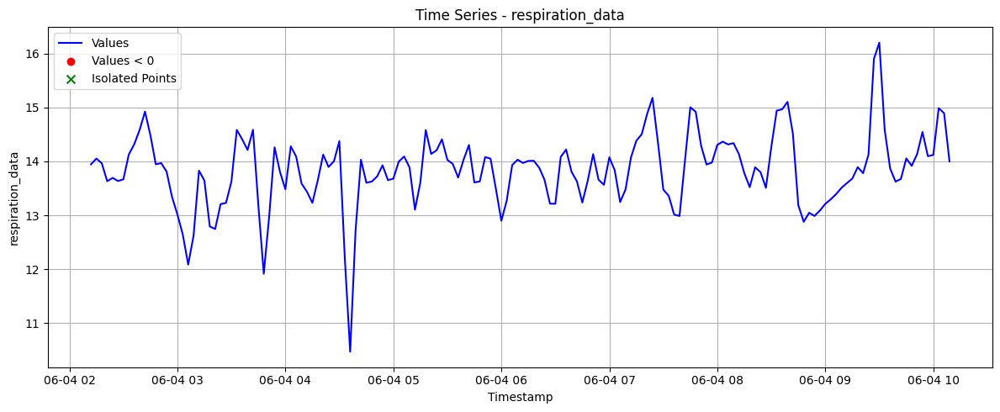

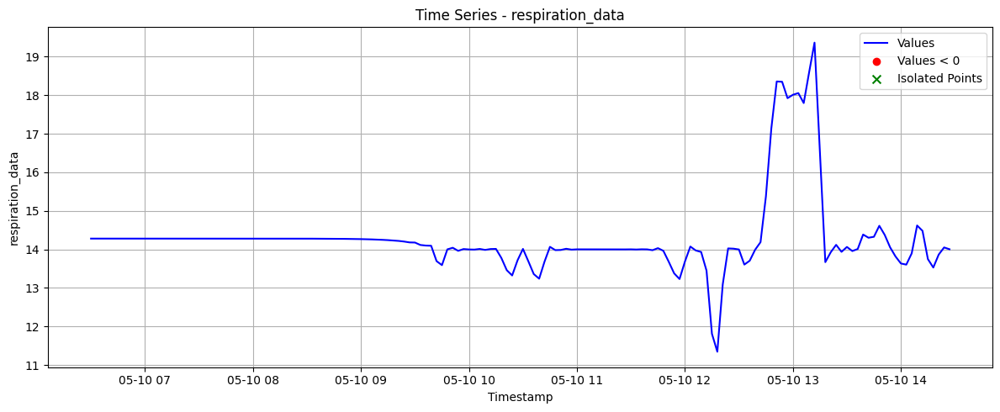






















-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
stress_data:


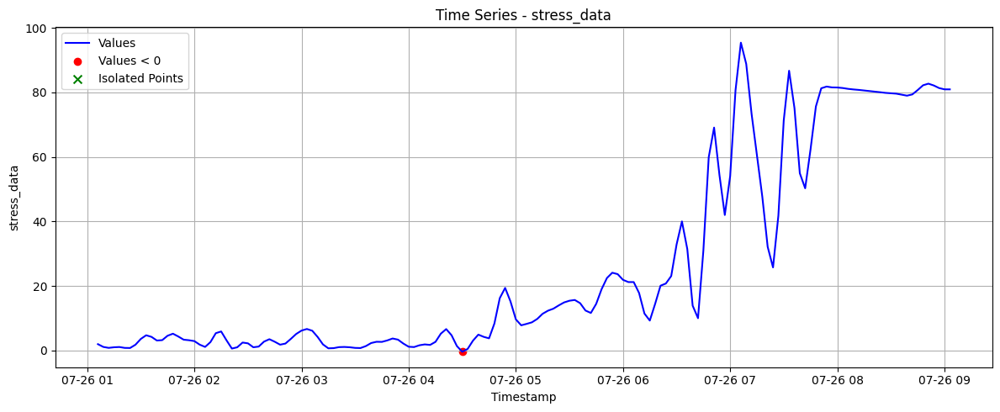

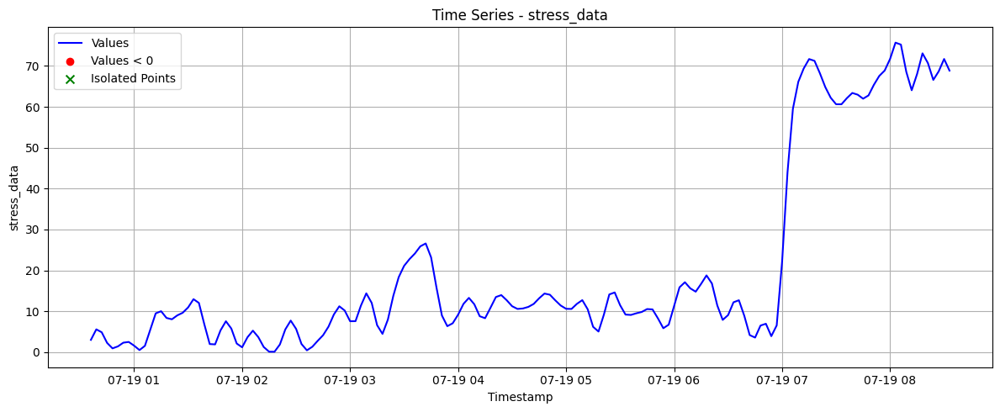

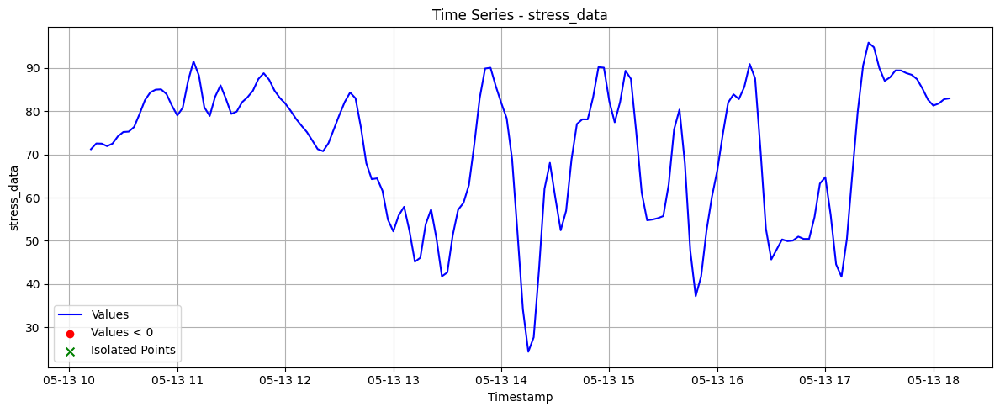

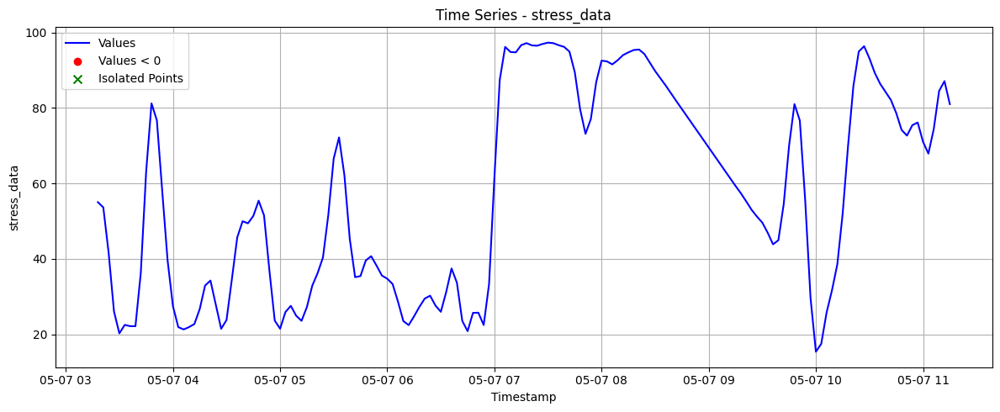

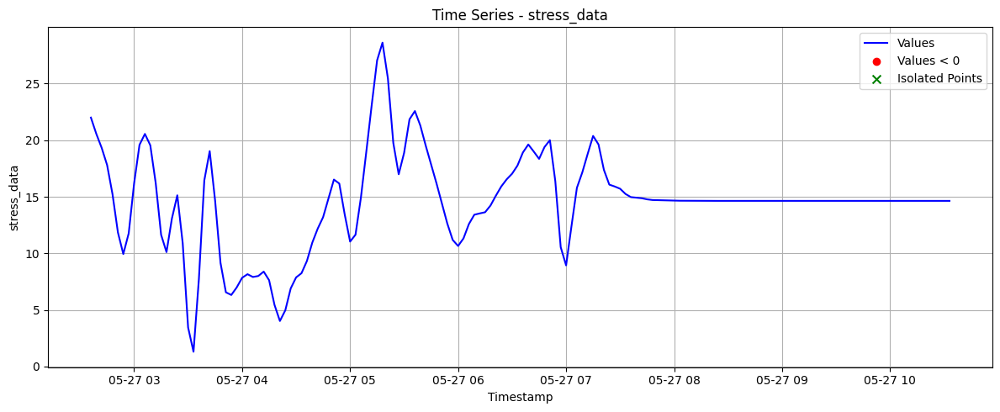

...

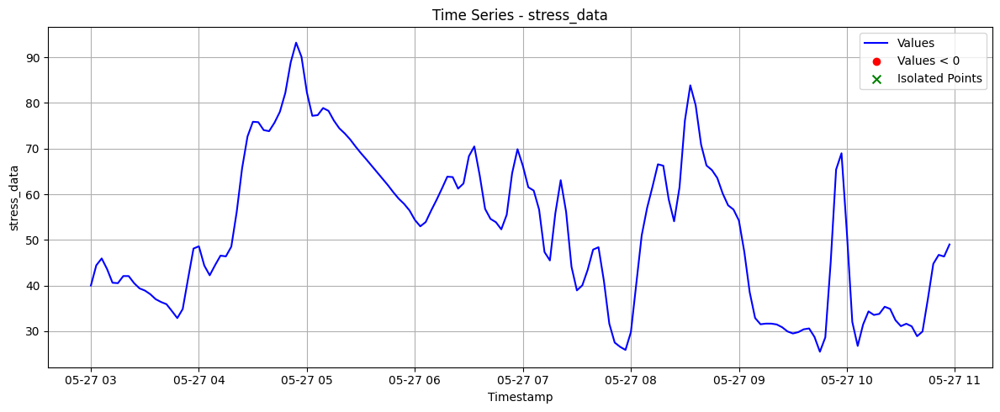

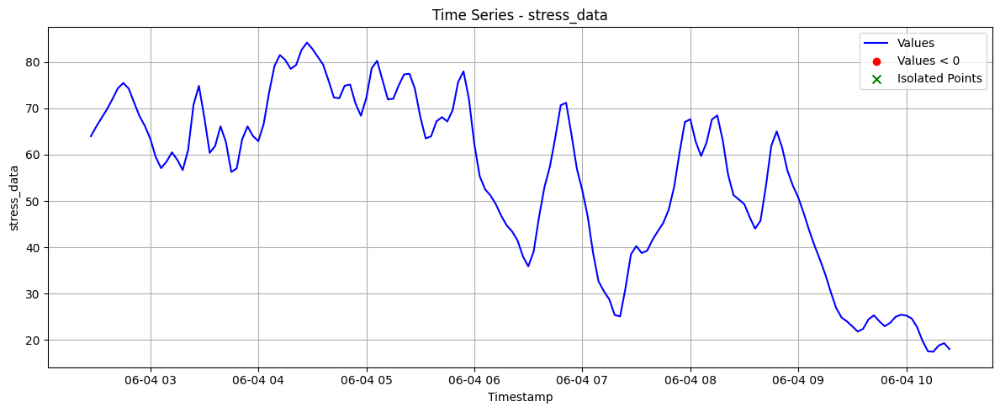

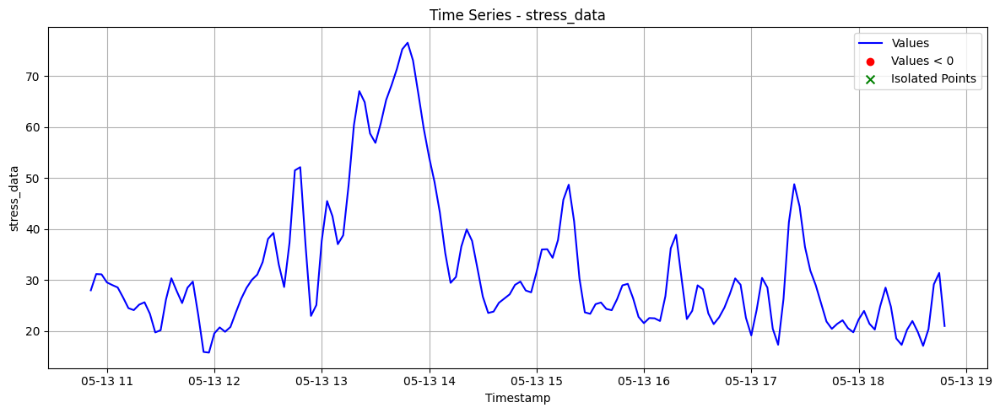

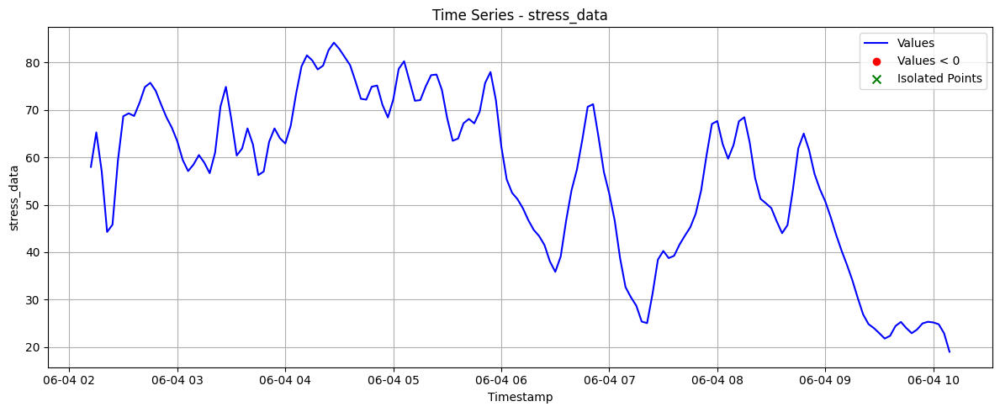

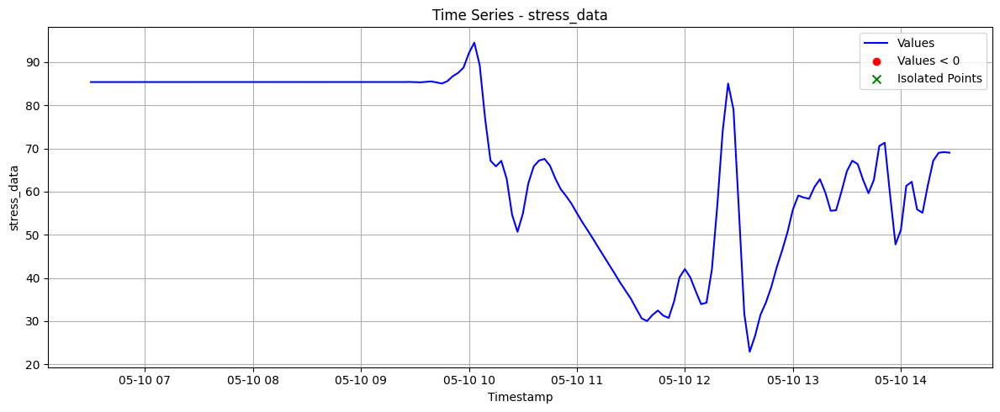






















-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


In [ ]:
for j in range(3):
  print(f'{columns_name[j]}:')

  for i in range(len(rescaled_series)):
    plot_time_series_with_negatives(rescaled_series[i][j])

  print('\n'*20)
  print('-'*175)


#Model

In [ ]:
df_CP_5=pd.read_excel('/content/drive/MyDrive/LL2/Working_Area/df_CP_5_listlike.xlsx')  #contains ground truths that have a corrispondig time-series file, with most timestamps not NaN in previous 8h

##Test

In [ ]:


df = df_CP_5.copy()

# Funzione per convertire la stringa in lista
def parse_series(s):
    return np.array(ast.literal_eval(s), dtype=np.float32)

# Applichiamo la funzione su tutte e tre le colonne
features = ['heart_rate_data', 'respiration_data', 'stress_data']
for col in features:
    df[col] = df[col].apply(parse_series)

# Ora creiamo un array numpy shape (num_samples, 160, 3)
X = np.stack(df[features].apply(lambda row: np.stack(row, axis=-1), axis=1).values)

# Target
y = df['Target_Unbiased'].astype(np.float32).values

print("Shape of X:", X.shape)
print("Shape of y:", y.shape)

Shape of X: (34, 160, 3)
Shape of y: (34,)


In [ ]:
df = df_CP_5.copy()

# Funzione per convertire la stringa in lista con gestione degli errori,
# che ora accetta anche l'indice e il nome della colonna per la stampa di debug
def parse_series(s, index, col_name):
    if isinstance(s, str):
        try:
            return np.array(ast.literal_eval(s), dtype=np.float32)
        except (ValueError, SyntaxError) as e:
            # Stampa l'indice e il nome della colonna dove si è verificato l'errore
            print(f"Errore di parsing in Colonna '{col_name}', Indice {index}:")
            print(f"  Valore problematico: '{s}'")
            print(f"  Errore: {e}\n")
            return np.array([], dtype=np.float32) # Ritorna un array vuoto in caso di errore
    elif pd.isna(s):
        # Stampa l'indice e il nome della colonna per valori NaN
        print(f"Valore NaN in Colonna '{col_name}', Indice {index}.\n")
        return np.array([], dtype=np.float32) # Ritorna un array vuoto per NaN
    else:
        # Stampa l'indice e il nome della colonna per altri tipi non gestiti
        print(f"Tipo non gestito ({type(s)}) in Colonna '{col_name}', Indice {index}:")
        print(f"  Valore problematico: {s}\n")
        try:
            # Tentativo di gestire numeri singoli
            return np.array([float(s)], dtype=np.float32)
        except (ValueError, TypeError) as e:
             print(f"Could not convert non-string/non-NaN value to float in Colonna '{col_name}', Indice {index}: {s} - Error: {e}\n")
             return np.array([], dtype=np.float32)


# Applichiamo la funzione su tutte e tre le colonne, iterando per riga
features = ['heart_rate_data', 'respiration_data', 'stress_data']

# Creiamo nuove colonne temporanee per i risultati del parsing
for col in features:
    df[f'{col}_parsed'] = None # Crea una colonna temporanea per i risultati

# Iteriamo per riga per poter passare l'indice a parse_series
print("Inizio il parsing delle colonne...")
for index, row in df.iterrows():
    for col in features:
        # Applica parse_series passando il valore, l'indice e il nome della colonna
        df.at[index, f'{col}_parsed'] = parse_series(row[col], index, col)

print("Parsing completato.")

# Sostituiamo le colonne originali con quelle parsate
for col in features:
    df[col] = df[f'{col}_parsed']
    df = df.drop(columns=[f'{col}_parsed']) # Rimuovi la colonna temporanea


# Ora creiamo un array numpy shape (num_samples, 160, 3)
# Nota: Questa parte assume che tutti gli array parsati abbiano la stessa lunghezza (es. 160).
# Se parse_series ritorna array vuoti o di lunghezze diverse, np.stack fallirà.
# Potrebbe essere necessario un padding o una gestione specifica per lunghezze variabili.
try:
    # Assicurati che tutte le serie parsate siano non vuote e abbiano la lunghezza attesa
    # Questo è un controllo aggiuntivo prima dello stack
    valid_series = []
    for index, row in df.iterrows():
        row_series = [row[col] for col in features]
        # Controlla che tutte le serie nella riga siano array numpy e non vuoti
        if all(isinstance(s, np.ndarray) and s.size > 0 for s in row_series):
            # Controlla anche se hanno la lunghezza attesa (es. 160)
            # if all(len(s) == 160 for s in row_series): # Aggiungi questo controllo se sai la lunghezza attesa
            valid_series.append(np.stack(row_series, axis=-1)) # Stack lungo l'ultimo asse (per ottenere shape (lunghezza_serie, 3))
        else:
            print(f"Skipping row {index} due to missing or empty parsed series.")


    if valid_series:
        X = np.stack(valid_series, axis=0) # Stack lungo il nuovo asse (per ottenere shape (num_samples_validi, lunghezza_serie, 3))
        # X = np.stack(df[features].apply(lambda row: np.stack(row), axis=1).values) # Vecchio stack (se tutti i dati sono puliti e della stessa lunghezza)

        # Target (solo per le righe valide)
        # Dobbiamo selezionare i target solo per gli indici delle righe valide
        valid_indices = [row_idx for row_idx, row in df.iterrows() if all(isinstance(s, np.ndarray) and s.size > 0 for s in [row[col] for col in features])]
        y = df.loc[valid_indices, 'Target_Unbiased'].astype(np.float32).values


        print("\nSuccessfully processed data:")
        print("Shape of X:", X.shape)
        print("Shape of y:", y.shape)
        print(f"Number of rows processed: {len(valid_series)}")
        print(f"Number of rows skipped: {len(df) - len(valid_series)}")

    else:
        print("\nNo valid series found after parsing. X and y were not created.")
        X = np.array([]) # Assegna array vuoto se non ci sono dati validi
        y = np.array([]) # Assegna array vuoto se non ci sono dati validi


except ValueError as e:
    print("\nError stacking arrays. This might be because some series have different lengths after parsing.")
    print("Original Error:", e)
    print("Check the output of parse_series for potential issues.")
    # Puoi ispezionare le lunghezze delle serie processate così:
    for col in features:
         print(f"Lunghezze parsate in {col}: {[len(arr) if isinstance(arr, np.ndarray) else 'Not Array' for arr in df[col].values[:10]]}...") # Stampa le lunghezze dei primi 10 (o meno) elementi

Inizio il parsing delle colonne...
Parsing completato.

Successfully processed data:
Shape of X: (34, 160, 3)
Shape of y: (34,)
Number of rows processed: 34
Number of rows skipped: 0


## Actual

In [ ]:
def load_and_prepare_data(df_CP_5):
    df = df_CP_5.copy()

    # Funzione per convertire la stringa in lista
    def parse_series(s):
        return np.array(ast.literal_eval(s), dtype=np.float32)

    # Applichiamo la funzione su tutte e tre le colonne
    features = ['heart_rate_data', 'respiration_data', 'stress_data']

    for col in features:
        df[col] = df[col].apply(parse_series)

    # Ora creiamo un array numpy shape (num_samples, 160, 3)
    X = np.stack(df[features].apply(lambda row: np.stack(row, axis=-1), axis=1).values)

    # Target
    y = df['Target_Unbiased'].astype(np.float32).values
    return X, y


# Set random seed for reproducibility
torch.manual_seed(42)
np.random.seed(42)

"""
Data structure specifics:
- We have 34 sets of multivariate time series (3 dimensions)
- Each time series is 160 samples long
- Each set of 3 time series is associated with 1 ground truth value
- Input shape: X will be (34, 160, 3)
- Output shape: y will be (34,)
"""


# ------------------ PART 1: Custom Dataset Class ------------------

class MultivariateTimeSeriesDataset(Dataset):
    """
    Custom Dataset class for handling multivariate time series data.

    Args:
        X (numpy.ndarray): Input features with shape (num_samples, sequence_length, num_features)
                          In our case (num_series, 160, 3)
        y (numpy.ndarray): Target values with shape (num_samples,)
                          In our case (num_series,)
    """

    def __init__(self, X, y):
        # Convert numpy arrays to PyTorch tensors with float32 dtype
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.float32)

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]


# ------------------ PART 2: LSTM Model Architecture ------------------

class LSTMRegressor(nn.Module):
    """
    LSTM model for regression on multivariate time series data.

    Args:
        input_size (int): Number of input features (3 in your case)
        hidden_size (int): Number of features in the hidden state of LSTM
        num_layers (int): Number of recurrent layers (stacked LSTM layers)
        dropout (float): Dropout probability for regularization
    """

    def __init__(self, input_size, hidden_size, num_layers, dropout=0.2):
        super(LSTMRegressor, self).__init__()

        # LSTM layer
        self.lstm = nn.LSTM(
            input_size=input_size,
            hidden_size=hidden_size,
            num_layers=num_layers,
            batch_first=True,  # (batch_size, seq_len, input_size)
            dropout=dropout if num_layers > 1 else 0  # Dropout between stacked LSTM layers
        )

        # Fully connected output layer
        self.fc = nn.Linear(hidden_size, 1)

        # Dropout for regularization
        self.dropout = nn.Dropout(dropout)

    def forward(self, x):
        """
        Forward pass through the network.

        Args:
            x (torch.Tensor): Input tensor of shape (batch_size, seq_len, input_size)
                             In our case (batch_size, 160, 3)

        Returns:
            torch.Tensor: Model output of shape (batch_size, 1)
        """
        # Get batch size for reshaping hidden and cell states if needed
        batch_size = x.size(0)

        # LSTM output
        # output shape: (batch_size, seq_len, hidden_size)
        # hidden shape: (num_layers, batch_size, hidden_size)
        # cell shape: (num_layers, batch_size, hidden_size)
        output, (hidden, cell) = self.lstm(x)

        # There are two approaches we can take here:

        # Approach 1: Use the hidden state from the last layer
        # We take the hidden state from the last layer which contains
        # information from the entire sequence
        last_hidden = hidden[-1, :, :]  # Shape: (batch_size, hidden_size)

        # Apply dropout for regularization
        last_hidden = self.dropout(last_hidden)

        # Apply the fully connected layer to get the prediction
        out = self.fc(last_hidden)  # Shape: (batch_size, 1)

        return out.squeeze(1)  # Remove the extra dimension to get shape (batch_size,)


# ------------------ PART 3: Data Preprocessing Function ------------------

def preprocess_data(X, y, test_size=0.2):
    """
    Preprocess the multivariate time series data, by standardizing the features and splitting into train/test sets.

    Args:
        X (numpy.ndarray): Input features of shape (num_series, sequence_length, num_features)
                          In our case (34, 160, 3)
        y (numpy.ndarray): Target values of shape (num_series,)
                          In our case (34,)
        test_size (float): Proportion of data to use for testing

    Returns:
        tuple: Preprocessed data as (X_train, X_test, y_train, y_test) ready for the model
    """
    # Note: In this case, we don't need to create sequences as each sample is already a full sequence

    # Standardize features - we need to reshape to 2D for StandardScaler, with first dimension as samples and second as features
    num_series, seq_length, num_features = X.shape
    X_reshaped = X.reshape(-1, num_features)  # Reshape to (num_series * seq_length, num_features), -1 means infer the size

    scaler_X = StandardScaler()
    X_scaled_reshaped = scaler_X.fit_transform(X_reshaped)

    # Reshape back to original shape
    X_scaled = X_scaled_reshaped.reshape(num_series, seq_length, num_features)

    # Standardize target
    scaler_y = StandardScaler()
    y_scaled = scaler_y.fit_transform(y.reshape(-1, 1)).flatten() # Reshape to 2D for StandardScaler, as a matrix with a shape of (num_series,1) and flatten back to 1D

    # Split data into train and test sets
    X_train, X_test, y_train, y_test = train_test_split(
        X_scaled, y_scaled, test_size=test_size, random_state=42
    )



    return X_train, X_test, y_train, y_test, scaler_X, scaler_y


# ------------------ PART 4: Training Function ------------------

def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=100, patience=10):
    """
    Train the LSTM model.

    Args:
        model (nn.Module): LSTM model
        train_loader (DataLoader): DataLoader for training data
        val_loader (DataLoader): DataLoader for validation data
        criterion: Loss function
        optimizer: Optimizer
        num_epochs (int): Maximum number of training epochs
        patience (int): Number of epochs to wait for validation loss improvement before early stopping

    Returns:
        tuple: Trained model and training history
    """
    # Check if GPU is available
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")

    # Move model to device
    model = model.to(device)

    # Lists to store losses
    train_losses = []
    val_losses = []

    # Variables for early stopping
    best_val_loss = float('inf')
    counter = 0     #used to count the number of epochs without improvement, if the counter exceeds patience, training stops

    for epoch in range(num_epochs):
        #iterate for num_epochs times, each time training the model on the training set and validating it on the validation set
        #if the validation loss does not improve for patience epochs, training stops early

        # Training phase
        model.train()   #set the model to training mode setting layers that behave differently during training and evaluation (e.g., dropout, batch normalization) to training mode
        train_loss = 0.0

        for inputs, targets in train_loader:
            # Move data to device
            inputs, targets = inputs.to(device), targets.to(device) #set the inputs and targets to the same device as the model, save a copy of the data on the GPU if available

            # Zero the parameter gradients
            optimizer.zero_grad()

            # Forward pass
            outputs = model(inputs)

            # Calculate loss
            loss = criterion(outputs, targets)

            # Backward pass and optimize
            loss.backward()
            optimizer.step()

            # Accumulate batch loss
            train_loss += loss.item() * inputs.size(0)  #inputs.size(0) is the batch size so that the train loss is weighted by the number of samples in the batch

        # Calculate average training loss for the epoch
        train_loss = train_loss / len(train_loader.dataset)
        train_losses.append(train_loss)

        # Validation phase
        model.eval()
        val_loss = 0.0

        with torch.no_grad():  # No need to track gradients for validation
            for inputs, targets in val_loader:
                # Move data to device
                inputs, targets = inputs.to(device), targets.to(device)

                # Forward pass
                outputs = model(inputs)

                # Calculate loss
                loss = criterion(outputs, targets)

                # Accumulate batch loss
                val_loss += loss.item() * inputs.size(0)

        # Calculate average validation loss for the epoch
        val_loss = val_loss / len(val_loader.dataset)
        val_losses.append(val_loss)

        # Print progress
        print(f"Epoch {epoch + 1}/{num_epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}")

        # Early stopping check
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            counter = 0
            # Save the best model
            torch.save(model.state_dict(), 'best_lstm_model.pth')
        else:
            counter += 1
            if counter >= patience:
                print(f"Early stopping triggered after {epoch + 1} epochs")
                break

    # Load the best model
    model.load_state_dict(torch.load('best_lstm_model.pth'))

    return model, {"train_losses": train_losses, "val_losses": val_losses}


# ------------------ PART 5: Evaluation Function ------------------

def evaluate_model(model, test_loader, scaler_y):
    """
    Evaluate the trained model on the test data.

    Args:
        model (nn.Module): Trained LSTM model
        test_loader (DataLoader): DataLoader for test data
        scaler_y: StandardScaler used for scaling the target values

    Returns:
        tuple: Metrics and predictions
    """
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = model.to(device)
    model.eval()

    predictions = []
    actuals = []

    with torch.no_grad():
        for inputs, targets in test_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            outputs = model(inputs)

            # Store predictions and actual values
            predictions.extend(outputs.cpu().numpy())
            actuals.extend(targets.cpu().numpy())

    # Convert to numpy arrays
    predictions = np.array(predictions)
    actuals = np.array(actuals)

    # Inverse transform predictions and actual values
    predictions = scaler_y.inverse_transform(predictions.reshape(-1, 1)).flatten()
    actuals = scaler_y.inverse_transform(actuals.reshape(-1, 1)).flatten()
    benchmark = np.zeros_like(predictions)

    # Calculate metrics
    test_mse = np.mean((predictions - actuals) ** 2)
    test_rmse = np.sqrt(test_mse)
    test_mae = np.mean(np.abs(predictions - actuals))

    # Calculate benchmark metrics
    benchmark_mse = np.mean((benchmark - actuals) ** 2)
    benchmark_rmse = np.sqrt(benchmark_mse)
    benchmark_mae = np.mean(np.abs(benchmark - actuals))

    print("== Metriche modello ==")
    print(f"Test MSE: {test_mse:.4f}")
    print(f"Test RMSE: {test_rmse:.4f}")
    print(f"Test MAE: {test_mae:.4f}")

    print("\n\n== Benchmark (predice 0) ==")
    print(f"Benchmark MSE: {benchmark_mse:.4f}")
    print(f"Benchmark RMSE: {benchmark_rmse:.4f}")
    print(f"Benchmark MAE: {benchmark_mae:.4f}")

    return {
        "test_mse": test_mse,
        "test_rmse": test_rmse,
        "test_mae": test_mae,
        "benchmark_mse": benchmark_mse,
        "benchmark_rmse": benchmark_rmse,
        "benchmark_mae": benchmark_mae,
        "predictions": predictions,
        "actuals": actuals
    }


# ------------------ PART 6: Visualization Function ------------------

def plot_results(history, evaluation_results):
    """
    Plot training/validation loss and predictions vs actual values.

    Args:
        history (dict): Training history containing losses
        evaluation_results (dict): Evaluation metrics and predictions
    """
    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 10))

    # Plot training and validation loss
    ax1.plot(history["train_losses"], label="Training Loss")
    ax1.plot(history["val_losses"], label="Validation Loss")
    ax1.set_xlabel("Epoch")
    ax1.set_ylabel("Loss")
    ax1.set_title("Training and Validation Loss")
    ax1.legend()

    # Plot predictions vs actual values
    predictions = evaluation_results["predictions"]
    actuals = evaluation_results["actuals"]
    benchmark = np.zeros_like(predictions)

    # Scatter actual vs predicted
    ax2.scatter(actuals, predictions, alpha=0.5, label="Predictions")

    # Line of equality
    ax2.plot([min(actuals), max(actuals)], [min(actuals), max(actuals)], 'r--', label="Equality line")

    # Benchmark line: predicted = 0, quindi x=actuals, y=0
    ax2.plot(actuals, benchmark, linestyle="--", color="gray",
             label=f"Benchmark (RMSE: {evaluation_results['benchmark_rmse']:.4f})")

    ax2.set_xlabel("Actual Values")
    ax2.set_ylabel("Predicted Values")
    ax2.set_title(f"Predictions vs Actual Values (Model RMSE: {evaluation_results['test_rmse']:.4f})")

    ax2.legend()

    plt.tight_layout()
    plt.savefig('lstm_results.png')
    plt.show()

Loading data...
Preprocessing data...
Train shapes - X_train: (30, 160, 3), y_train: (30,)
Test shapes - X_test: (4, 160, 3), y_test: (4,)
Initializing model...
Training model...
Using device: cuda
Epoch 1/100, Train Loss: 0.8541, Val Loss: 0.6003
Epoch 2/100, Train Loss: 0.8318, Val Loss: 0.5928
Epoch 3/100, Train Loss: 0.8070, Val Loss: 0.5940
Epoch 4/100, Train Loss: 0.7853, Val Loss: 0.6278
Epoch 5/100, Train Loss: 0.7553, Val Loss: 0.6883
Epoch 6/100, Train Loss: 0.6988, Val Loss: 0.7822
Epoch 7/100, Train Loss: 0.6778, Val Loss: 0.8452
Early stopping triggered after 7 epochs
Training time: 0.22 seconds
Evaluating model...
== Metriche modello ==
Test MSE: 0.0275
Test RMSE: 0.1657
Test MAE: 0.1391


== Benchmark (predice 0) ==
Benchmark MSE: 0.0174
Benchmark RMSE: 0.1318
Benchmark MAE: 0.1133
Visualizing results...


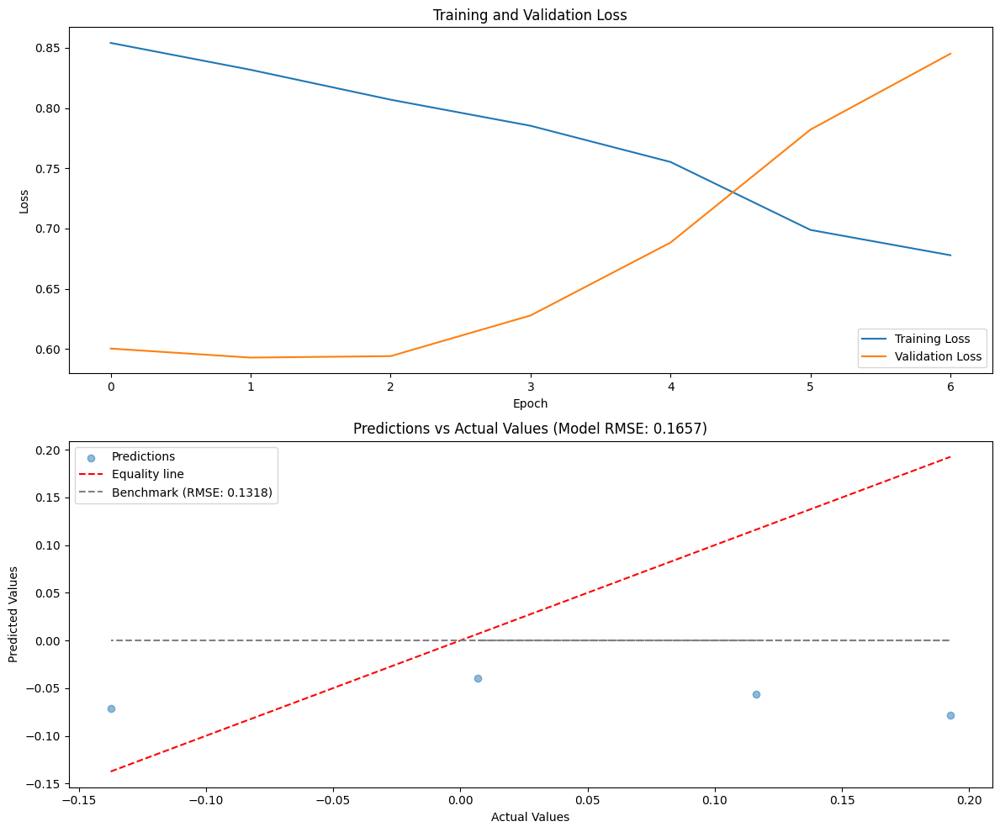

In [ ]:

# ------------------ PART 7: Main Function ------------------


# Hyperparameters
input_size = 3  # Number of features ('heart_rate_data', 'respiration_data', 'stress_data')
hidden_size = 64  # Number of features in each hidden state
num_layers = 1  # Number of recurrent layers
dropout = 0.2  # Dropout probability
learning_rate = 0.001  # Learning rate
num_epochs = 100  # Maximum number of training epochs
batch_size = 4  # Batch size - smaller due to limited number of samples (small reminder Batch is the number of samples processed before the model is updated)



# 1. Load your data
print("Loading data...")
# Leggi il file Excel
ground_truth = df_CP_5
X, y = load_and_prepare_data(ground_truth)

# 2. Preprocess data
print("Preprocessing data...")
X_train, X_test, y_train, y_test, scaler_X, scaler_y = preprocess_data(X, y, test_size=0.1)

print(f"Train shapes - X_train: {X_train.shape}, y_train: {y_train.shape}")
print(f"Test shapes - X_test: {X_test.shape}, y_test: {y_test.shape}")

# 3. Create datasets and dataloaders
# Split the training data further into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42)

train_dataset = MultivariateTimeSeriesDataset(X_train, y_train)
val_dataset = MultivariateTimeSeriesDataset(X_val, y_val)
test_dataset = MultivariateTimeSeriesDataset(X_test, y_test)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size)
test_loader = DataLoader(test_dataset, batch_size=batch_size)

# 4. Initialize the model
print("Initializing model...")
model = LSTMRegressor(input_size, hidden_size, num_layers, dropout)

# 5. Define loss function and optimizer
#criterion = nn.MSELoss()
# Use Mean Absolute Error Loss for regression
criterion = nn.L1Loss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)





# 6. Train the model
print("Training model...")
start = time.perf_counter()
trained_model, history = train_model(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    criterion=criterion,
    optimizer=optimizer,
    num_epochs=num_epochs,
    patience=5
)
end = time.perf_counter()
print(f"Training time: {end - start:.2f} seconds")

# 7. Evaluate the model
print("Evaluating model...")
evaluation_results = evaluate_model(trained_model, test_loader, scaler_y)

# 8. Visualize results
print("Visualizing results...")
plot_results(history, evaluation_results)

